# Use the v4.1 recalibrated SDSS Stripe82 catalog 
# and Gaia EDR3 catalog to produce v4.2 catalog

### 1) use Gaia's BP-RP color to generate Gaia's u-r, g-r, r-i and r-z colors and  compare them to SDSS colors

### 2) derive u-r, g-r, r-i, r-z corrections and store to ZP*dat files

### 3) read ZP*dat files and apply u-r, g-r, r-i, r-z corrections, produce v4.2 version 

In [1]:
%matplotlib inline
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.table import hstack
import matplotlib.pyplot as plt 
import numpy as np
from astroML.plotting import hist
# for astroML installation see https://www.astroml.org/user_guide/installation.html

In [2]:
## automatically reload any modules read below that might have changed (e.g. plots)
%load_ext autoreload
%autoreload 2
# importing ZI tools: 
import ZItools as zit
# importing Karun's tools: 
import KTtools as ktt

<a id='dataTools'></a>

### Helper Tools

In [3]:
# both new and old files use identical data structure
colnamesSDSS = ['calib_fla', 'ra', 'dec', 'raRMS', 'decRMS', 'nEpochs', 'AR_val', 
                'u_Nobs', 'u_mMed', 'u_mMean', 'u_mErr', 'u_rms_scatt', 'u_chi2',
                'g_Nobs', 'g_mMed', 'g_mMean', 'g_mErr', 'g_rms_scatt', 'g_chi2',
                'r_Nobs', 'r_mMed', 'r_mMean', 'r_mErr', 'r_rms_scatt', 'r_chi2',
                'i_Nobs', 'i_mMed', 'i_mMean', 'i_mErr', 'i_rms_scatt', 'i_chi2',
                'z_Nobs', 'z_mMed', 'z_mMean', 'z_mErr', 'z_rms_scatt', 'z_chi2']

### code for generating new quantities, such as dra, ddec, colors, differences in mags, etc
def derivedColumns(matches):
    matches['dra'] = (matches['ra']-matches['raG'])*3600
    matches['ddec'] = (matches['dec']-matches['decG'])*3600
    ra = matches['ra'] 
    matches['raW'] = np.where(ra > 180, ra-360, ra) 
    matches['gr'] = matches['g_mMed_new'] - matches['r_mMed_new']
    matches['ri'] = matches['r_mMed_new'] - matches['i_mMed_new']
    matches['gi'] = matches['g_mMed_new'] - matches['i_mMed_new']
    matches['iz'] = matches['i_mMed_new'] - matches['z_mMed_new']
    matches['ur'] = matches['u_mMed_new'] - matches['r_mMed_new']    
    matches['rz'] = matches['r_mMed_new'] - matches['z_mMed_new']    
    # Gaia 
    matches['draGold'] = -3600*(matches['ra_old'] - matches['raG']) 
    matches['draGnew'] = -3600*(matches['ra_new'] - matches['raG']) 
    matches['ddecGold'] = -3600*(matches['dec_old'] - matches['decG']) 
    matches['ddecGnew'] = -3600*(matches['dec_new'] - matches['decG']) 
    # photometric
    matches['gGr_old'] = matches['r_mMed_old'] - matches['Gmag']
    matches['gGr_new'] = matches['r_mMed_new'] - matches['Gmag']
    return

In [4]:
def doOneColorGaiaBR(d, kw):
    print('=========== WORKING ON:', kw['Ystr'], '===================')
    xVec = d[kw['Xstr']]
    yVec = d[kw['Ystr']]
    # 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 52, 0)
    fig,ax = plt.subplots(1,1,figsize=(8,6))
    ax.scatter(xVec, yVec, s=0.01, c='blue')
    ax.scatter(xBin, medianBin, s=5.2, c='yellow')
    ax.set_xlim(0.4,3.2)
    ax.set_ylim(-0.5,4.5)
    ax.set_xlabel(kw['Xstr'])
    ax.set_ylabel(kw['Ystr'])
    d['colorfit'] = np.interp(xVec, xBin, medianBin)
    d['colorresid'] = d[kw['Ystr']] - d['colorfit'] 
    goodC = d[np.abs(d['colorresid'])<0.3]
    
    ### plots 
    # RA
    print(' stats for RA binning medians:')
    plotNameRoot = kw['plotNameRoot'] + kw['Ystr']
    plotName = plotNameRoot + '_RA.png'
    Ylabel =kw['Ystr'] + ' residuals'
    kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_RA_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)

    # Dec
    print('-----------')
    print(' stats for Dec binning medians:')
    plotName = plotNameRoot + '_Dec.png'
    kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Dec_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)

    # r SDSS
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_rmag.png'    
    kwOC = {"Xstr":'r_mMed_new', "Xmin":14.3, "Xmax":22.2, "Xlabel":'SDSS r (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_rmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    
    # Gaia G
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_Gmag.png'    
    kwOC = {"Xstr":'Gmag', "Xmin":14.3, "Xmax":22.2, "Xlabel":'Gaia G (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Gmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    

<a id='dataReading'></a>

### Define paths and catalogs 

In [5]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
# the original SDSS catalog from 2007
sdssOldCat = ZIdataDir + "/" + "stripe82calibStars_v2.6.dat"
# new catalog from 2020, after Gmag-based gray corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.1_noheader_final.dat"
# Gaia EDR3 with BP and RP data
GaiaEDR3CatBR = ZIdataDir + "/" + "Stripe82_GaiaEDR3_BPRP.dat" 

In [6]:
%%time
# old
sdssOld = Table.read(sdssOldCat, format='ascii', names=colnamesSDSS) 
np.size(sdssOld)

CPU times: user 23.1 s, sys: 3.78 s, total: 26.9 s
Wall time: 26.1 s


1006849

In [26]:
%%time
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

CPU times: user 49.3 s, sys: 10.2 s, total: 59.5 s
Wall time: 59.6 s


991472

In [28]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [30]:
colnamesGaia = ['ra', 'dec', 'nObs', 'Gmag', 'flux', 'fluxErr', 'pmra', 'pmdec']
colnamesGaia = colnamesGaia + ['BPmag', 'BPeI', 'RPmag', 'RPeI', 'BRef']
gaia = Table.read(GaiaEDR3CatBR, format='ascii', names=colnamesGaia)
gaia['raG'] = gaia['ra']
gaia['decG'] = gaia['dec']    
gaia['BR'] = gaia['BPmag'] - gaia['RPmag'] 

In [32]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [34]:
derivedColumns(gaia_sdss)

In [36]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

In [38]:
matchesBlue = matches[(matches['gi']>0.4)&(matches['gi']<2.0)&(matches['Gmag']<20.0)]
print(np.size(matches), np.size(matchesBlue))

905428 397175


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013284063339234597 std.dev: 0.01357354965535871
saved plot as: colorResidGaiaColors_ur_RA.png


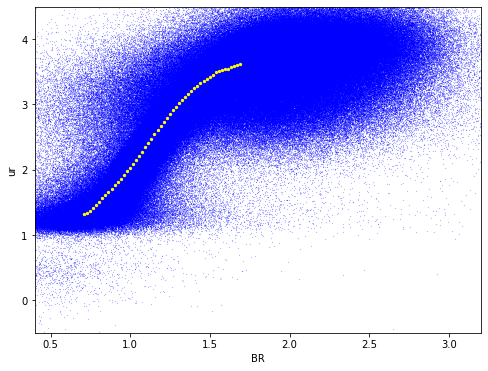

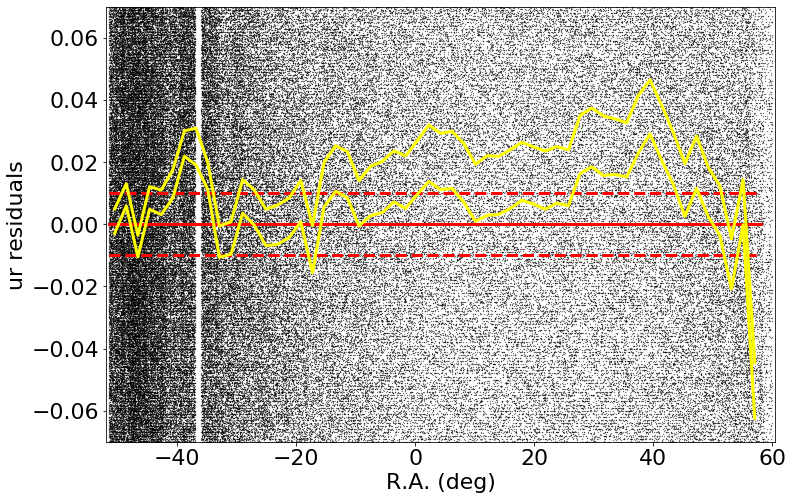

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.01429254608154329 std.dev: 0.013548827801766836
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


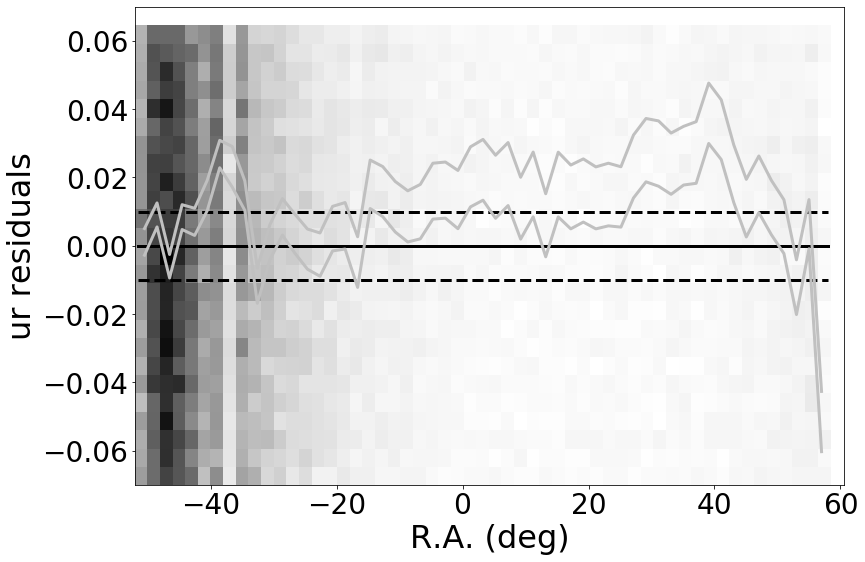

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.010800204467773078 std.dev: 0.01162182366807504
saved plot as: colorResidGaiaColors_ur_Dec.png


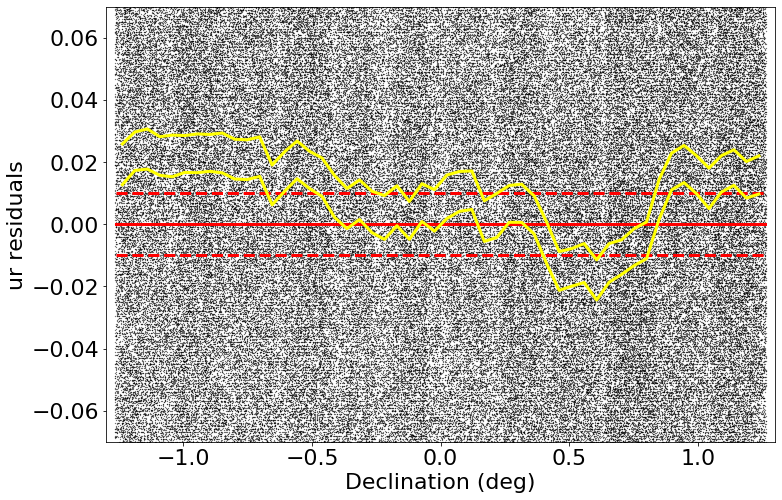

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009848024749757434 std.dev: 0.011915617990370483
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


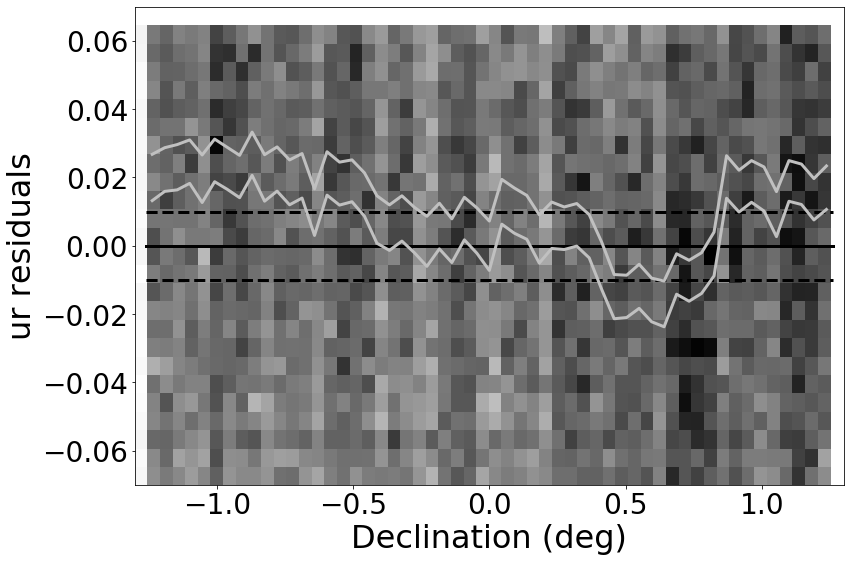

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0032144226074231064 std.dev: 0.053181324984204706
saved plot as: colorResidGaiaColors_ur_rmag.png


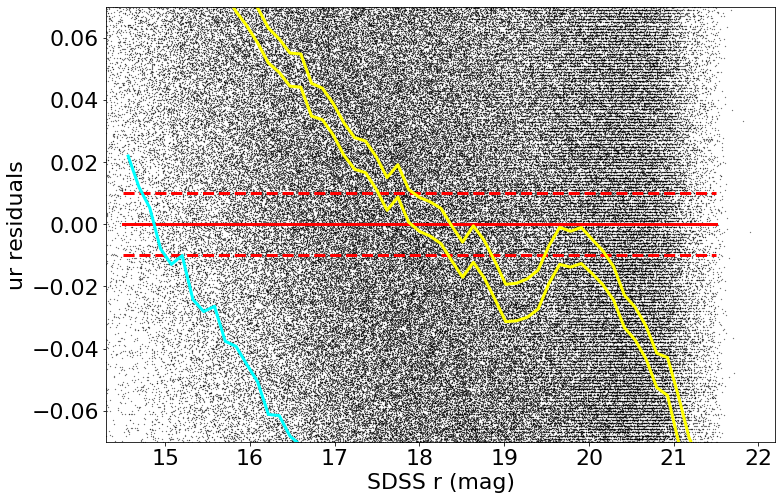

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0032144226074231064 std.dev: 0.053181324984204706
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


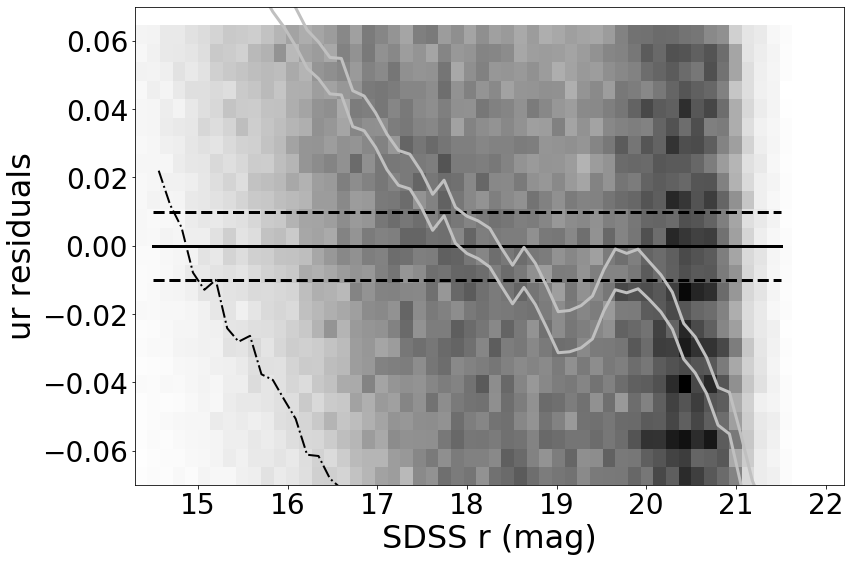

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009690533447263672 std.dev: 0.054437261441730944
saved plot as: colorResidGaiaColors_ur_Gmag.png


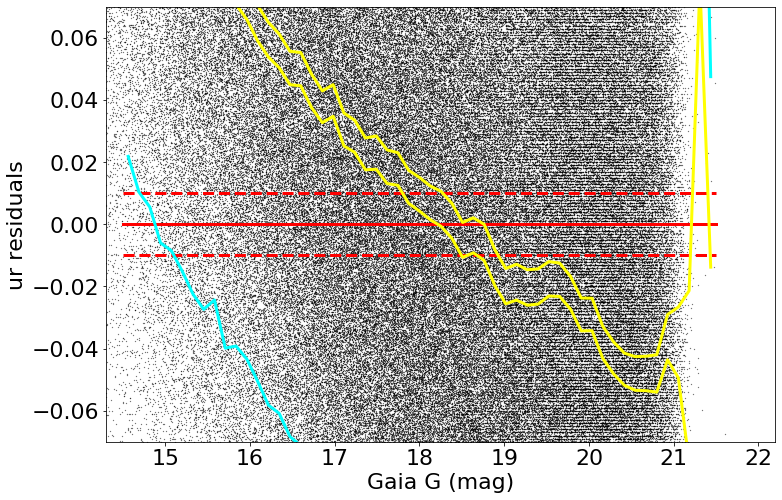

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009690533447263672 std.dev: 0.054437261441730944
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


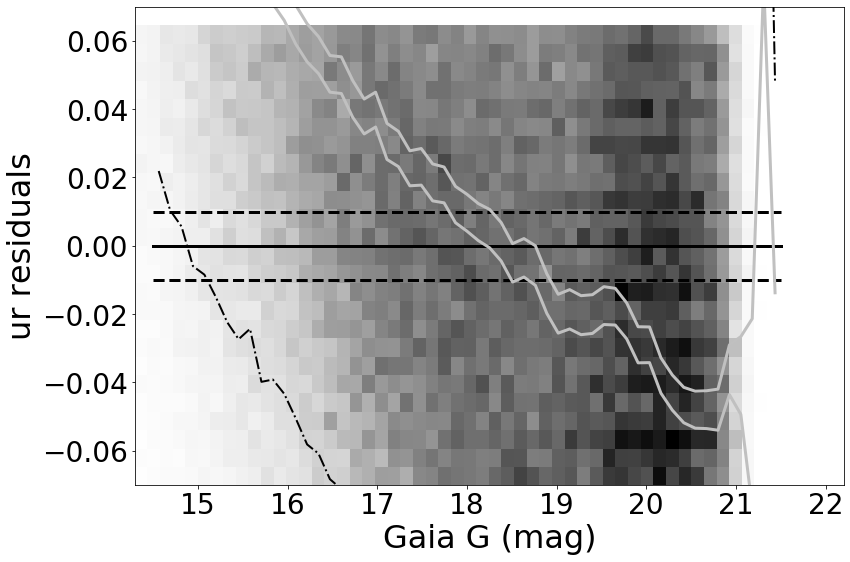

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.02297813262939416 std.dev: 0.009095451923870379
saved plot as: colorResidGaiaColors_gr_RA.png


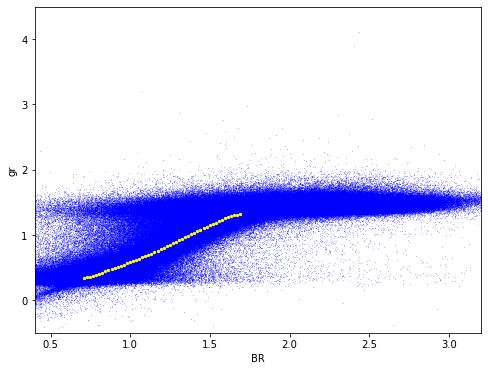

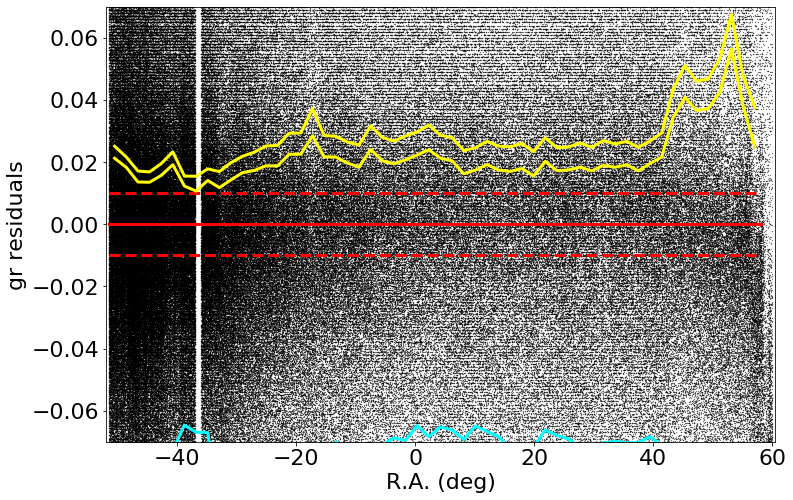

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.022633489990234013 std.dev: 0.009038793748459407
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


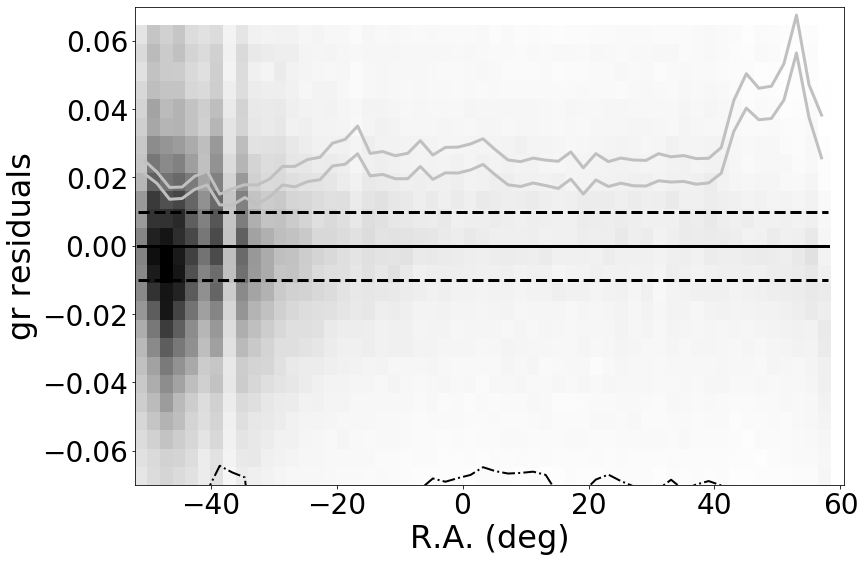

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.02087662200927448 std.dev: 0.003838492832428057
saved plot as: colorResidGaiaColors_gr_Dec.png


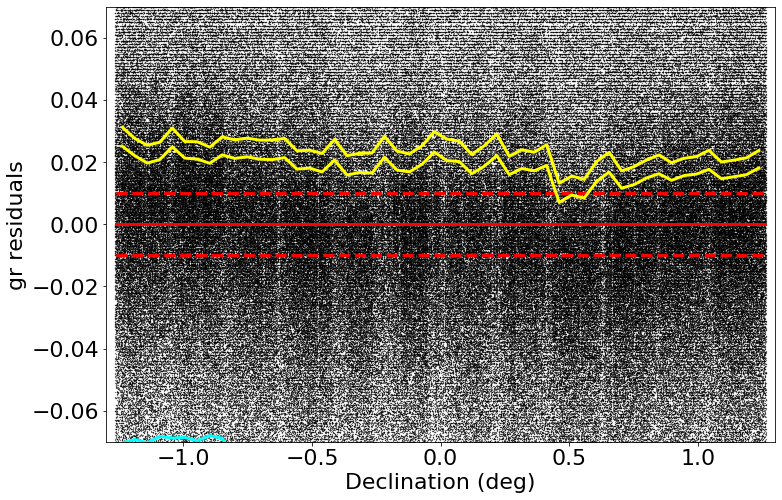

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.020999999999997243 std.dev: 0.0038981250127695633
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


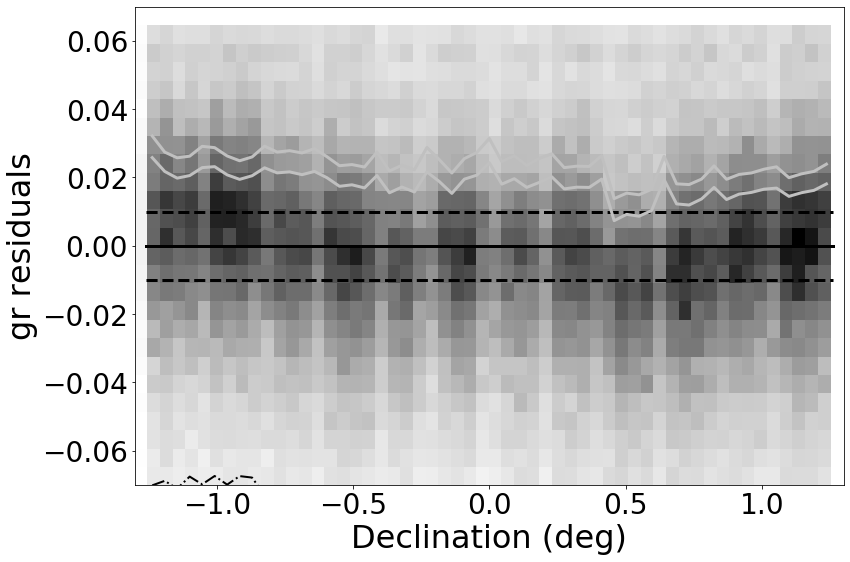

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.0025371398925785327 std.dev: 0.0435879884635516
saved plot as: colorResidGaiaColors_gr_rmag.png


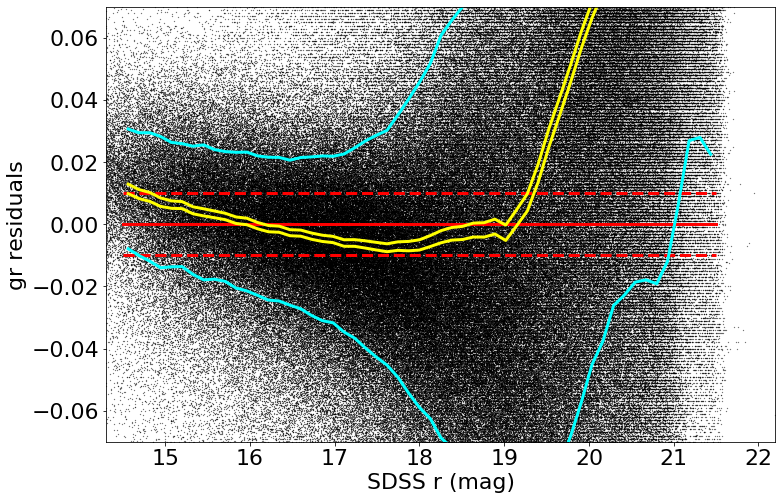

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.0025371398925785327 std.dev: 0.0435879884635516
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


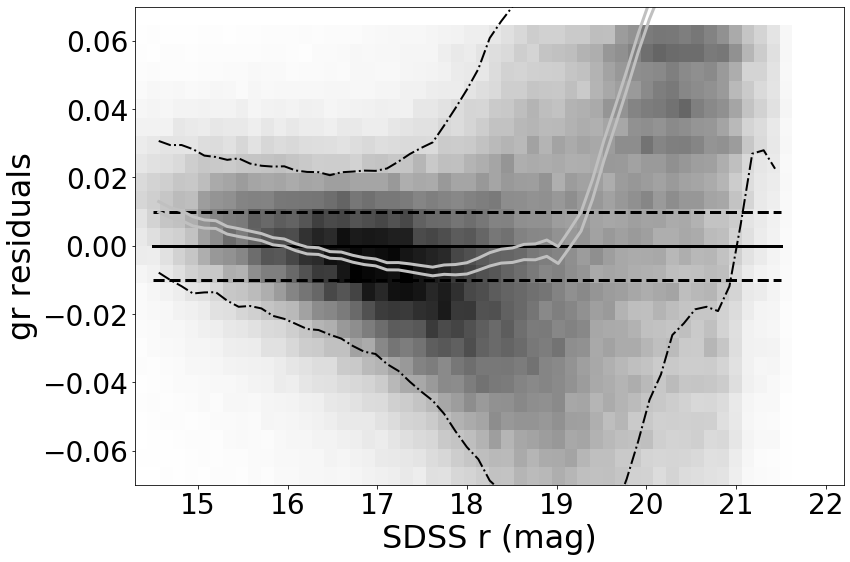

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.005265164184570903 std.dev: 0.03456813377661558
saved plot as: colorResidGaiaColors_gr_Gmag.png


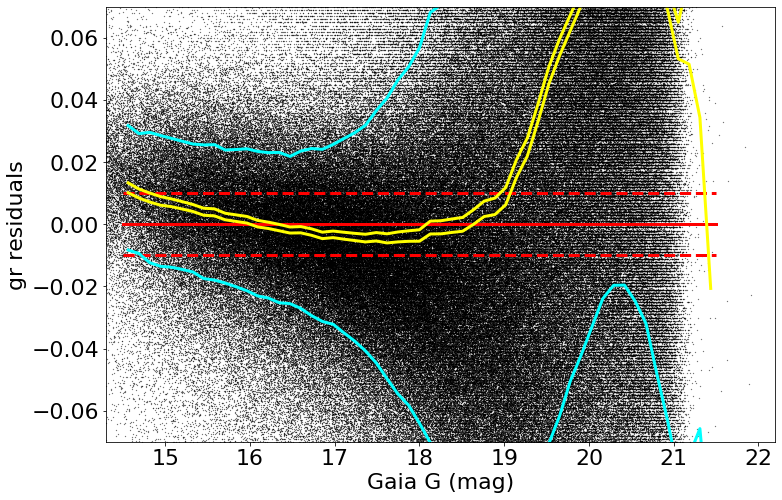

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.005265164184570903 std.dev: 0.03456813377661558
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


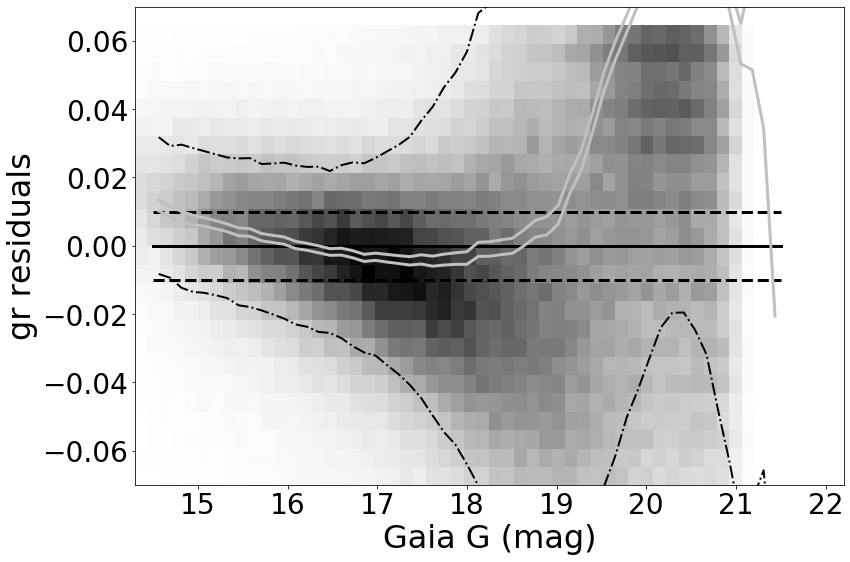

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0018645217895516472 std.dev: 0.00474672820113338
saved plot as: colorResidGaiaColors_ri_RA.png


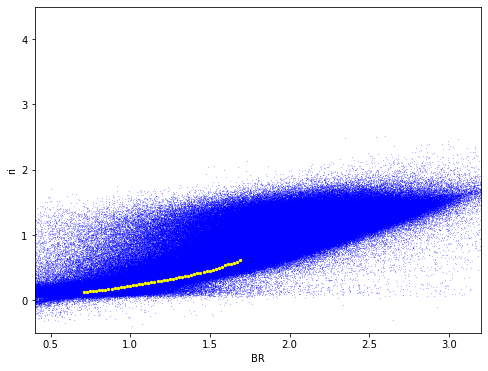

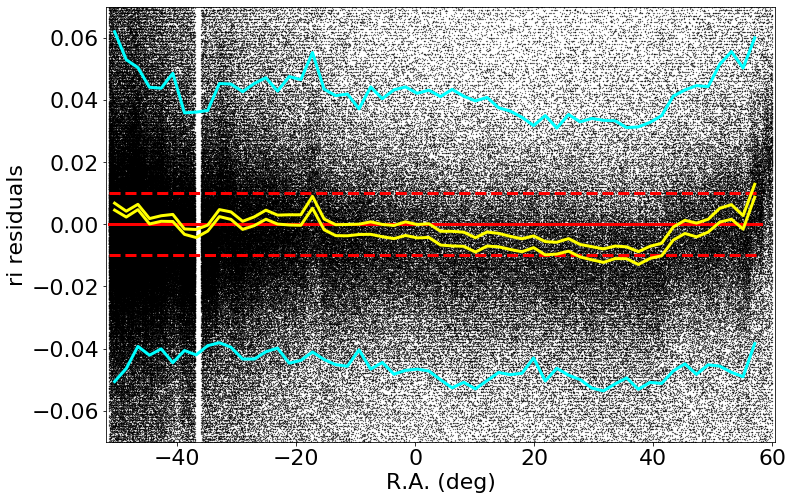

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0019999999999988916 std.dev: 0.004737066184872442
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


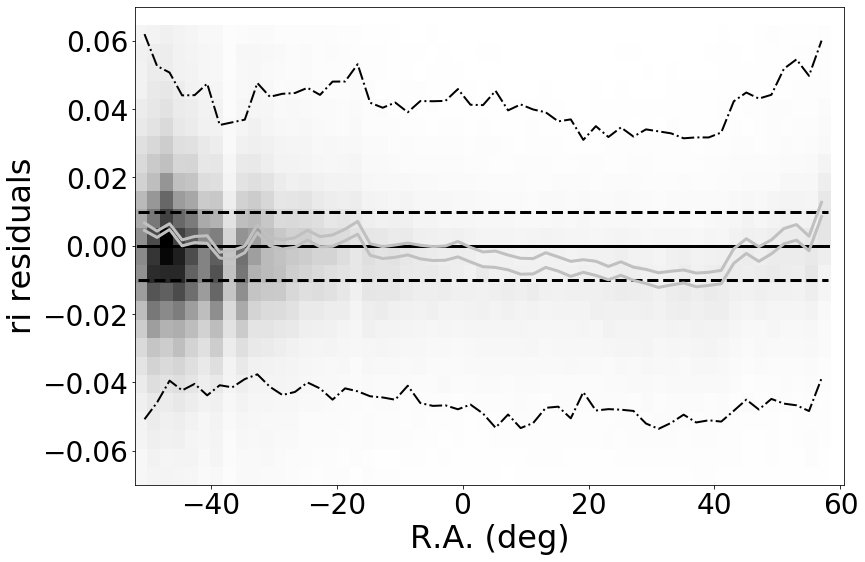

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0015473506927493053 std.dev: 0.003329667885308621
saved plot as: colorResidGaiaColors_ri_Dec.png


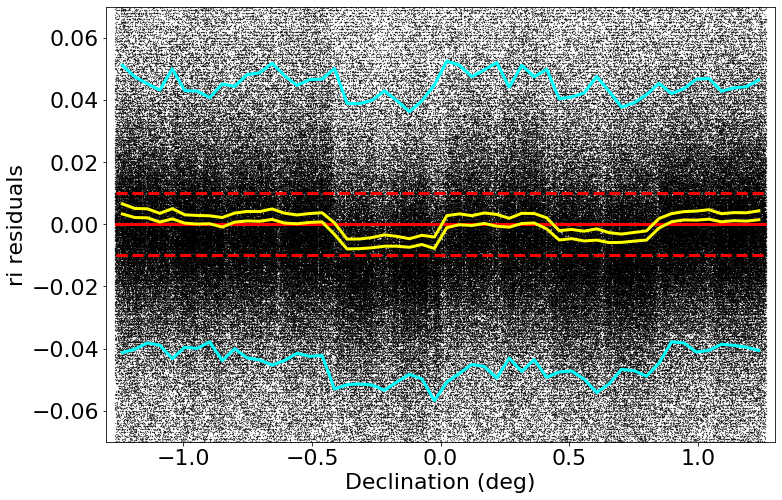

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.001559720611573584 std.dev: 0.003330874508200132
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


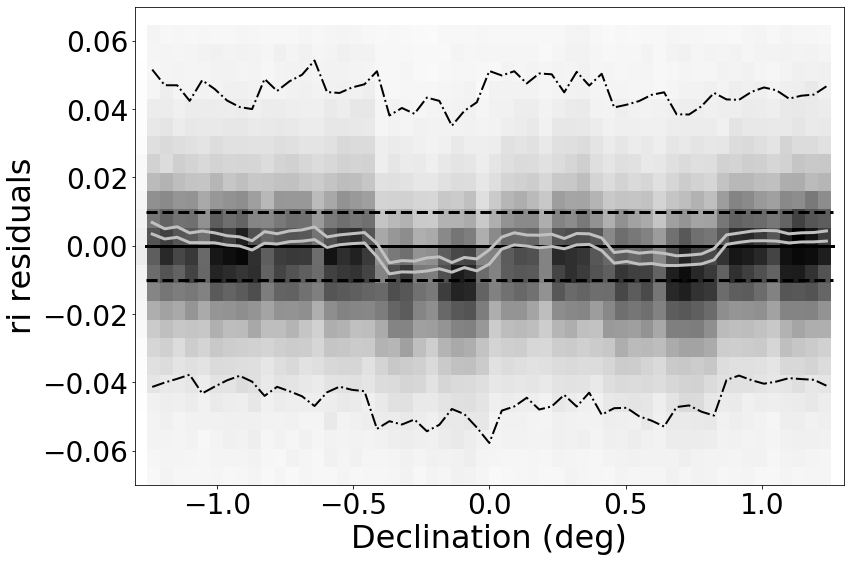

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0036271469116193333 std.dev: 0.04921206381428205
saved plot as: colorResidGaiaColors_ri_rmag.png


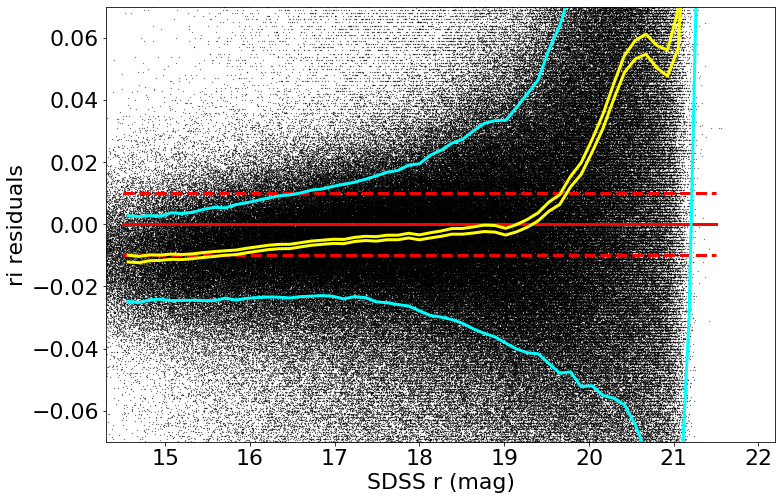

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0036271469116193333 std.dev: 0.04921206381428205
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


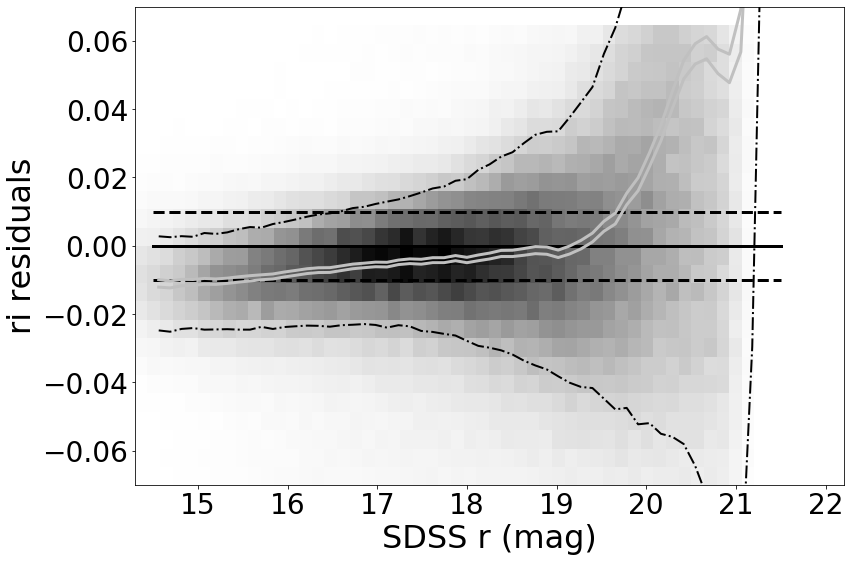

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0035816154480000917 std.dev: 0.02138013554505804
saved plot as: colorResidGaiaColors_ri_Gmag.png


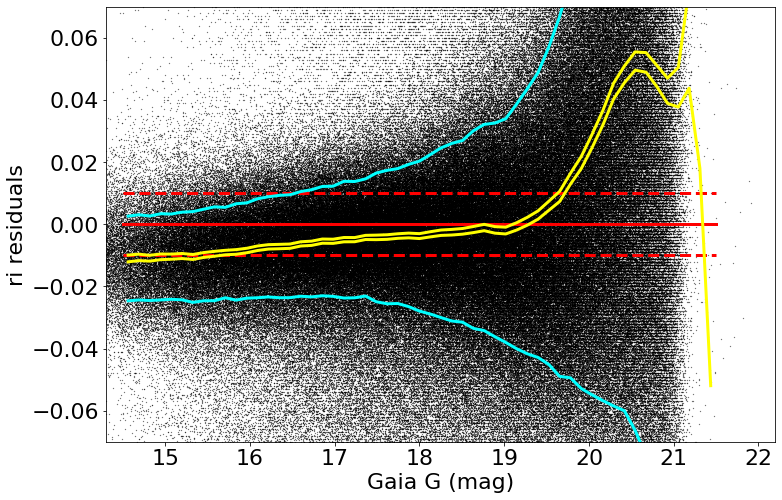

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0035816154480000917 std.dev: 0.02138013554505804
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


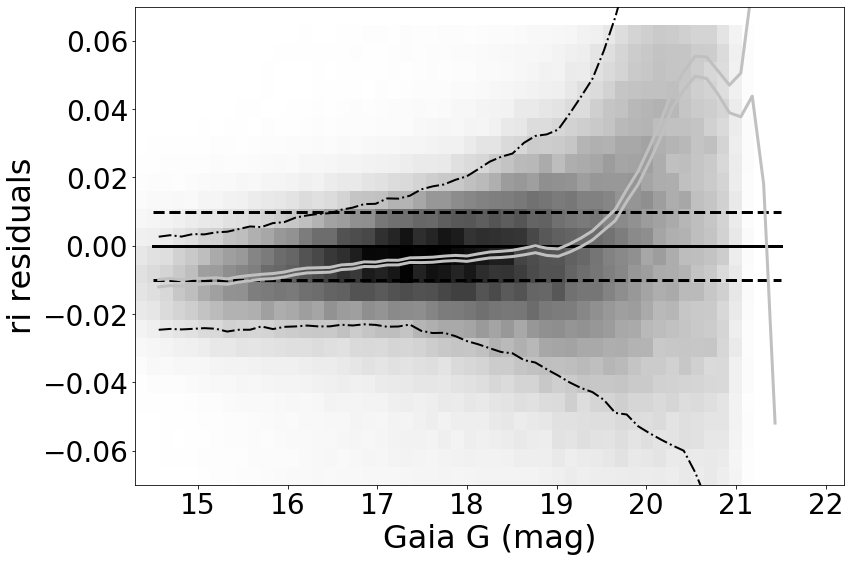

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008069349288942824 std.dev: 0.008405460025542757
saved plot as: colorResidGaiaColors_rz_RA.png


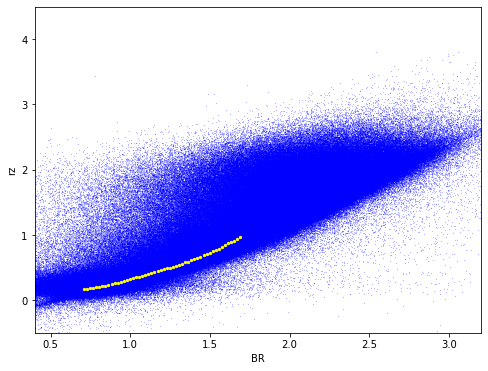

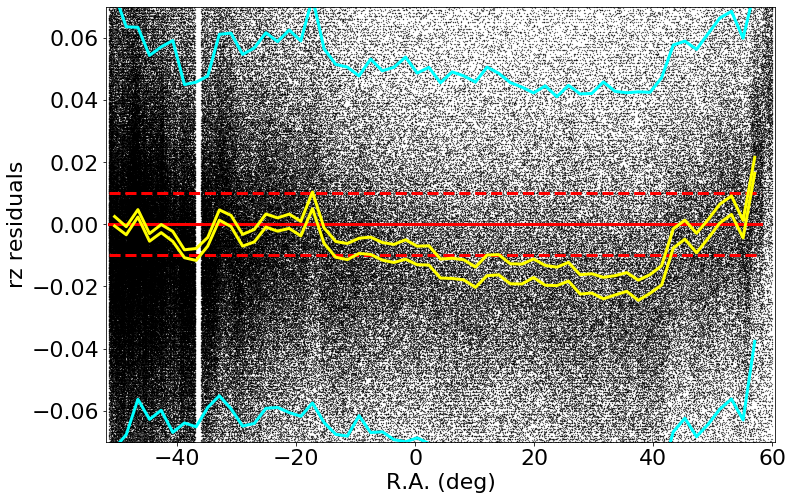

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.007736273193358317 std.dev: 0.008412853995260759
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


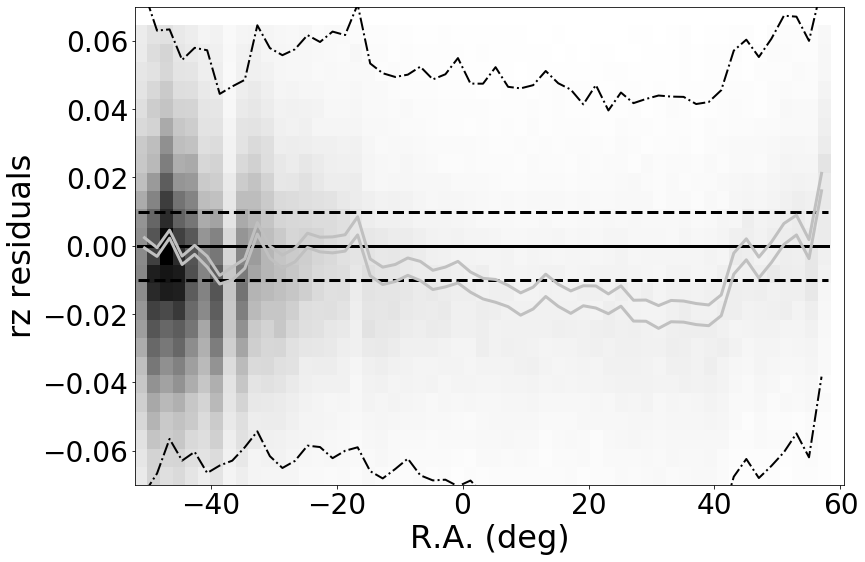

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00511232261657775 std.dev: 0.003183659061814311
saved plot as: colorResidGaiaColors_rz_Dec.png


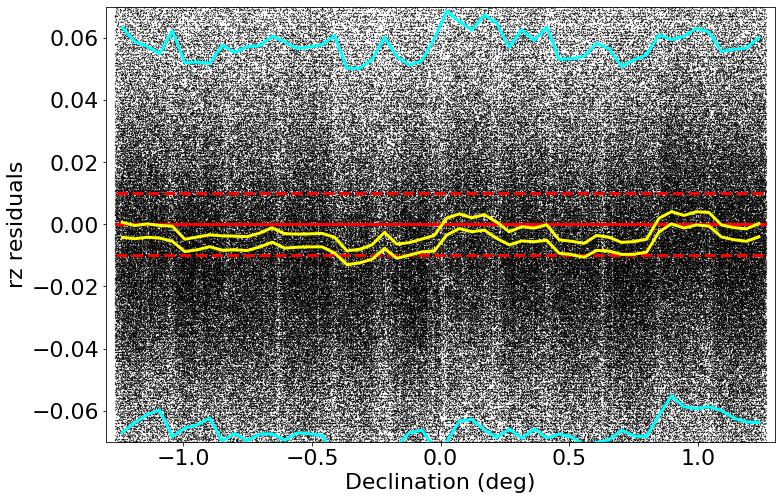

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.0049065986633300696 std.dev: 0.003149149544410354
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


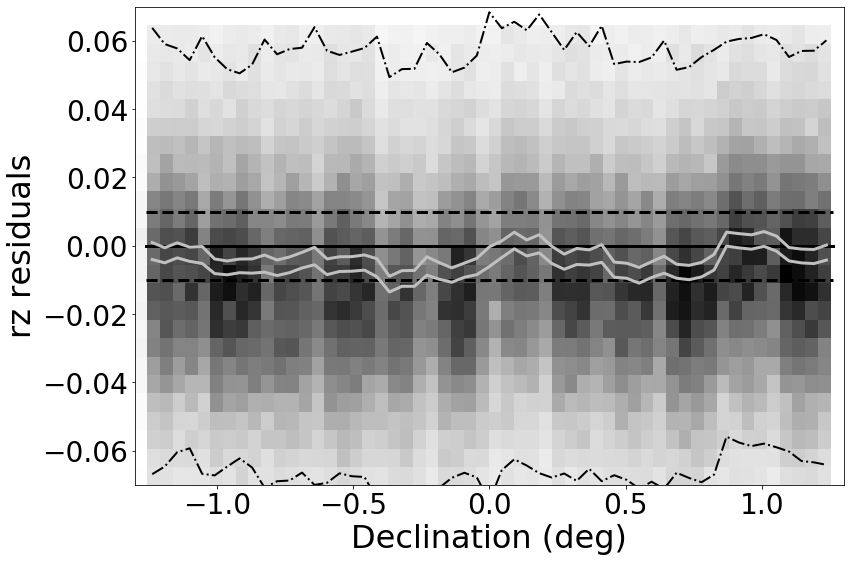

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00804257659911968 std.dev: 0.0507339157704549
saved plot as: colorResidGaiaColors_rz_rmag.png


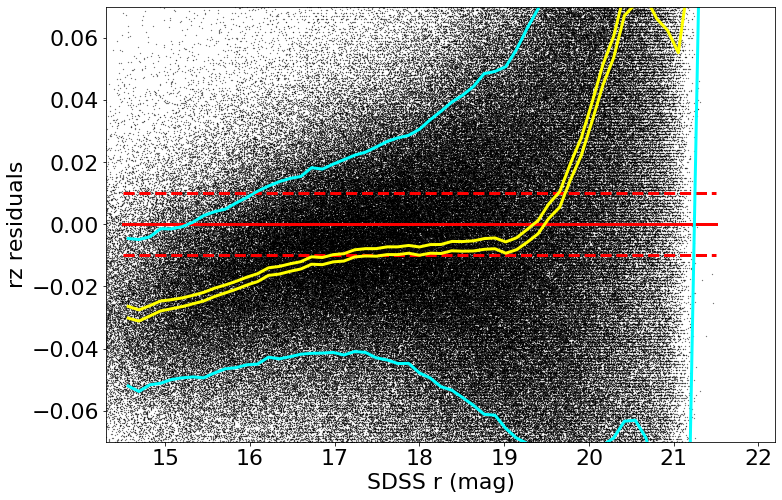

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00804257659911968 std.dev: 0.0507339157704549
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


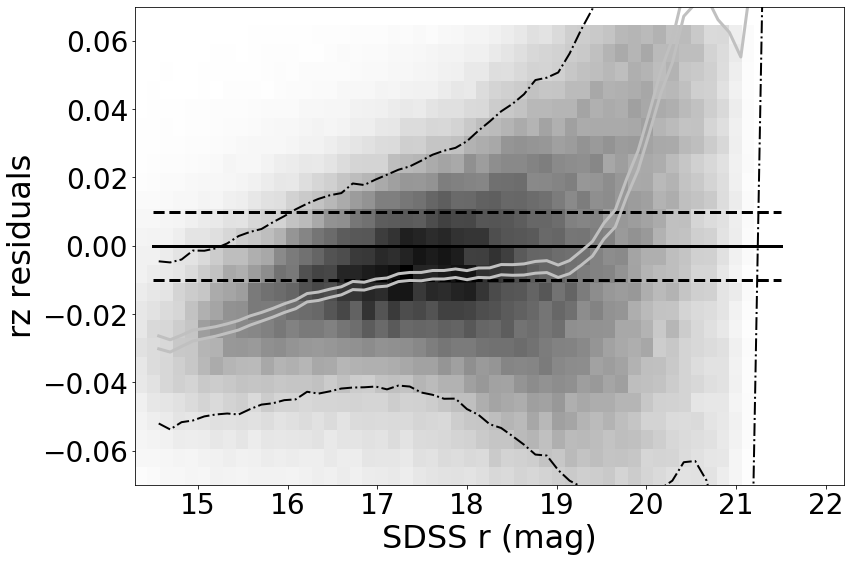

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008055117797853062 std.dev: 0.03064511185412417
saved plot as: colorResidGaiaColors_rz_Gmag.png


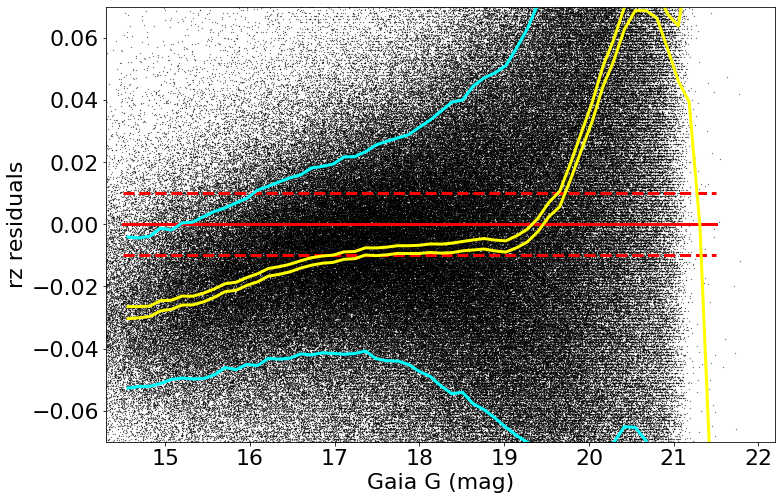

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008055117797853062 std.dev: 0.03064511185412417
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


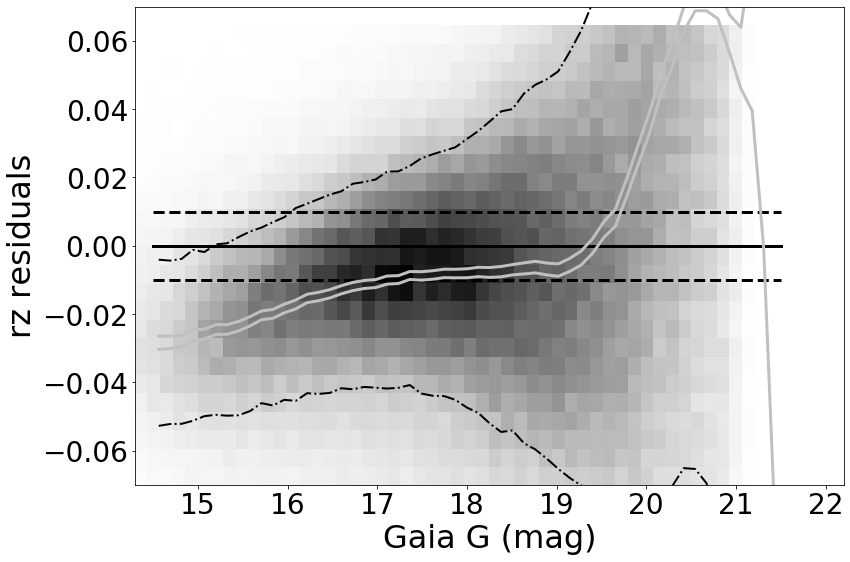

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [40]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [42]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesBu = matchesB[(matchesB['u_mMed_new']<20)]
print(np.size(matches), np.size(matchesB), np.size(matchesBu))

905428 307495 115085


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.00789023389816046 std.dev: 0.02996975755675366
saved plot as: colorResidGaiaColorsB_ur_RA.png


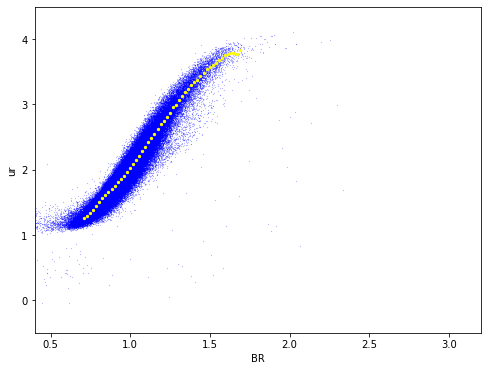

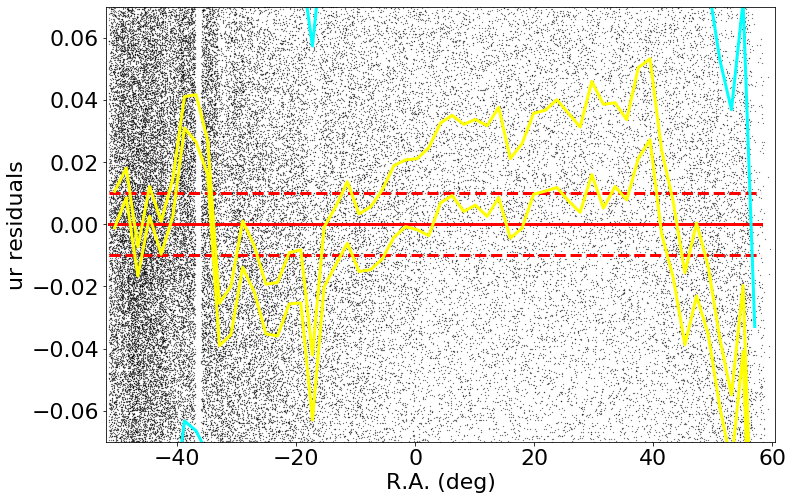

medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.007741361999512697 std.dev: 0.02998773445565591
saved plot as: colorResidGaiaColorsB_ur_RA_Hess.png


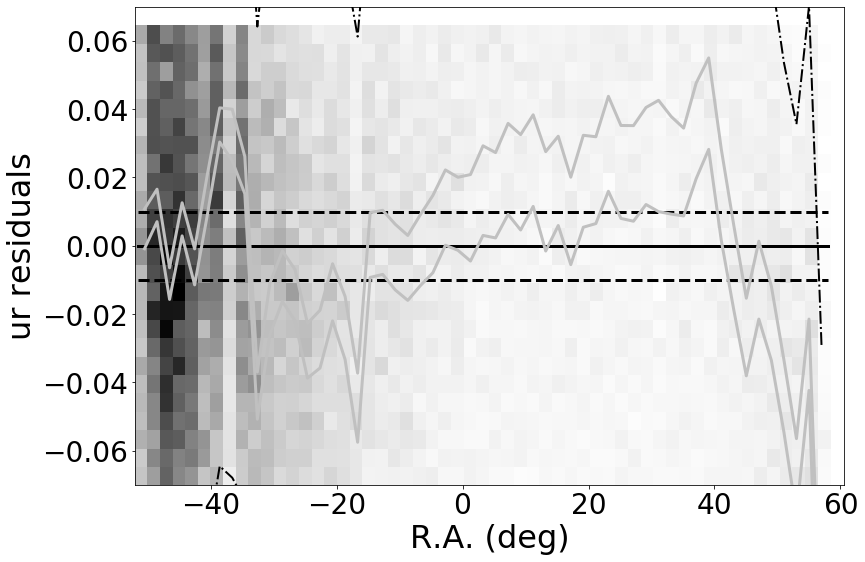

made plot colorResidGaiaColorsB_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.0019844032287564817 std.dev: 0.004345199411112531
saved plot as: colorResidGaiaColorsB_ur_Dec.png


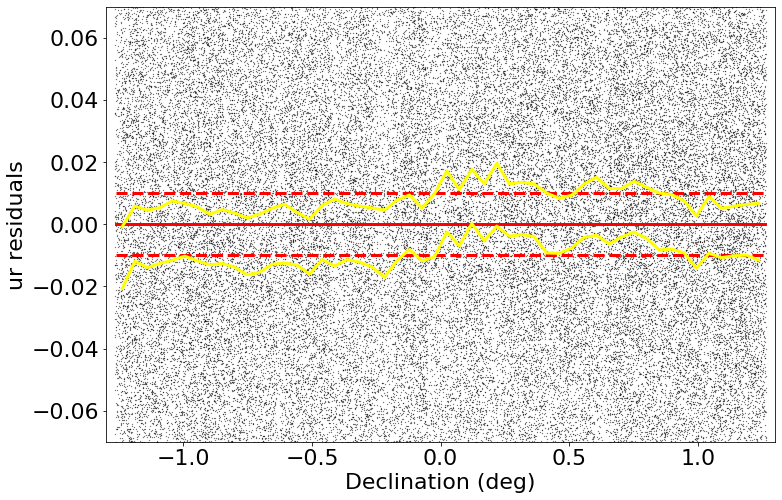

medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.0012627410888679247 std.dev: 0.0049004975909383965
saved plot as: colorResidGaiaColorsB_ur_Dec_Hess.png


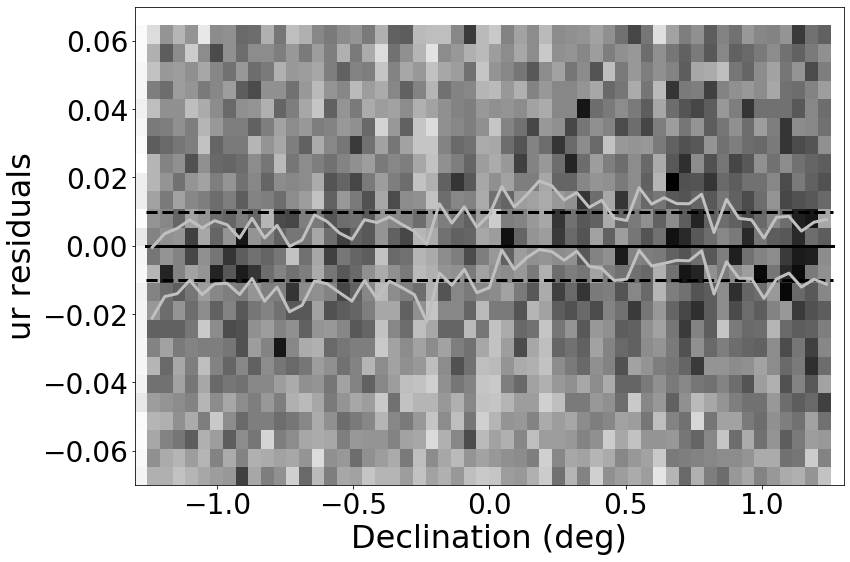

made plot colorResidGaiaColorsB_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.0024857734680167054 std.dev: 0.07971231841793266
saved plot as: colorResidGaiaColorsB_ur_rmag.png


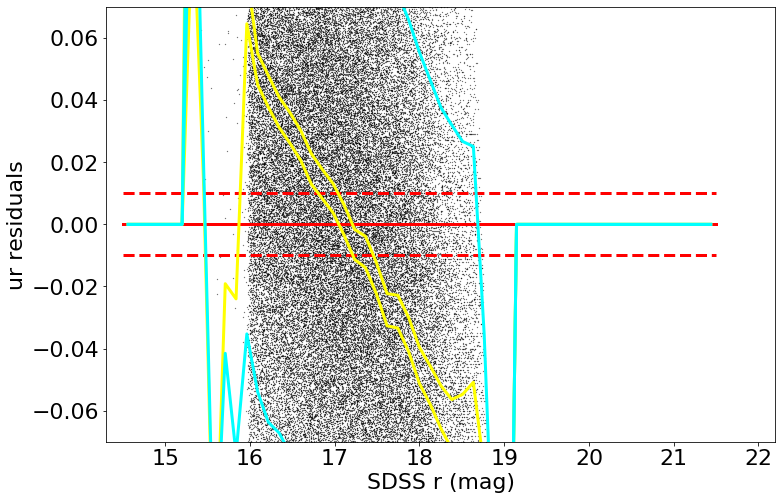

medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.0024857734680167054 std.dev: 0.07971231841793266
saved plot as: colorResidGaiaColorsB_ur_rmag_Hess.png


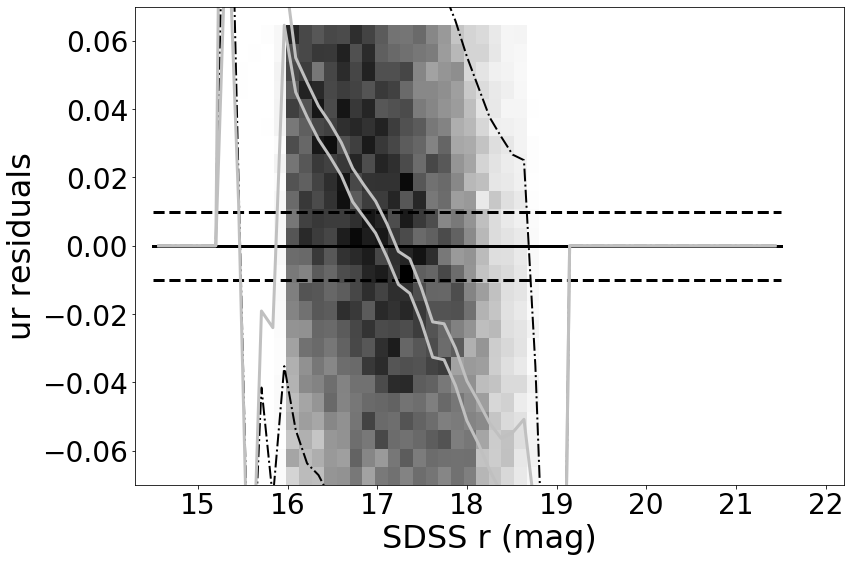

made plot colorResidGaiaColorsB_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.009348168182373273 std.dev: 0.05101319653137013
saved plot as: colorResidGaiaColorsB_ur_Gmag.png


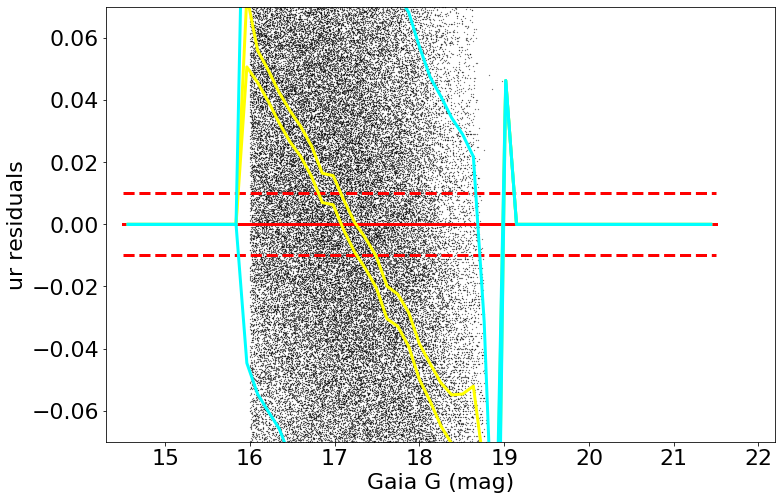

medianAll: -0.0007110488891604039 std.dev.All: 0.10880452599449252
N= 110154 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.009348168182373273 std.dev: 0.05101319653137013
saved plot as: colorResidGaiaColorsB_ur_Gmag_Hess.png


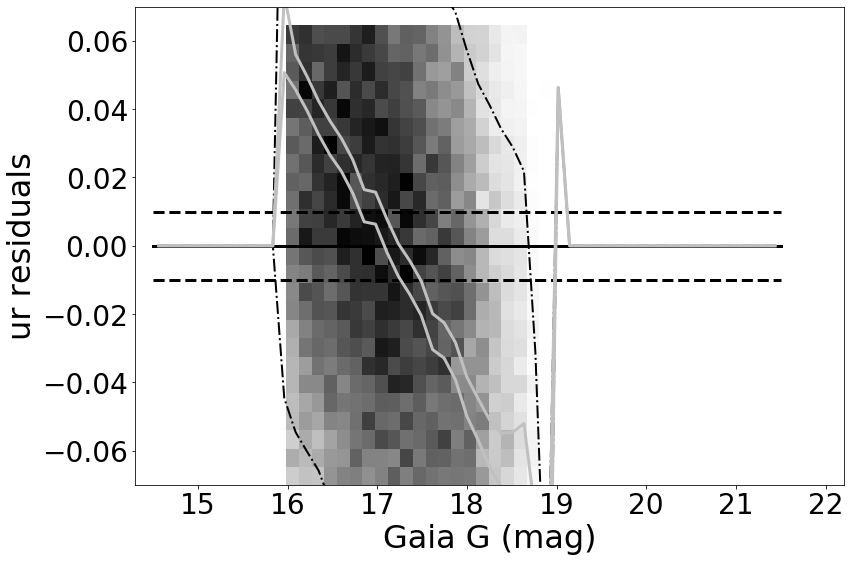

made plot colorResidGaiaColorsB_ur_Gmag_Hess.png
------------------------------------------------------------------


In [44]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
color = 'ur' 
keywords["Ystr"] = color 
doOneColorGaiaBR(matchesBu, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.016970539093019238 std.dev: 0.005727218441050787
saved plot as: colorResidGaiaColorsB_gr_RA.png


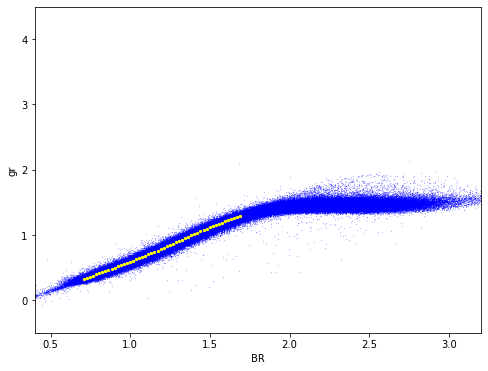

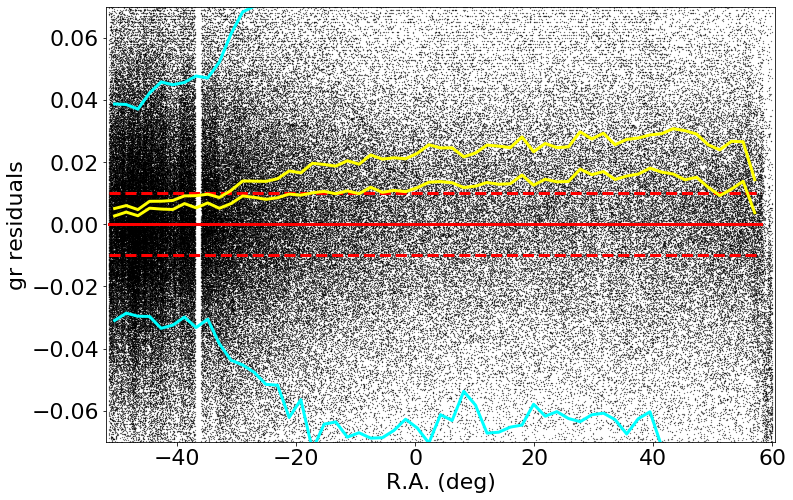

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.017149758911131574 std.dev: 0.005687817470238382
saved plot as: colorResidGaiaColorsB_gr_RA_Hess.png


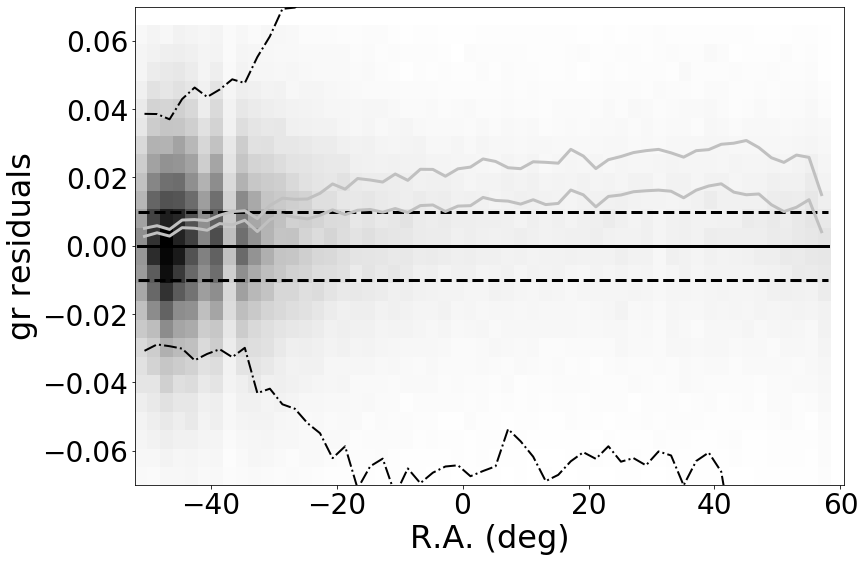

made plot colorResidGaiaColorsB_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010967192077636911 std.dev: 0.0012548174582897263
saved plot as: colorResidGaiaColorsB_gr_Dec.png


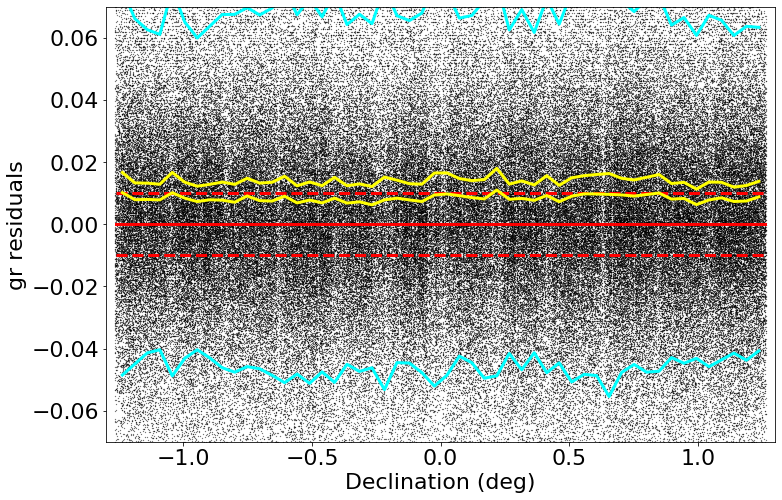

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.01101986389160109 std.dev: 0.0012160098464777482
saved plot as: colorResidGaiaColorsB_gr_Dec_Hess.png


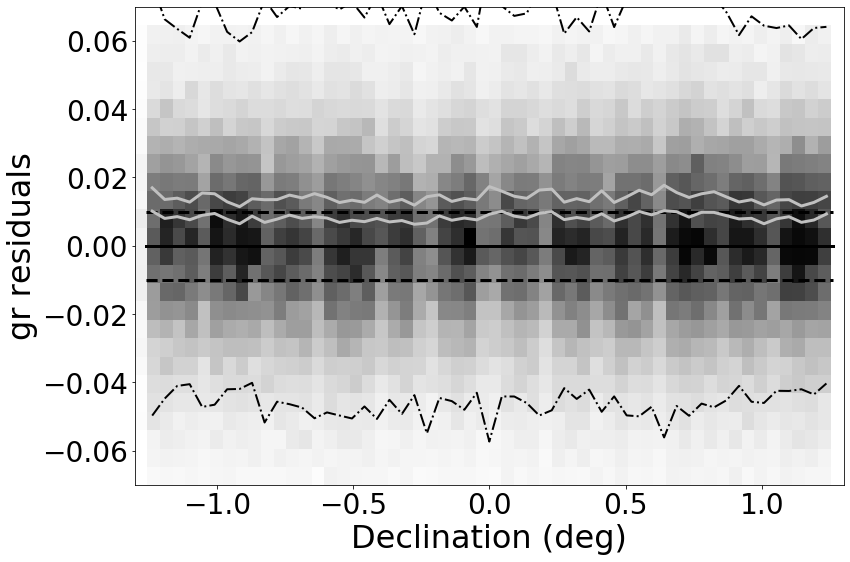

made plot colorResidGaiaColorsB_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010743598937988194 std.dev: 0.09005764911689633
saved plot as: colorResidGaiaColorsB_gr_rmag.png


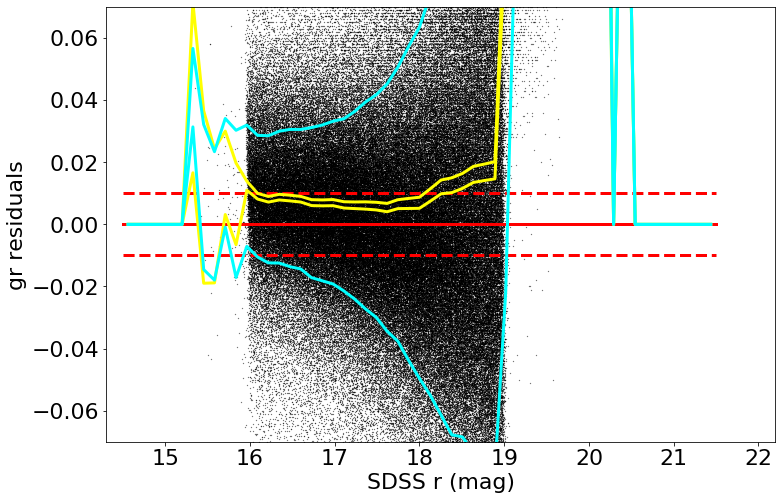

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010743598937988194 std.dev: 0.09005764911689633
saved plot as: colorResidGaiaColorsB_gr_rmag_Hess.png


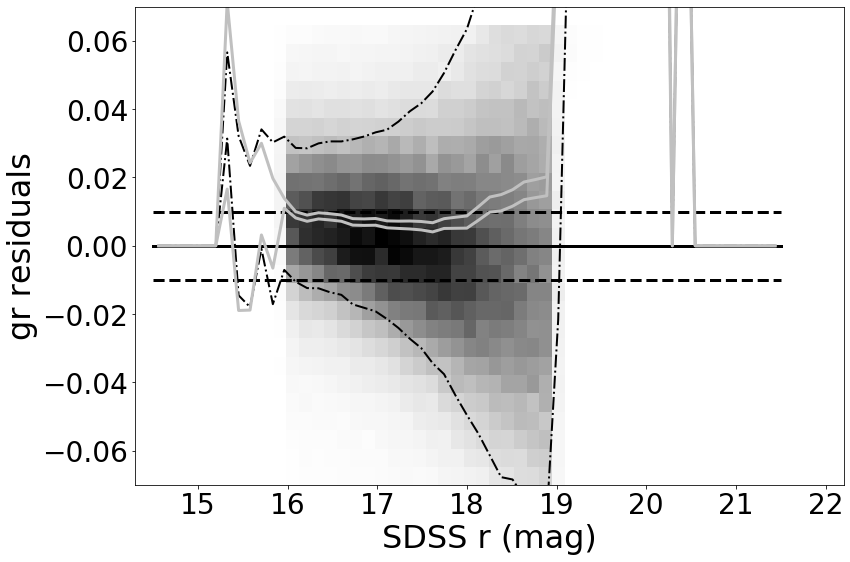

made plot colorResidGaiaColorsB_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.00959090881347674 std.dev: 0.005559385342096429
saved plot as: colorResidGaiaColorsB_gr_Gmag.png


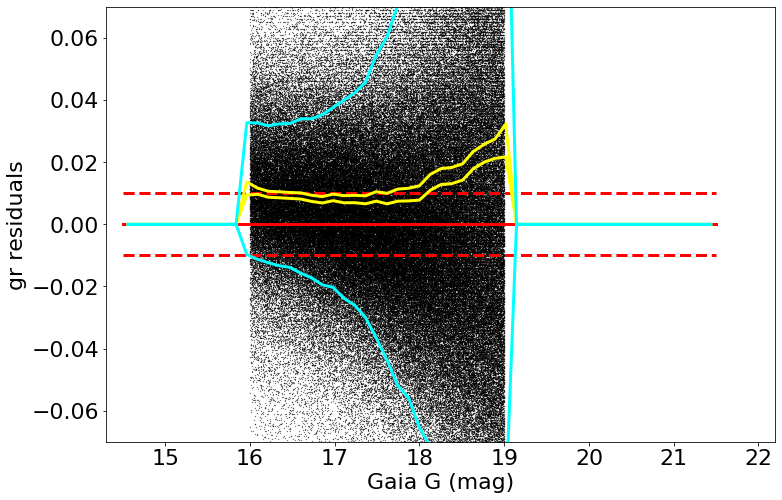

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.00959090881347674 std.dev: 0.005559385342096429
saved plot as: colorResidGaiaColorsB_gr_Gmag_Hess.png


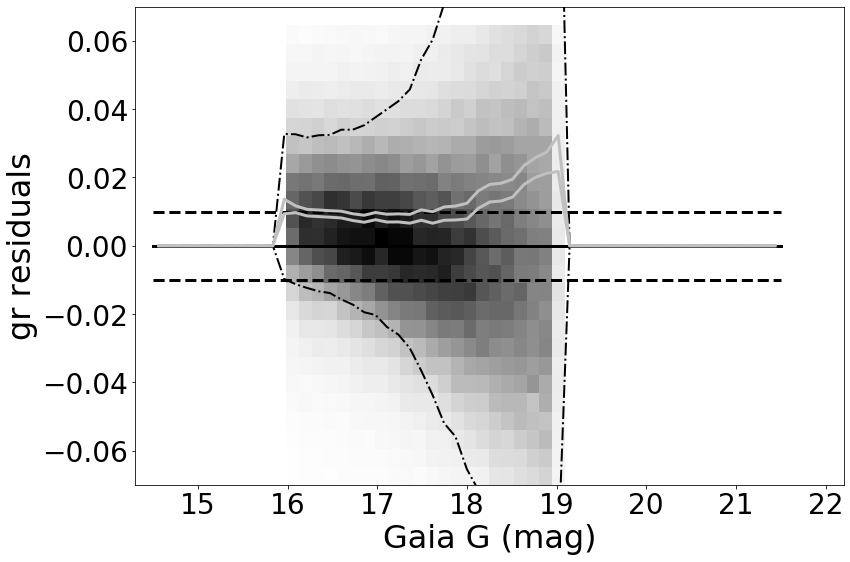

made plot colorResidGaiaColorsB_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0049088714599609465 std.dev: 0.0026350406579650275
saved plot as: colorResidGaiaColorsB_ri_RA.png


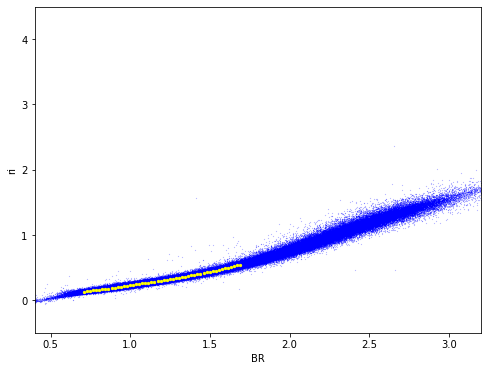

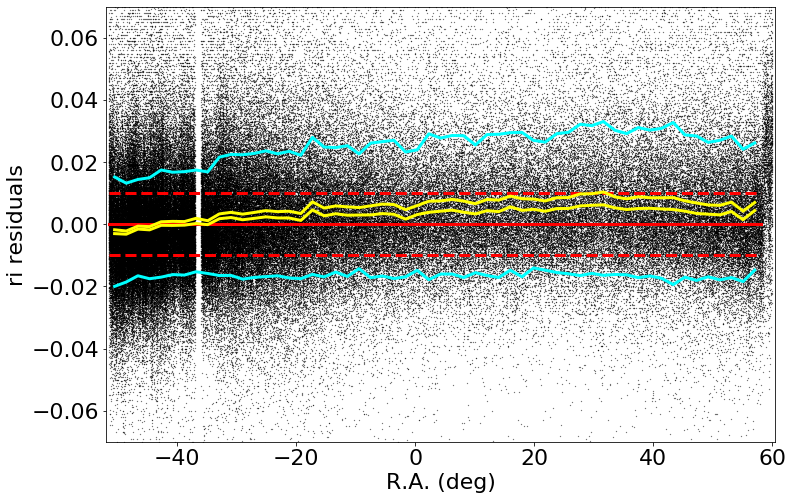

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.004939047241212302 std.dev: 0.00262942999841515
saved plot as: colorResidGaiaColorsB_ri_RA_Hess.png


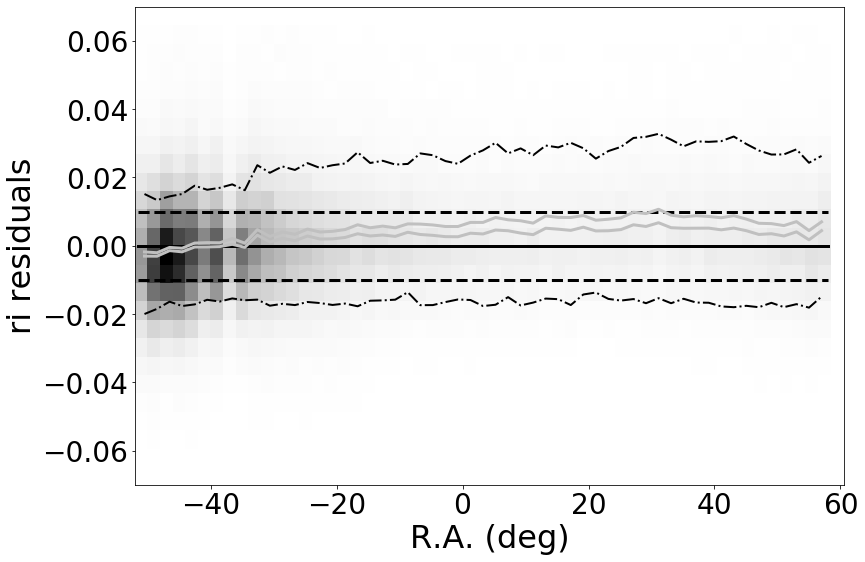

made plot colorResidGaiaColorsB_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026341688156122506 std.dev: 0.0005551279313544805
saved plot as: colorResidGaiaColorsB_ri_Dec.png


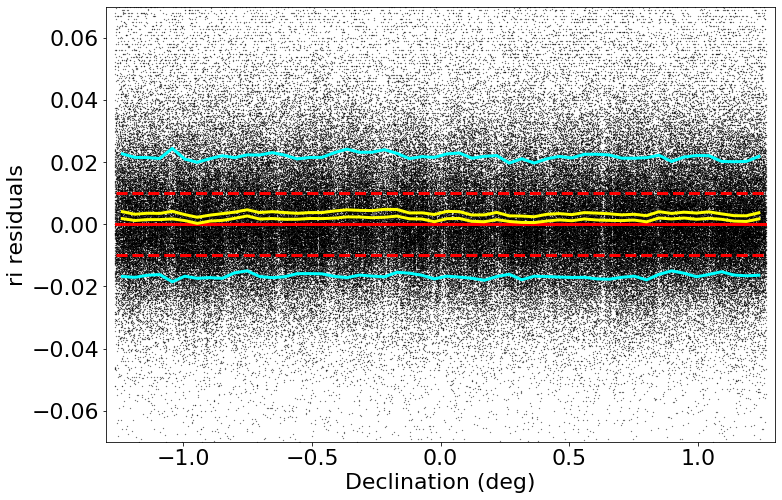

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0025919586181641224 std.dev: 0.0006117190112201059
saved plot as: colorResidGaiaColorsB_ri_Dec_Hess.png


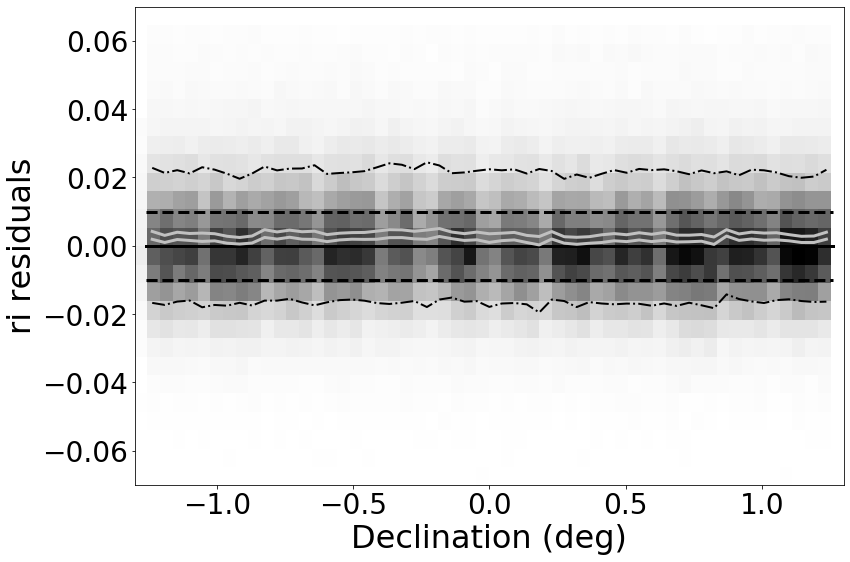

made plot colorResidGaiaColorsB_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002302984619141357 std.dev: 0.07018130499788933
saved plot as: colorResidGaiaColorsB_ri_rmag.png


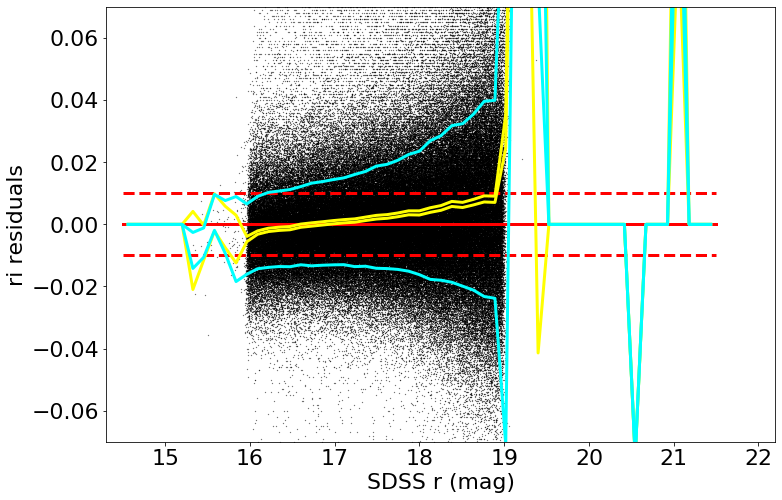

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002302984619141357 std.dev: 0.07018130499788933
saved plot as: colorResidGaiaColorsB_ri_rmag_Hess.png


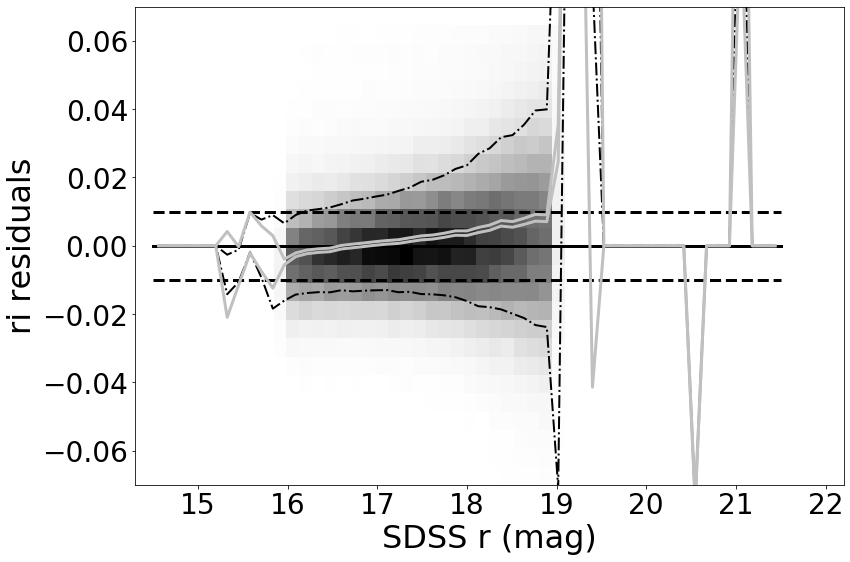

made plot colorResidGaiaColorsB_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002395918273926906 std.dev: 0.0033423568890779266
saved plot as: colorResidGaiaColorsB_ri_Gmag.png


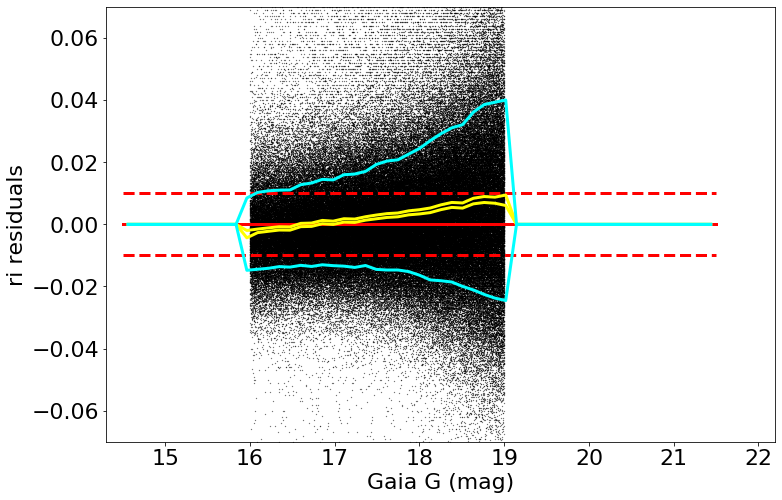

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002395918273926906 std.dev: 0.0033423568890779266
saved plot as: colorResidGaiaColorsB_ri_Gmag_Hess.png


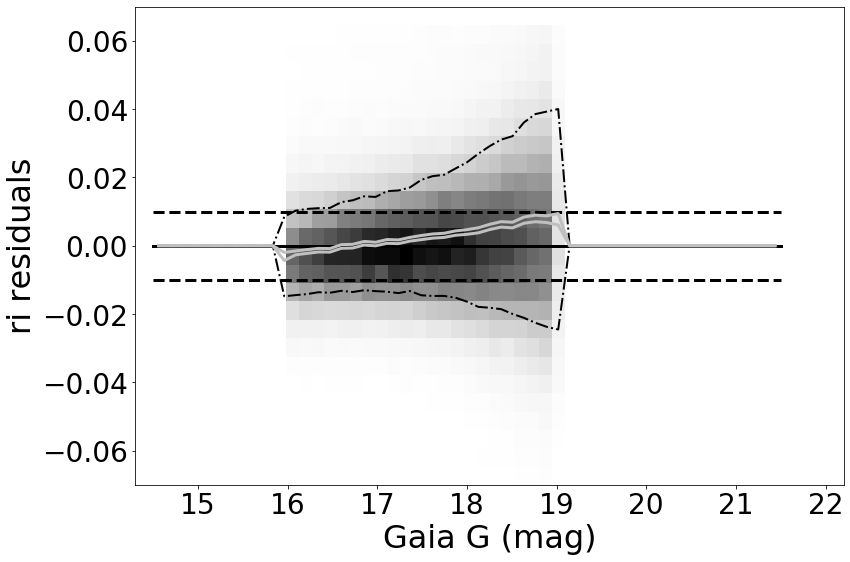

made plot colorResidGaiaColorsB_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.005877142333985258 std.dev: 0.0034937511231928984
saved plot as: colorResidGaiaColorsB_rz_RA.png


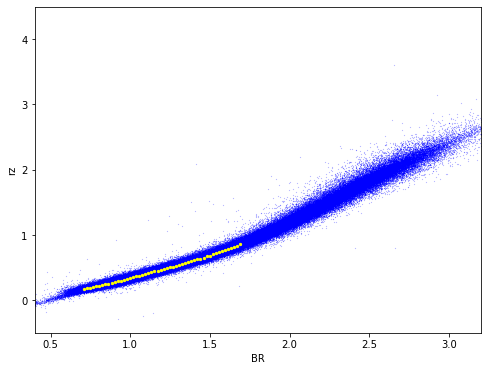

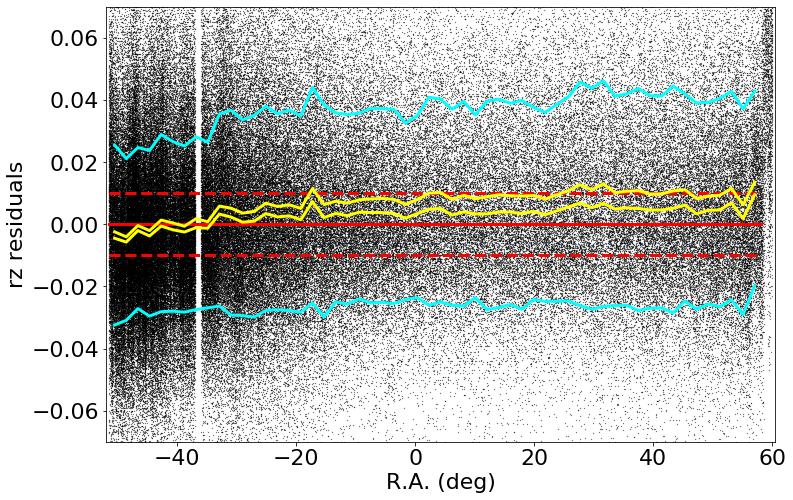

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.006000000000000227 std.dev: 0.0034702146199946955
saved plot as: colorResidGaiaColorsB_rz_RA_Hess.png


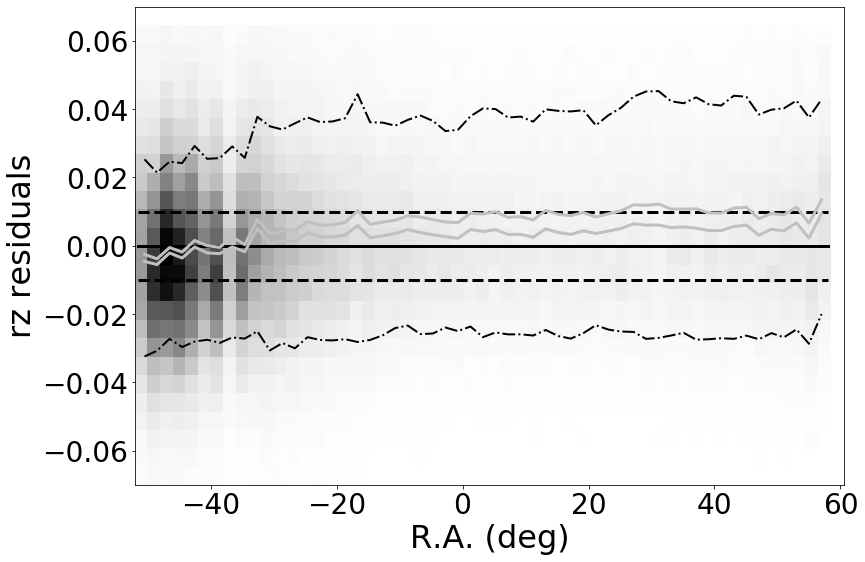

made plot colorResidGaiaColorsB_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.003180253601072283 std.dev: 0.0013416752125505918
saved plot as: colorResidGaiaColorsB_rz_Dec.png


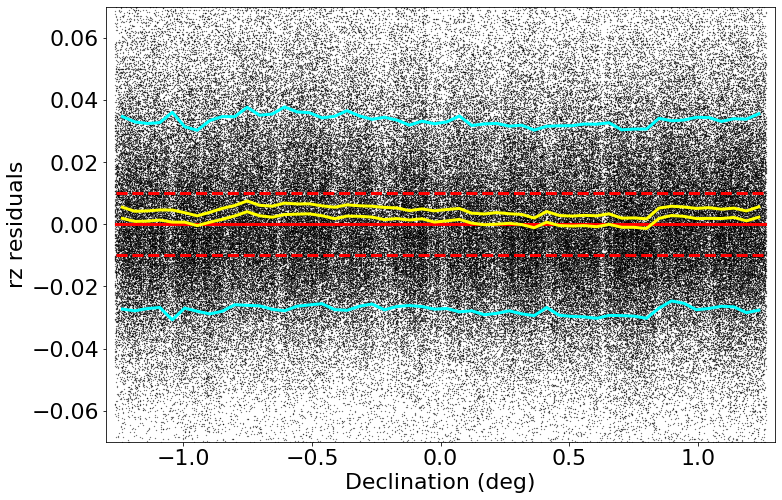

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0031829345703113243 std.dev: 0.0014193216500349136
saved plot as: colorResidGaiaColorsB_rz_Dec_Hess.png


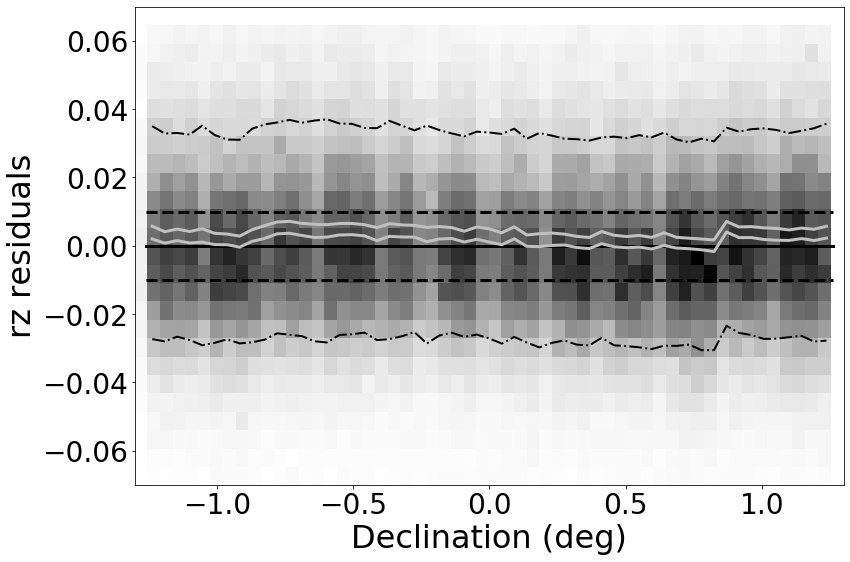

made plot colorResidGaiaColorsB_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0016313934326215862 std.dev: 0.053178995570299425
saved plot as: colorResidGaiaColorsB_rz_rmag.png


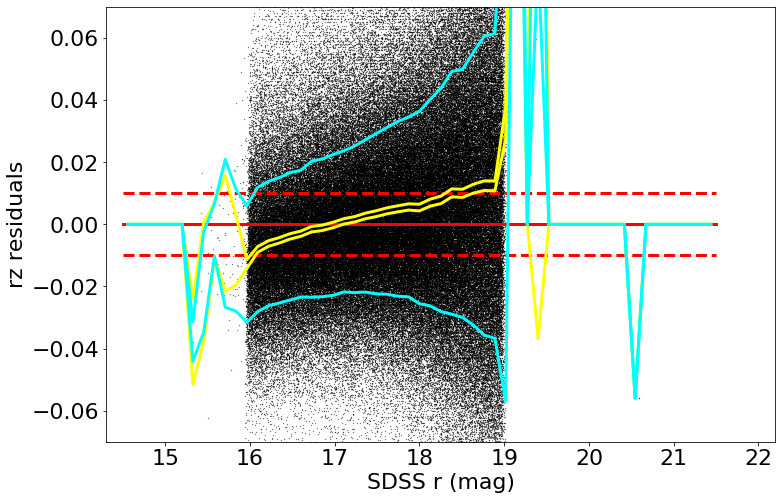

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0016313934326215862 std.dev: 0.053178995570299425
saved plot as: colorResidGaiaColorsB_rz_rmag_Hess.png


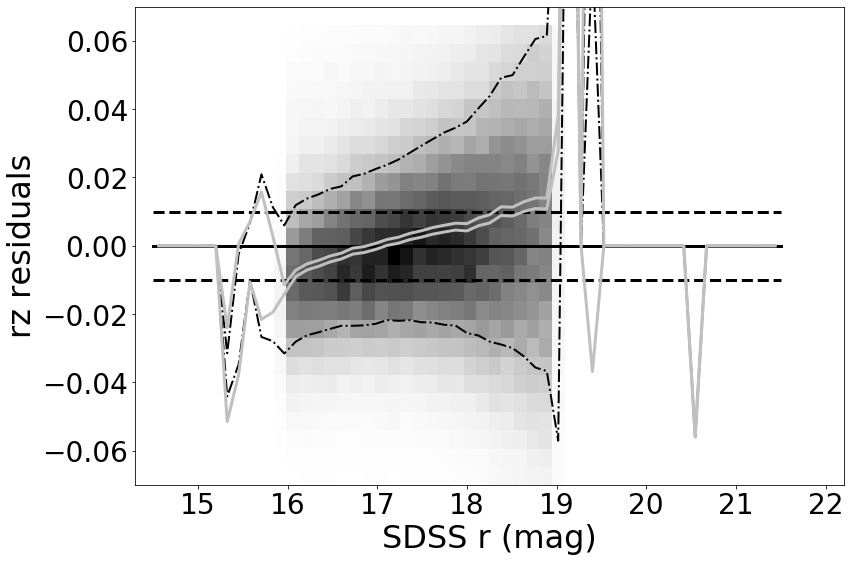

made plot colorResidGaiaColorsB_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0035523681640637073 std.dev: 0.006479395498933692
saved plot as: colorResidGaiaColorsB_rz_Gmag.png


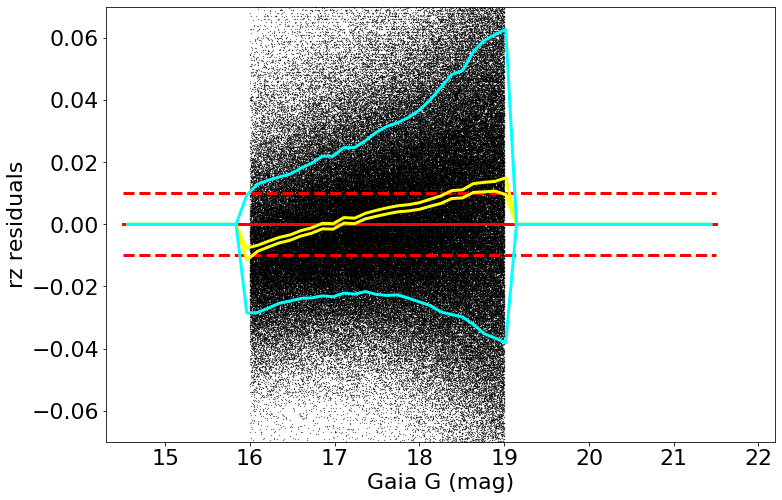

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0035523681640637073 std.dev: 0.006479395498933692
saved plot as: colorResidGaiaColorsB_rz_Gmag_Hess.png


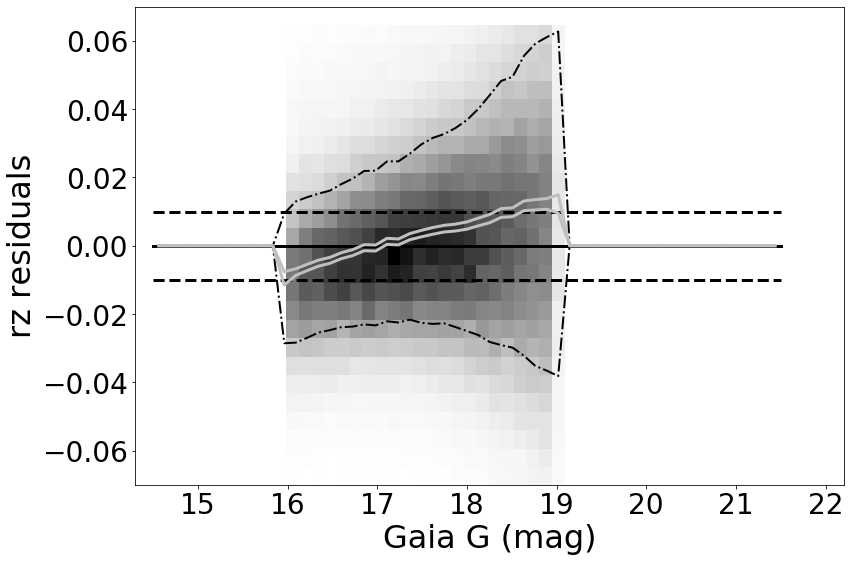

made plot colorResidGaiaColorsB_rz_Gmag_Hess.png
------------------------------------------------------------------


In [46]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [48]:
matchesRecalib = matches[(matches['BR']>0.7)&(matches['BR']<1.7)]
matchesUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matchesRecalib), np.size(matchesUR))

543663 168628


=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.016970539093019238 std.dev: 0.005727218441050787
saved plot as: colorResidGaiaColorsRecalib_gr_RA.png


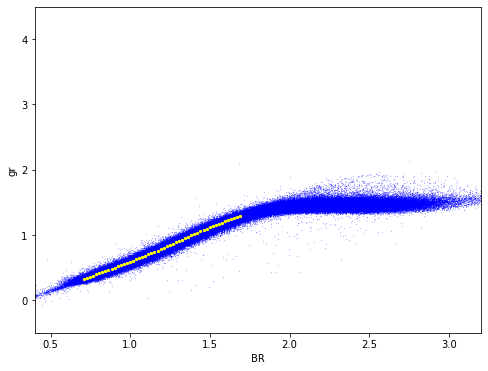

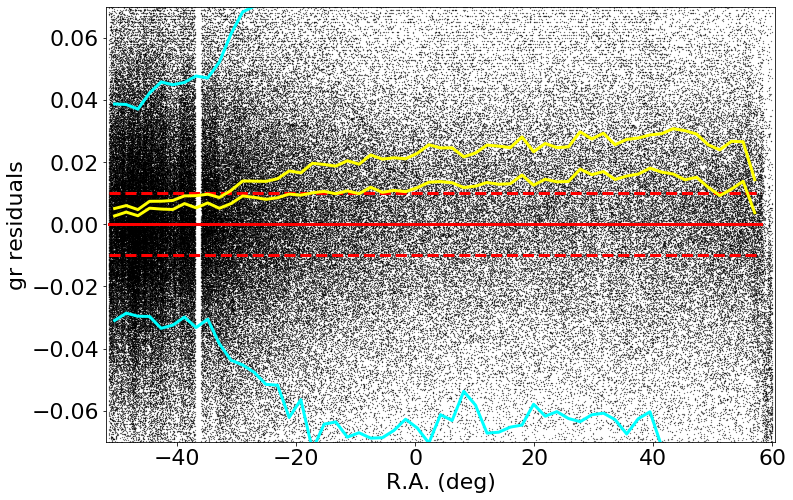

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.017149758911131574 std.dev: 0.005687817470238382
saved plot as: colorResidGaiaColorsRecalib_gr_RA_Hess.png


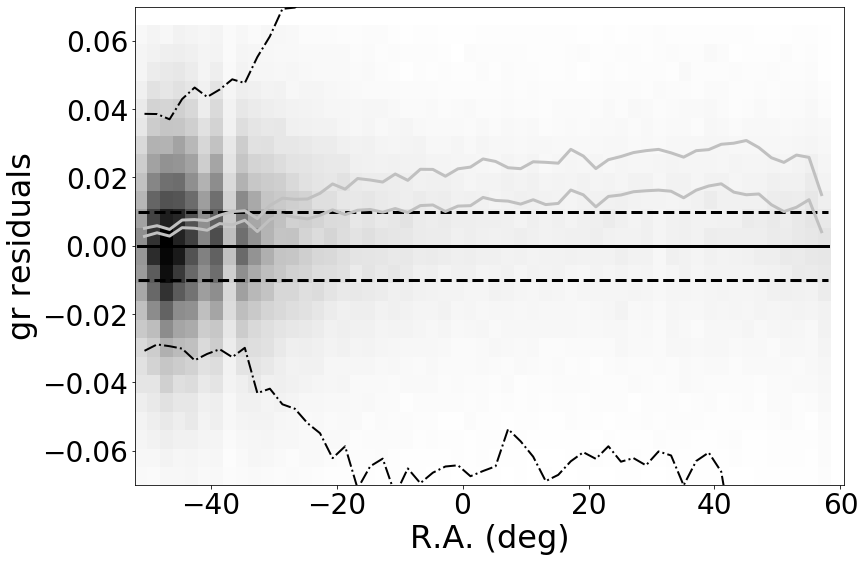

made plot colorResidGaiaColorsRecalib_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010967192077636911 std.dev: 0.0012548174582897263
saved plot as: colorResidGaiaColorsRecalib_gr_Dec.png


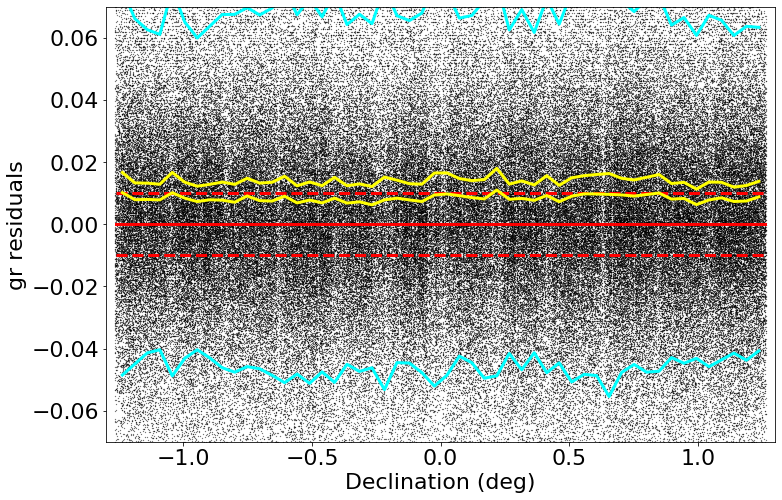

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.01101986389160109 std.dev: 0.0012160098464777482
saved plot as: colorResidGaiaColorsRecalib_gr_Dec_Hess.png


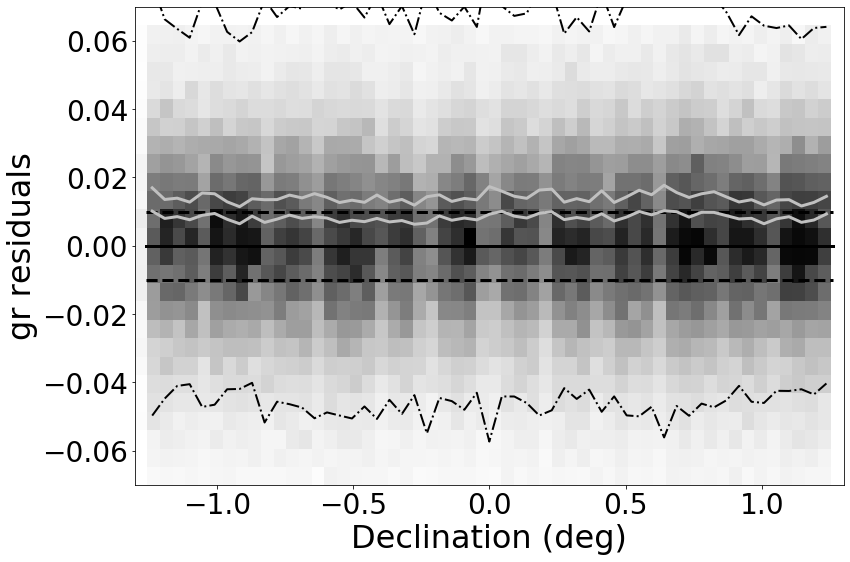

made plot colorResidGaiaColorsRecalib_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010743598937988194 std.dev: 0.09005764911689633
saved plot as: colorResidGaiaColorsRecalib_gr_rmag.png


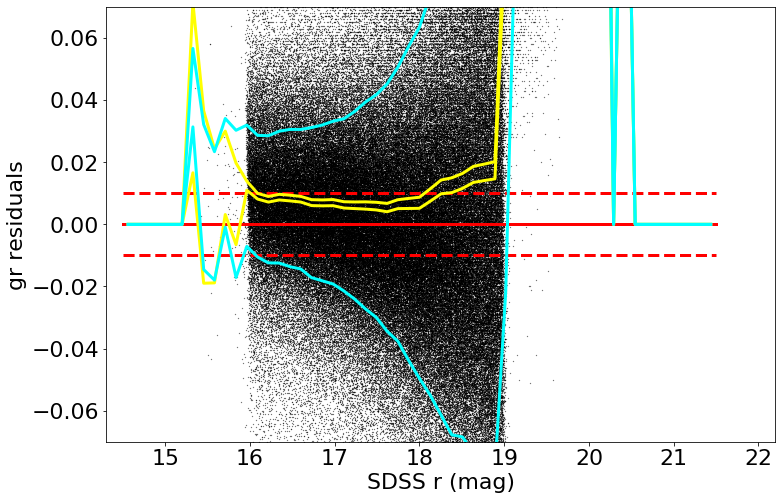

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.010743598937988194 std.dev: 0.09005764911689633
saved plot as: colorResidGaiaColorsRecalib_gr_rmag_Hess.png


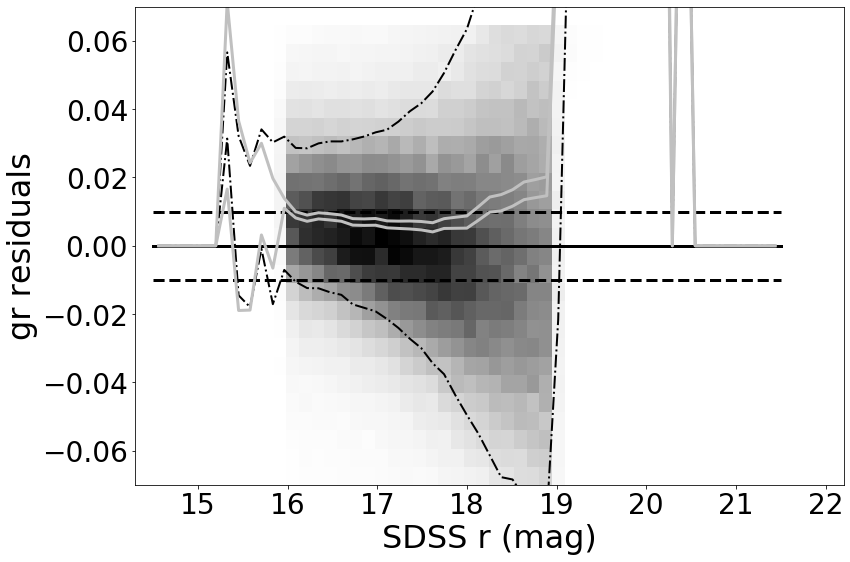

made plot colorResidGaiaColorsRecalib_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.00959090881347674 std.dev: 0.005559385342096429
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag.png


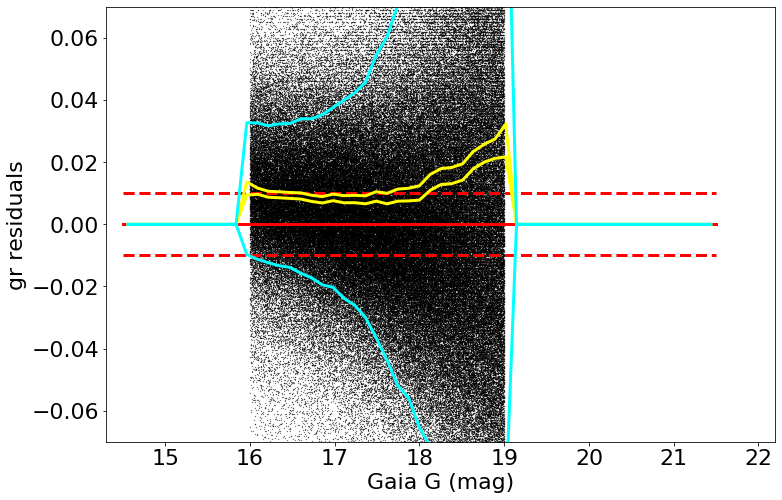

medianAll: 0.01112469940185512 std.dev.All: 0.05702591092529508
N= 304025 min= -0.2989999999999995 max= 0.29999999999999716
median: 0.00959090881347674 std.dev: 0.005559385342096429
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag_Hess.png


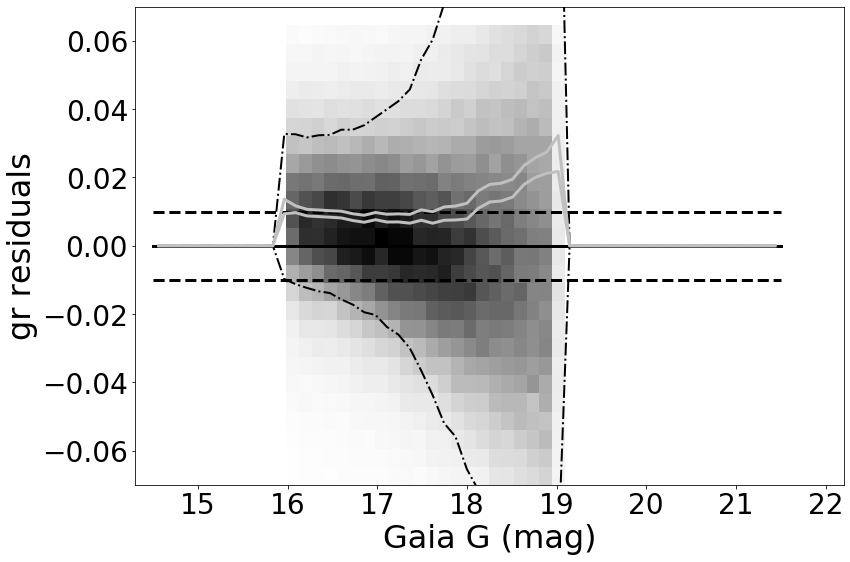

made plot colorResidGaiaColorsRecalib_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0049088714599609465 std.dev: 0.0026350406579650275
saved plot as: colorResidGaiaColorsRecalib_ri_RA.png


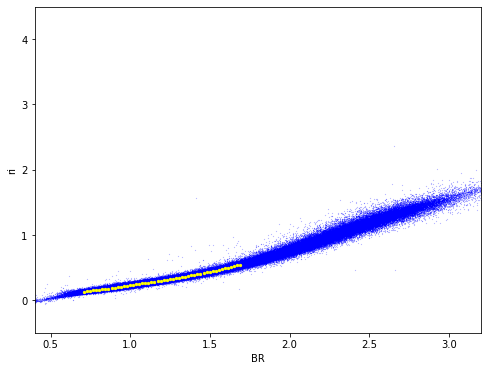

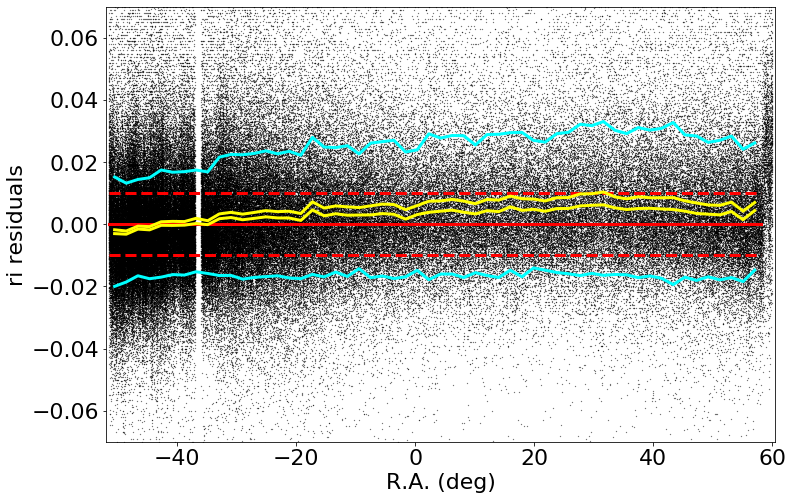

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.004939047241212302 std.dev: 0.00262942999841515
saved plot as: colorResidGaiaColorsRecalib_ri_RA_Hess.png


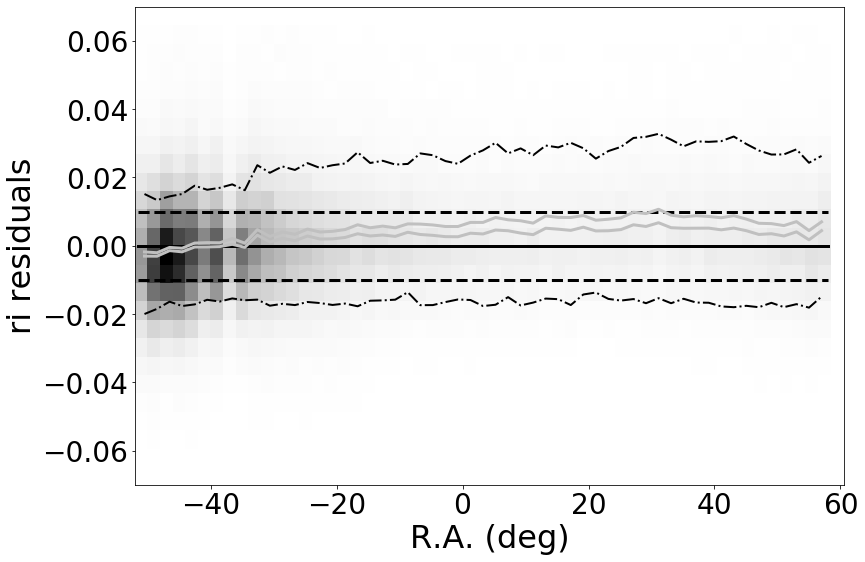

made plot colorResidGaiaColorsRecalib_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026341688156122506 std.dev: 0.0005551279313544805
saved plot as: colorResidGaiaColorsRecalib_ri_Dec.png


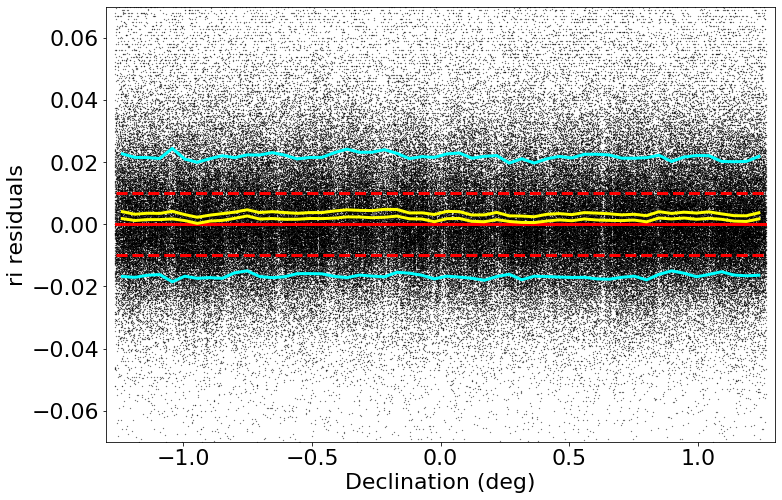

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0025919586181641224 std.dev: 0.0006117190112201059
saved plot as: colorResidGaiaColorsRecalib_ri_Dec_Hess.png


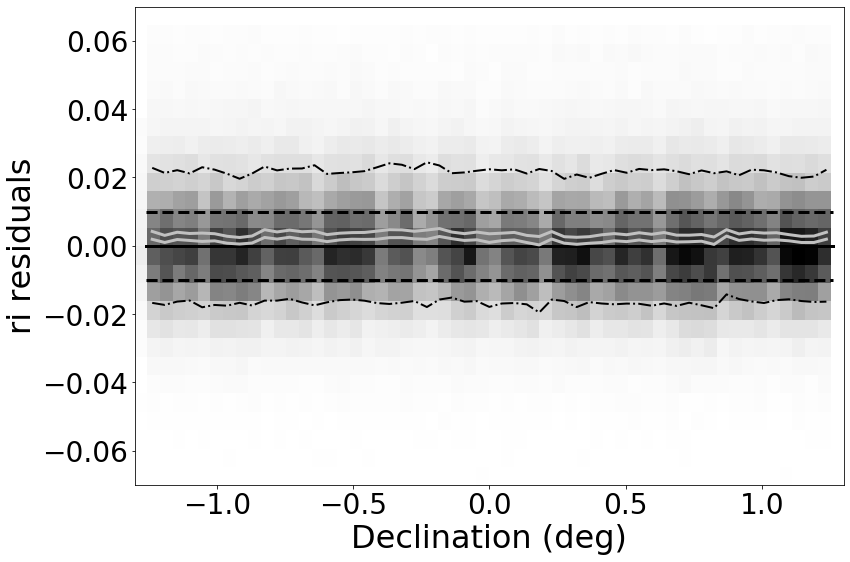

made plot colorResidGaiaColorsRecalib_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002302984619141357 std.dev: 0.07018130499788933
saved plot as: colorResidGaiaColorsRecalib_ri_rmag.png


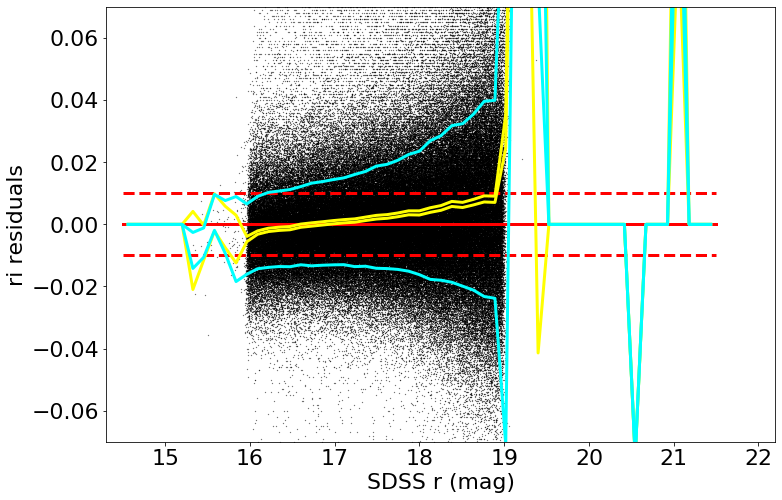

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002302984619141357 std.dev: 0.07018130499788933
saved plot as: colorResidGaiaColorsRecalib_ri_rmag_Hess.png


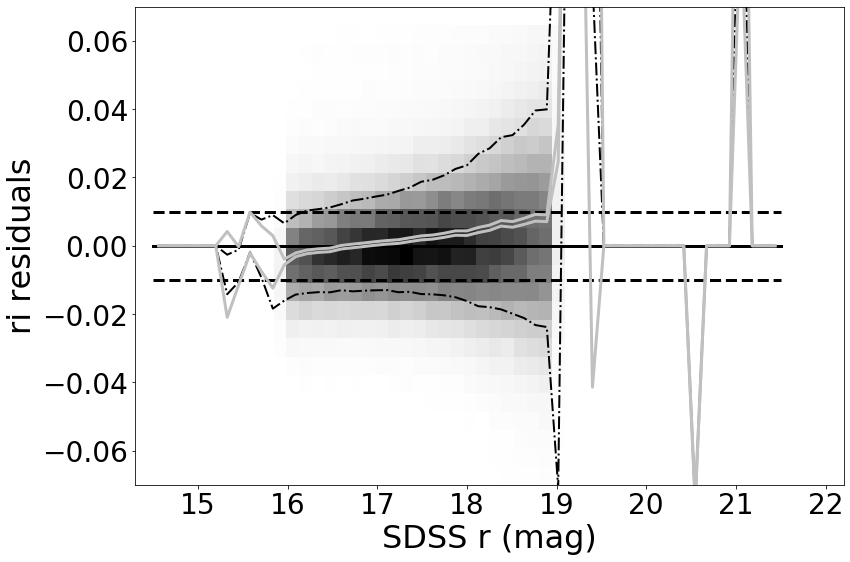

made plot colorResidGaiaColorsRecalib_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002395918273926906 std.dev: 0.0033423568890779266
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag.png


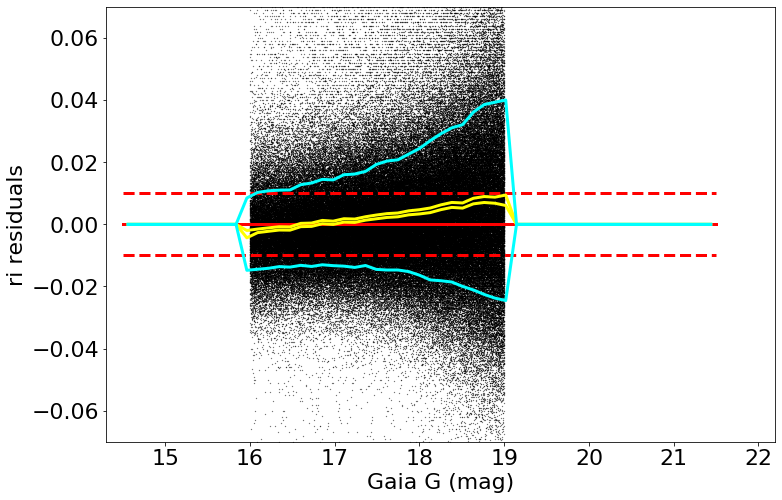

medianAll: 0.0025486114501937496 std.dev.All: 0.019237035466003208
N= 261611 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002395918273926906 std.dev: 0.0033423568890779266
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag_Hess.png


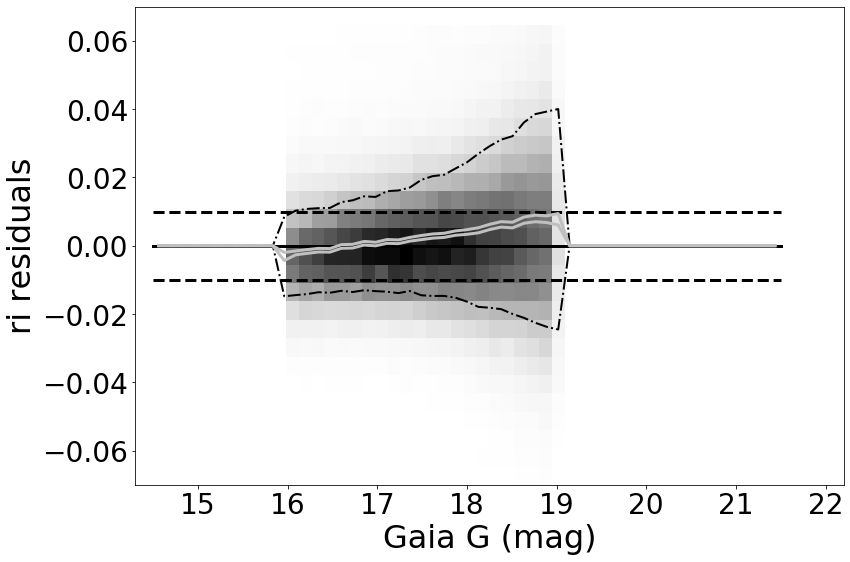

made plot colorResidGaiaColorsRecalib_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.005877142333985258 std.dev: 0.0034937511231928984
saved plot as: colorResidGaiaColorsRecalib_rz_RA.png


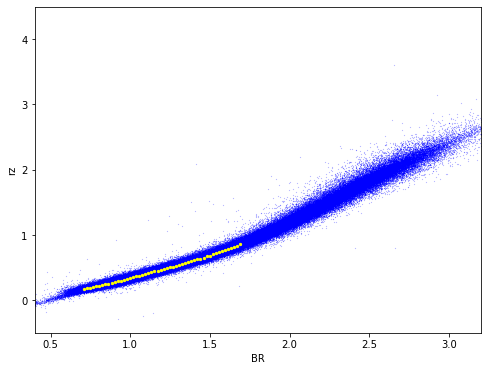

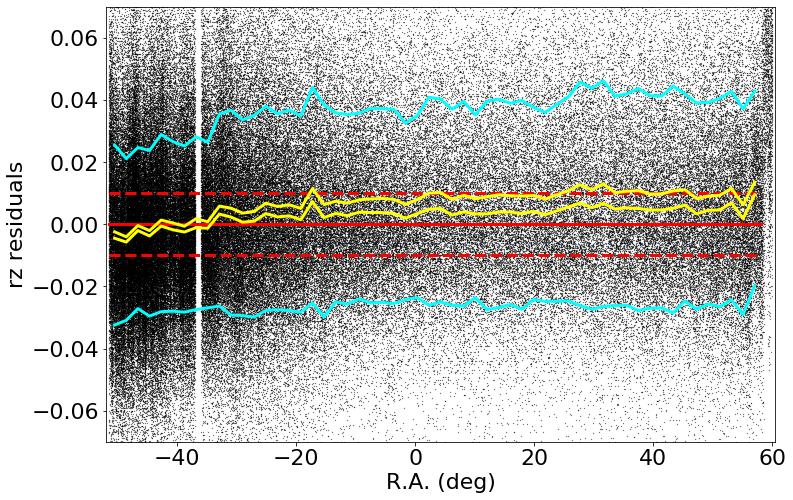

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.006000000000000227 std.dev: 0.0034702146199946955
saved plot as: colorResidGaiaColorsRecalib_rz_RA_Hess.png


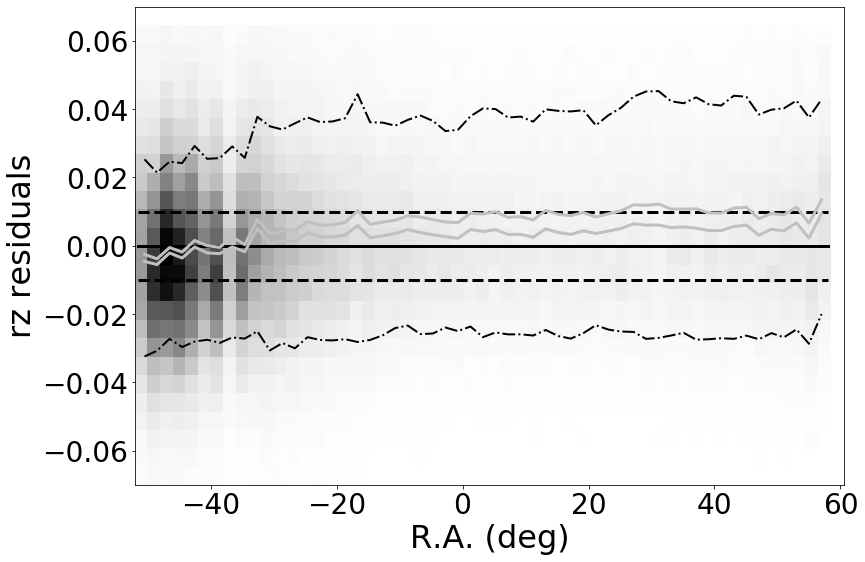

made plot colorResidGaiaColorsRecalib_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.003180253601072283 std.dev: 0.0013416752125505918
saved plot as: colorResidGaiaColorsRecalib_rz_Dec.png


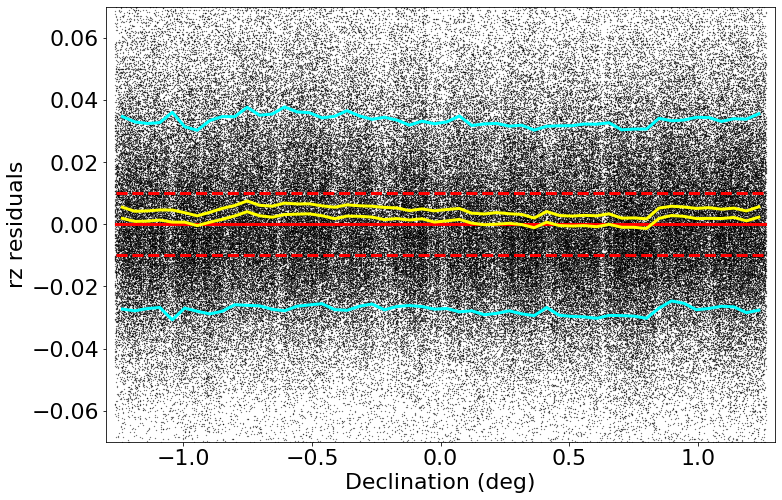

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0031829345703113243 std.dev: 0.0014193216500349136
saved plot as: colorResidGaiaColorsRecalib_rz_Dec_Hess.png


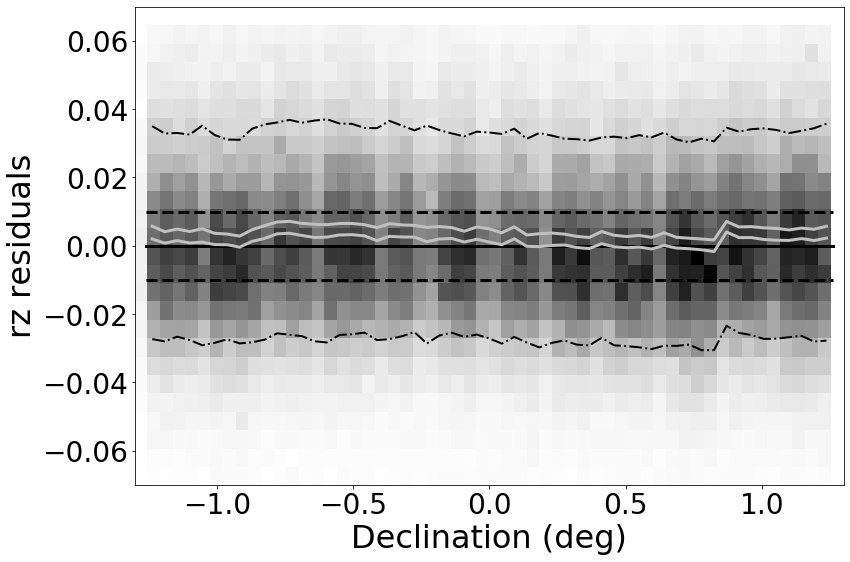

made plot colorResidGaiaColorsRecalib_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0016313934326215862 std.dev: 0.053178995570299425
saved plot as: colorResidGaiaColorsRecalib_rz_rmag.png


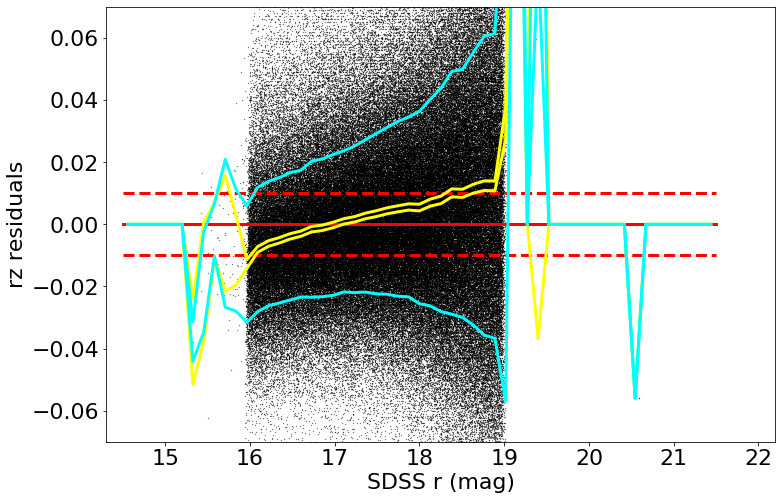

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0016313934326215862 std.dev: 0.053178995570299425
saved plot as: colorResidGaiaColorsRecalib_rz_rmag_Hess.png


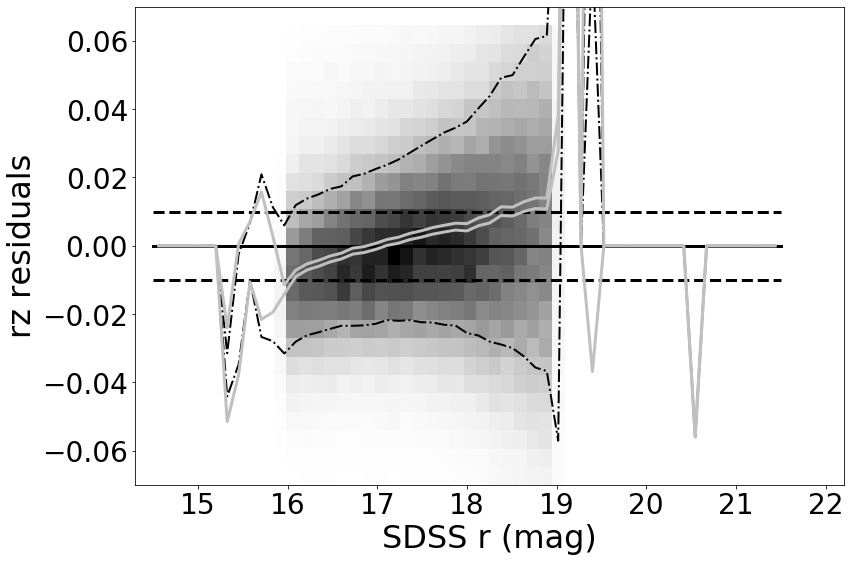

made plot colorResidGaiaColorsRecalib_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0035523681640637073 std.dev: 0.006479395498933692
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag.png


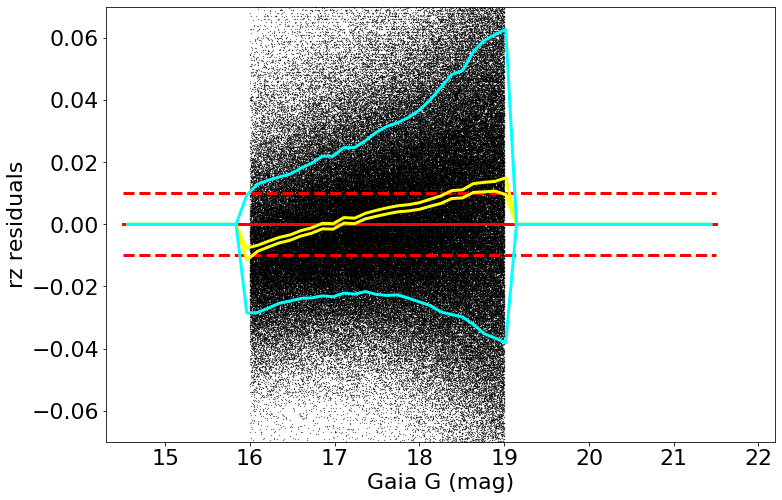

medianAll: 0.0029374427795405555 std.dev.All: 0.030519729172897442
N= 249908 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0035523681640637073 std.dev: 0.006479395498933692
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag_Hess.png


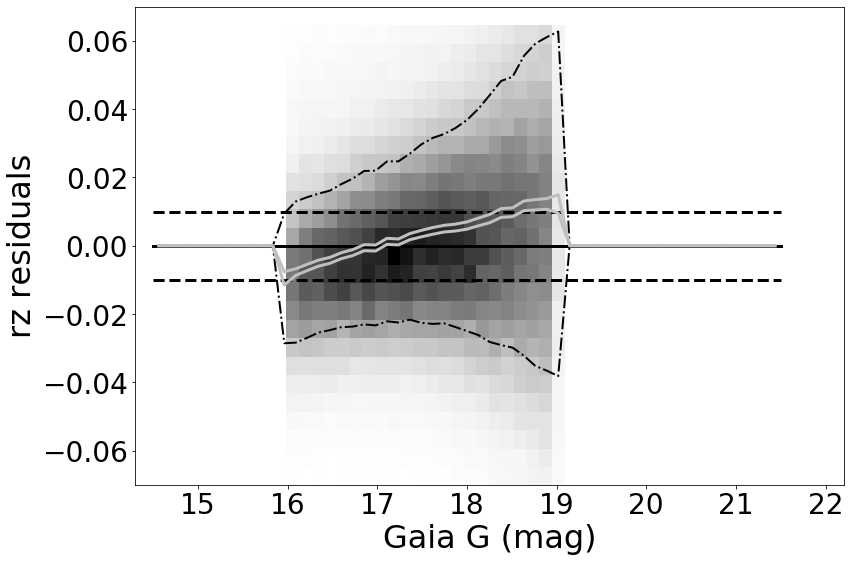

made plot colorResidGaiaColorsRecalib_rz_Gmag_Hess.png
------------------------------------------------------------------


In [50]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsRecalib_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [52]:
d = matchesUR
xVec = d['BR'] 
yVec = d['ur']
# 
xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
goodC = d[np.abs(d['colorresid'])<0.3]
# goodC['colorresid'] = goodC['colorresid'] - np.median(goodC['colorresid'])

medianAll: 0.006193145751952622 std.dev.All: 0.11751180656433015
N= 155549 min= -0.299906341552735 max= 0.29999369049072033
median: 0.006428802490234253 std.dev: 0.0022673901919623624
saved plot as: colorResidGaiaColorsB_urResiduals_Dec.png


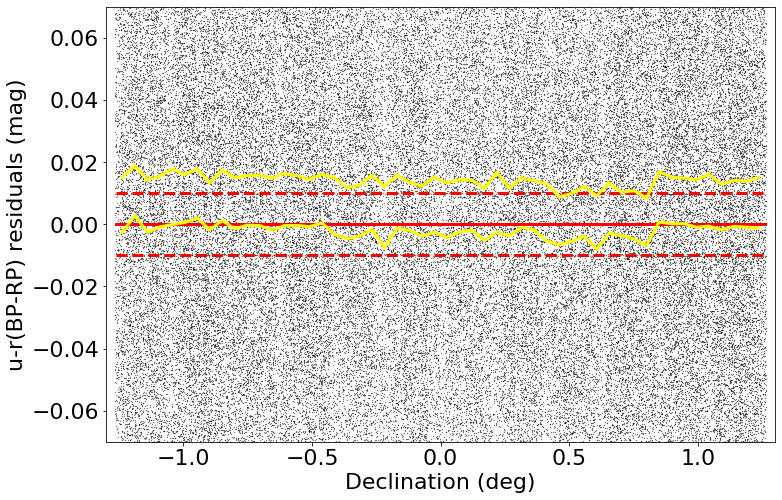

In [54]:
plotName = 'colorResidGaiaColorsB_urResiduals_Dec.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

medianAll: 0.006193145751952622 std.dev.All: 0.11751180656433015
N= 155549 min= -0.299906341552735 max= 0.29999369049072033
median: 0.017070182800292655 std.dev: 0.03612277501032324
saved plot as: colorResidGaiaColorsB_urResiduals_RA.png


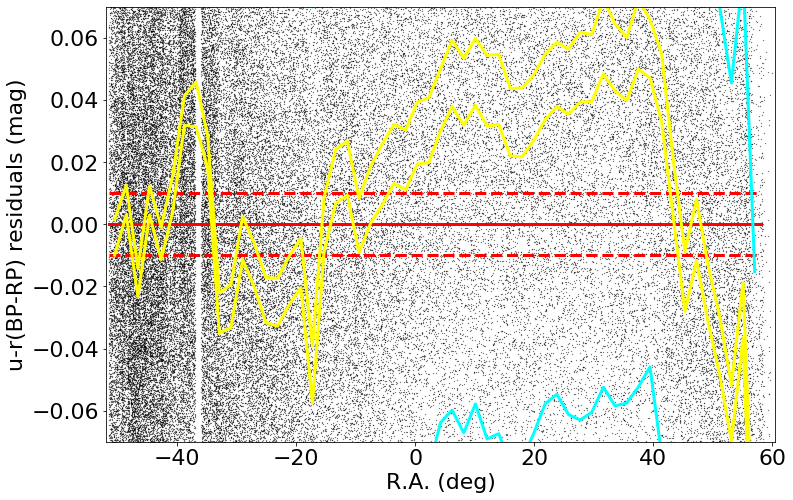

In [56]:
plotName = 'colorResidGaiaColorsB_urResiduals_RA.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

In [58]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
np.savetxt('ZPcorrectionsDec_ur_v4.2_final.dat', (xBin, medianBin)) 

median: 0.006428802490234253 std.dev: 0.0022673901919623624


In [60]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
# we cannot confirm the RA behavior with CFIS data: it's better to leave it as it is
medianBin = 0.0*medianBin
np.savetxt('ZPcorrectionsRA_ur_v4.2_final.dat', (xBin, medianBin)) 

median: 0.017070182800292655 std.dev: 0.03612277501032324


In [61]:
d = matchesRecalib  
xVec = d['BR'] 
for color in ('gr', 'ri', 'rz'):
    yVec = d[color]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
    d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
    goodC = d[np.abs(d['colorresid'])<0.1]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
    fname = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
    fname = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 

median: -0.006402973175049578 std.dev: 0.0007177479457615852
median: -0.005850028991699591 std.dev: 0.0009406258613340279
median: -0.005234272003172155 std.dev: 0.0003257541878965239
median: -0.005523757934568815 std.dev: 0.0005940991625391414
median: -0.009671421051025475 std.dev: 0.00046026208483380835
median: -0.010453872680662744 std.dev: 0.0014527593879734627


In [62]:
sdssOut = sdss[sdss['ra_new']<1000] 
print(np.size(sdssOut))

991472


In [63]:
decGrid2correct = sdssOut['dec_new']
# RA correction 
ra = sdssOut['ra_new'] 
raWGrid2correct = np.where(ra > 180, ra-360, ra) 

In [64]:
print('ENTRIES FOR TABLE 1:')
## apply color corrections 
for mtype in ('_mMed_new', '_mMean_new'):
    ## u band from u-r color
    color = 'ur'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('u-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'u' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## g band from g-r color
    color = 'gr'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('g-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'g' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## i band from r-i color
    color = 'ri'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'i' + mtype
    print('r-i std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 
    ## i band from r-z color
    color = 'rz'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'z' + mtype
    print('r-z std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 

ENTRIES FOR TABLE 1:
u-r std RA/Dec: 0.0 0.001994355213488368
g-r std RA/Dec: 0.0008430156663108777 0.0006700741874821364
r-i std RA/Dec: 0.0004972071838567694 0.00026247178133583806
r-z std RA/Dec: 0.0012676756774017794 0.00039696618787137786
u-r std RA/Dec: 0.0 0.001994355213488368
g-r std RA/Dec: 0.0008430156663108777 0.0006700741874821364
r-i std RA/Dec: 0.0004972071838567694 0.00026247178133583806
r-z std RA/Dec: 0.0012676756774017794 0.00039696618787137786


In [65]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla_new'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i)
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v4.2temp_noheader_final.dat


<a id='dataReading'></a>

### Test v4.2

In [66]:
# Karun's new catalog from 2020, after Gmag-based gray and BP-RP color corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [67]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [68]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [69]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013497274780272739 std.dev: 0.013825816148070477
saved plot as: colorResidGaiaColors_ur_RA.png


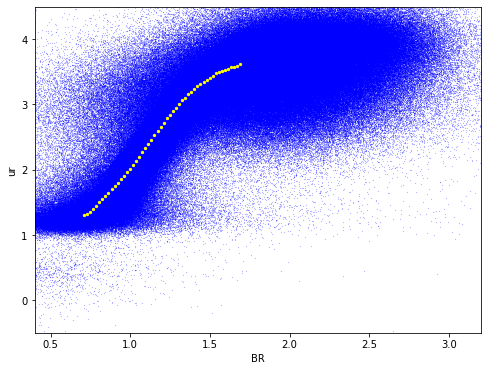

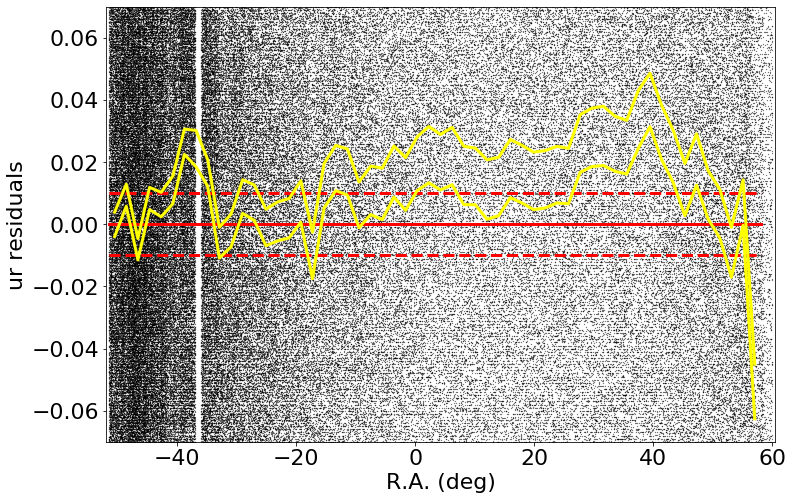

medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013999999999999346 std.dev: 0.013878635750381093
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


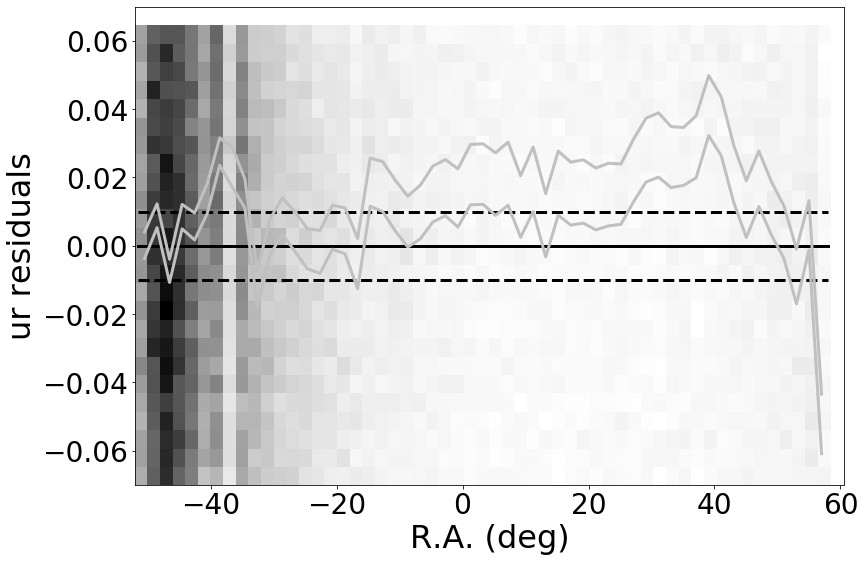

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.008999999999997677 std.dev: 0.0030139120003564624
saved plot as: colorResidGaiaColors_ur_Dec.png


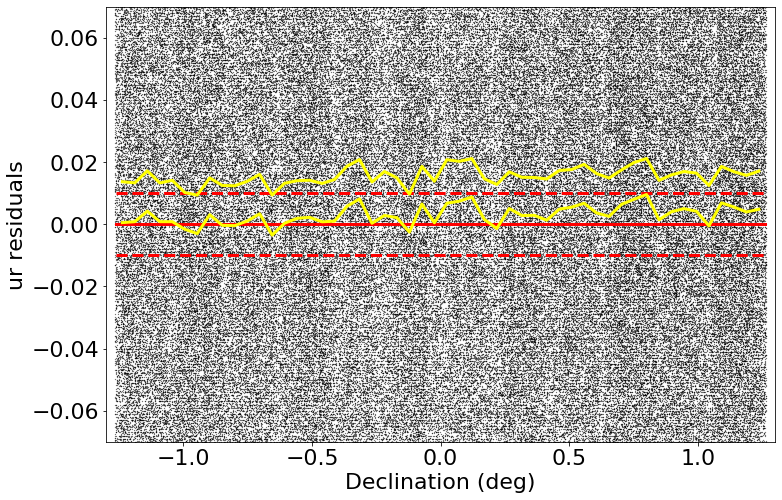

medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009000000000000341 std.dev: 0.003615748449200604
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


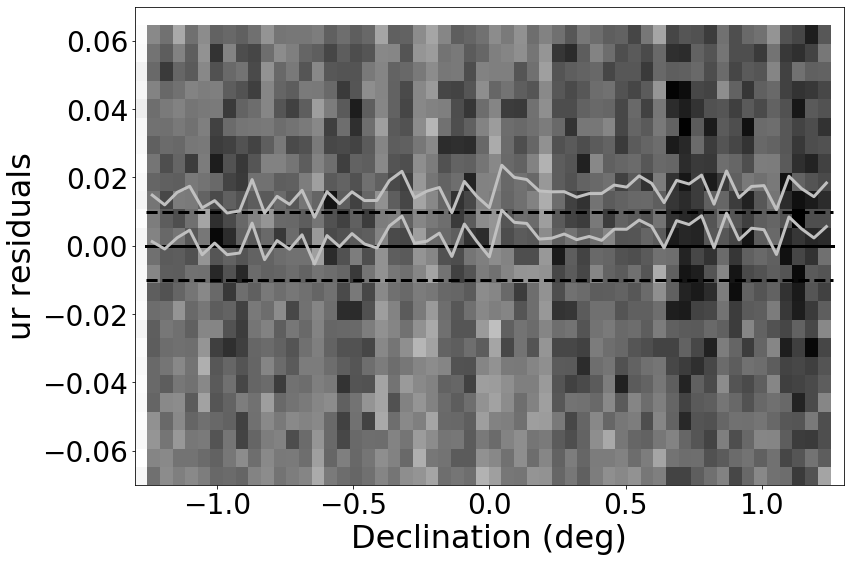

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0020953903198256407 std.dev: 0.05249067855086685
saved plot as: colorResidGaiaColors_ur_rmag.png


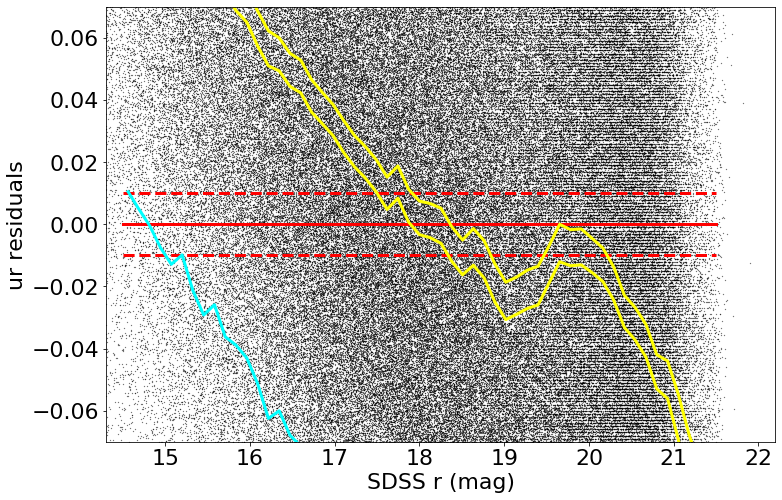

medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0020953903198256407 std.dev: 0.05249067855086685
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


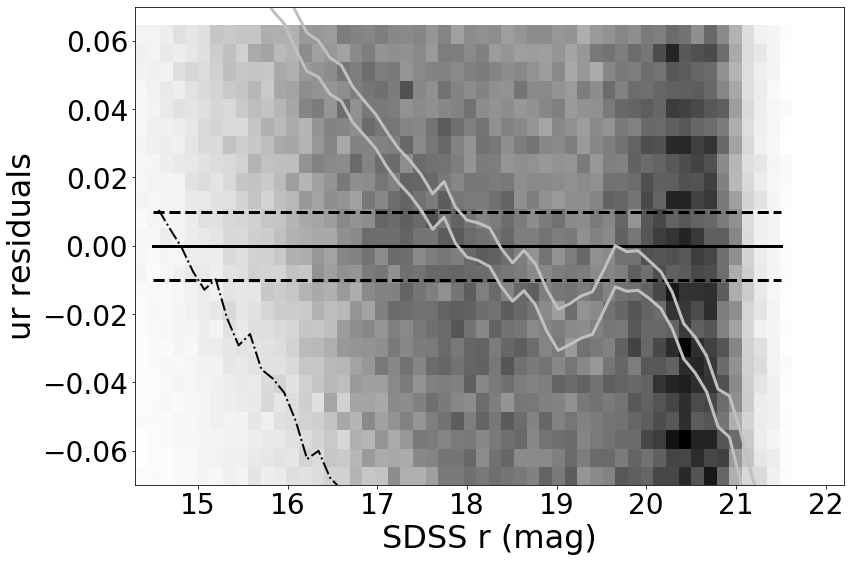

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009071813964840247 std.dev: 0.05372705653454041
saved plot as: colorResidGaiaColors_ur_Gmag.png


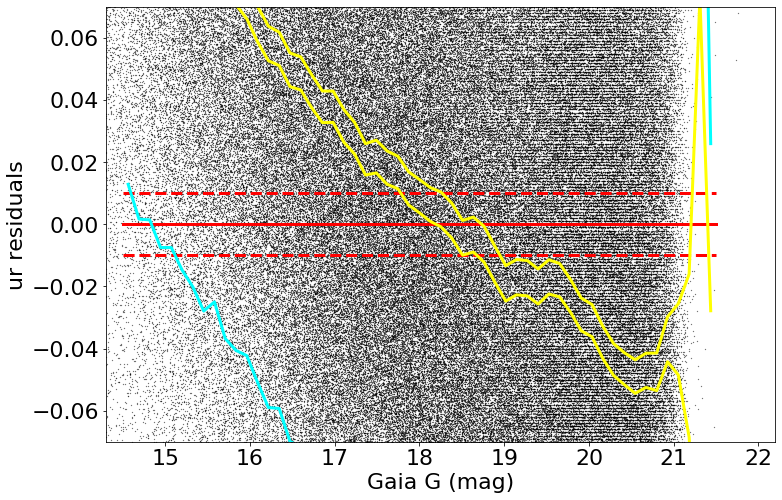

medianAll: 0.00917364807128851 std.dev.All: 0.1697658984237719
N= 545140 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009071813964840247 std.dev: 0.05372705653454041
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


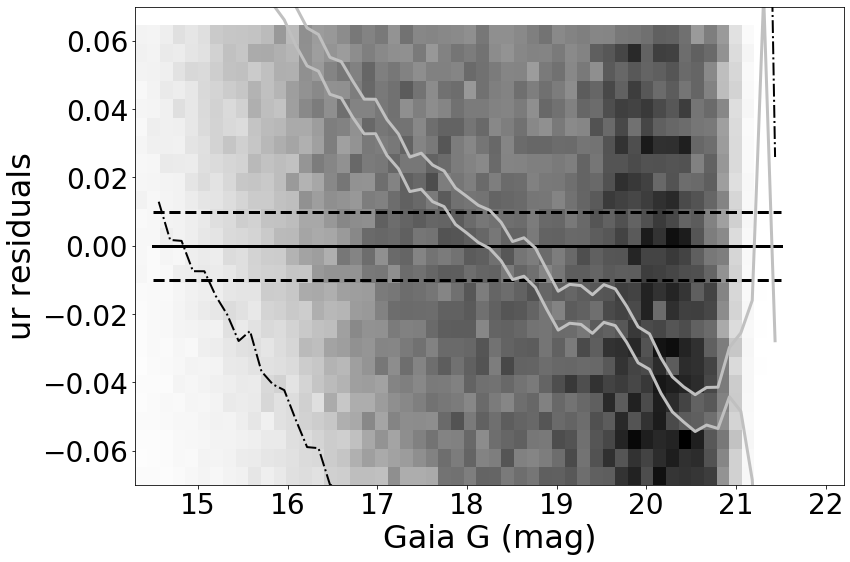

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.02045709991455058 std.dev: 0.0109066061183009
saved plot as: colorResidGaiaColors_gr_RA.png


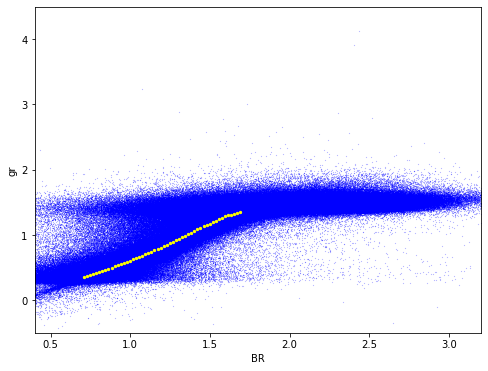

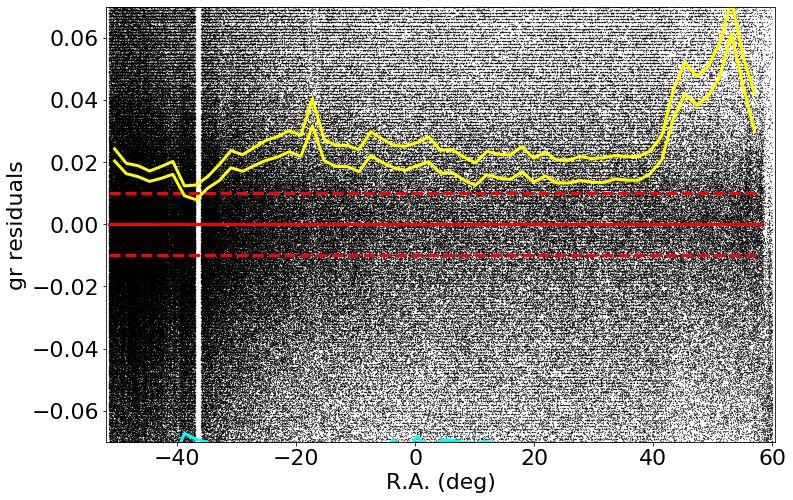

medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.020753369140622036 std.dev: 0.010840157628396825
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


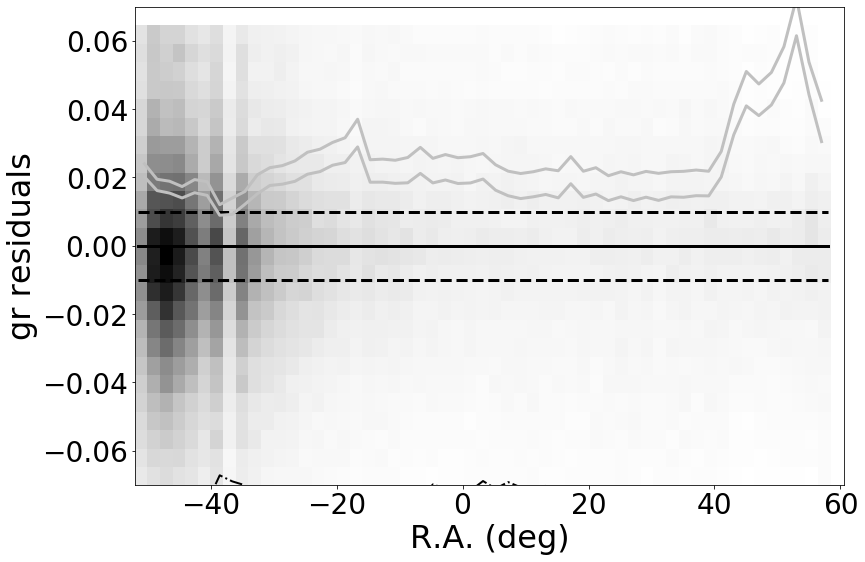

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.020105969810486124 std.dev: 0.003208442791100987
saved plot as: colorResidGaiaColors_gr_Dec.png


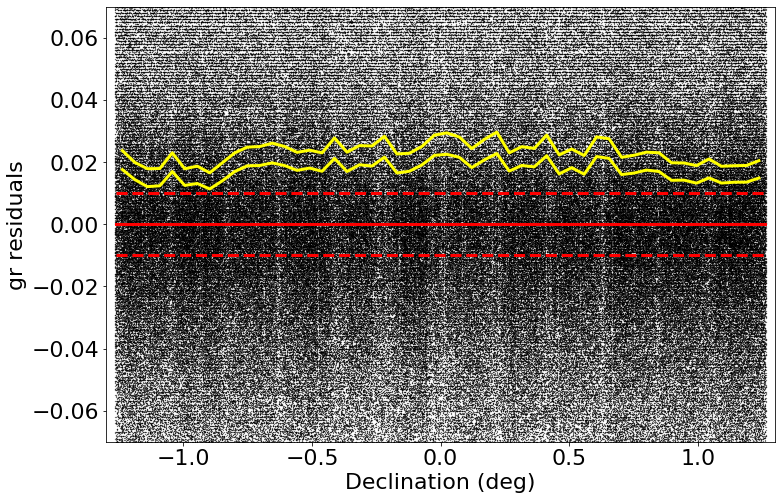

medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.020464107513429752 std.dev: 0.003312521370390201
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


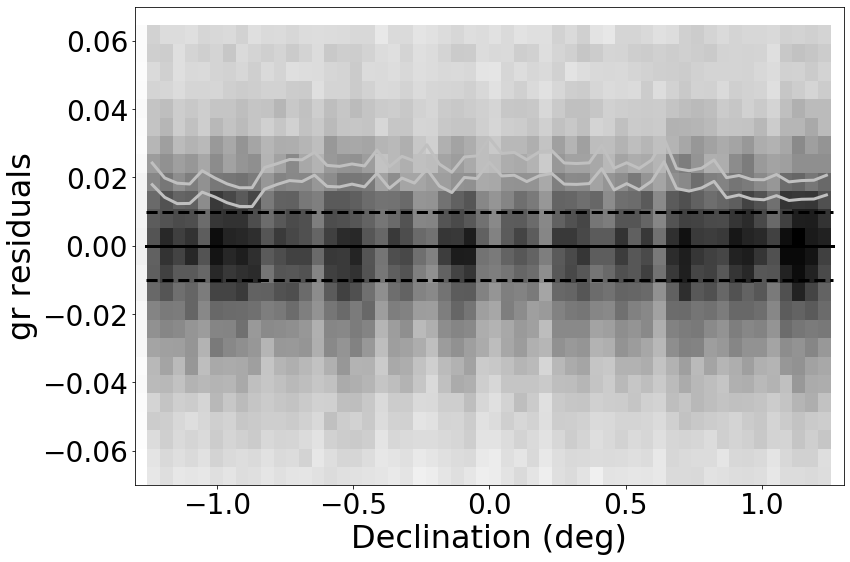

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.002678150939939339 std.dev: 0.0435484485319078
saved plot as: colorResidGaiaColors_gr_rmag.png


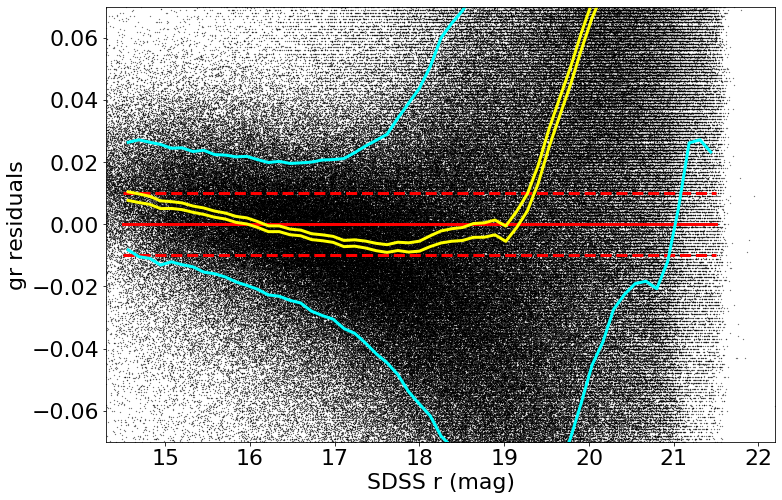

medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.002678150939939339 std.dev: 0.0435484485319078
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


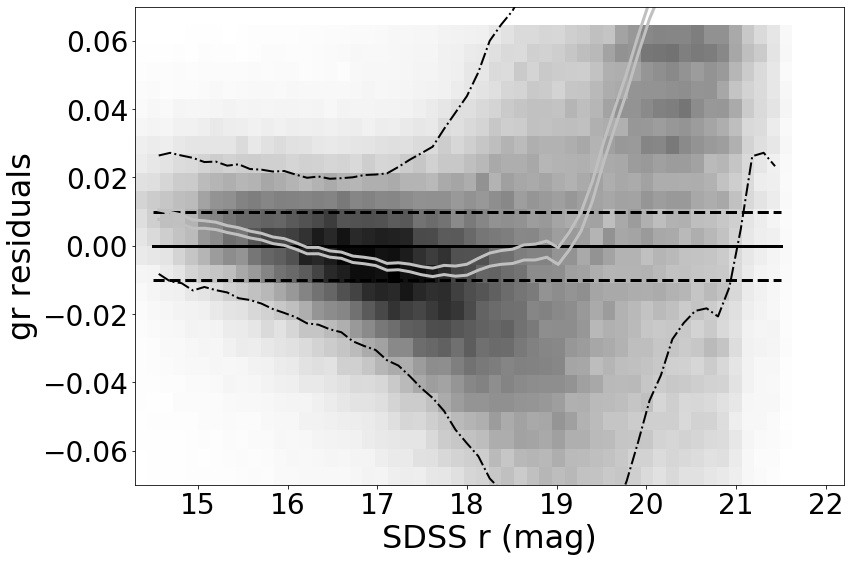

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005468081665039204 std.dev: 0.034341581578133065
saved plot as: colorResidGaiaColors_gr_Gmag.png


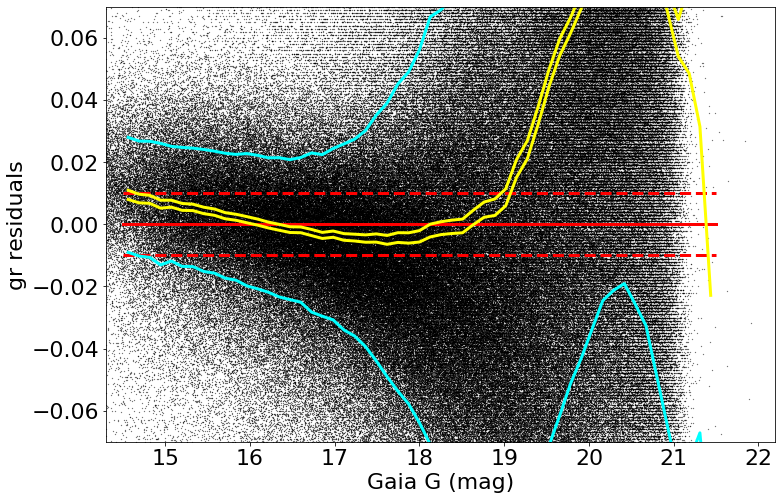

medianAll: 0.01999999999999602 std.dev.All: 0.09929400000000288
N= 820498 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005468081665039204 std.dev: 0.034341581578133065
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


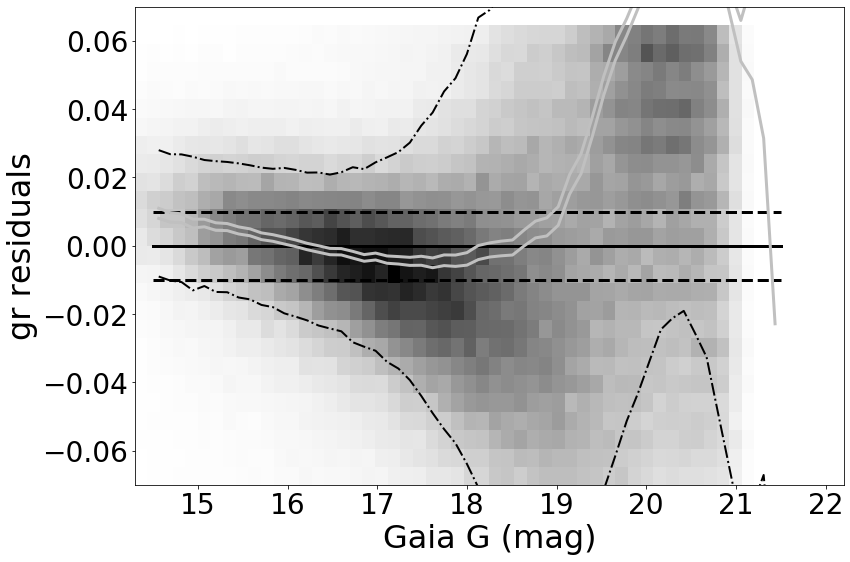

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.00018256530761724676 std.dev: 0.0011032029516665684
saved plot as: colorResidGaiaColors_ri_RA.png


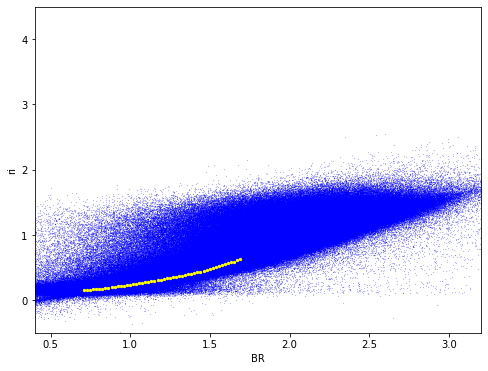

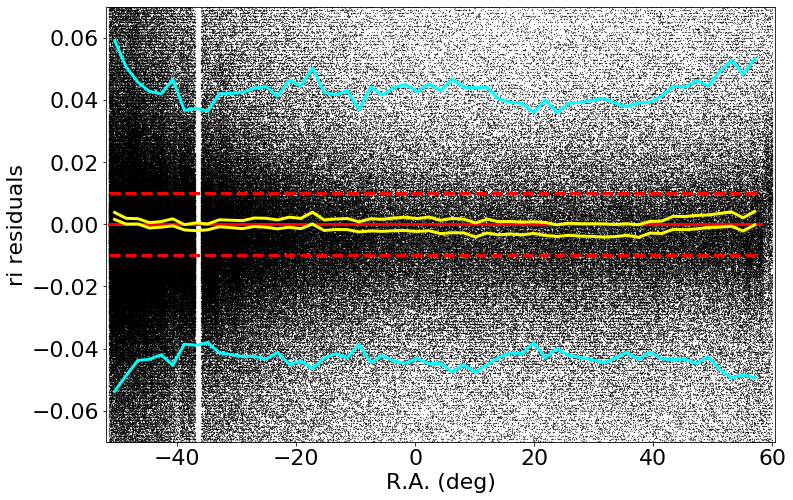

medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.00015452728271686533 std.dev: 0.0011550452962530602
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


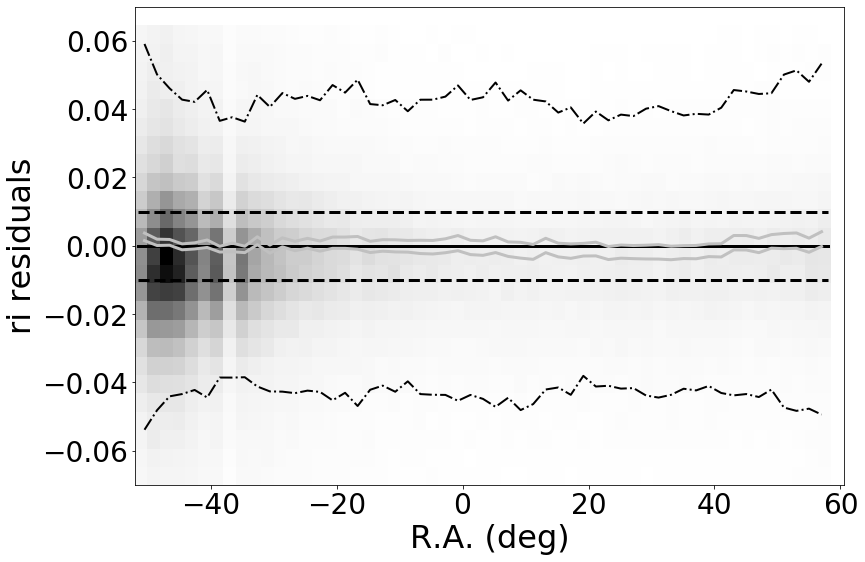

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: 3.847198486287701e-05 std.dev: 0.0005586337636336892
saved plot as: colorResidGaiaColors_ri_Dec.png


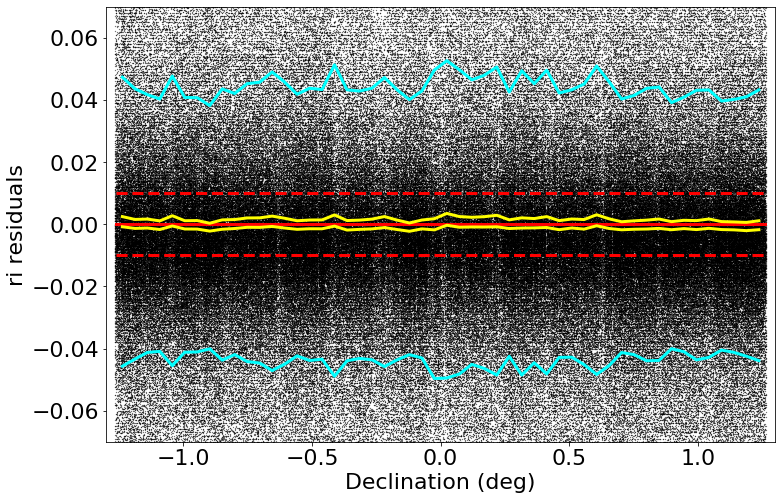

medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: 7.11517333991385e-05 std.dev: 0.0006097619502172374
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


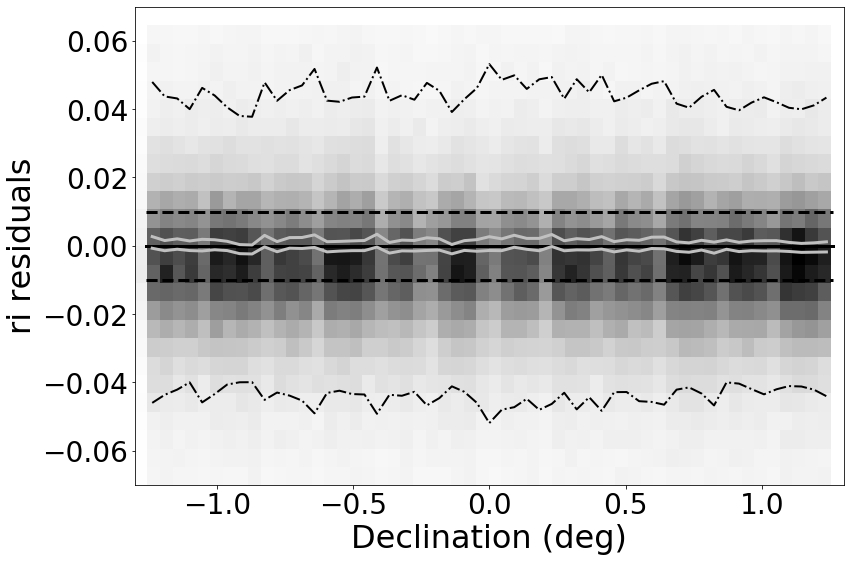

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.003543065643311555 std.dev: 0.04899524435793558
saved plot as: colorResidGaiaColors_ri_rmag.png


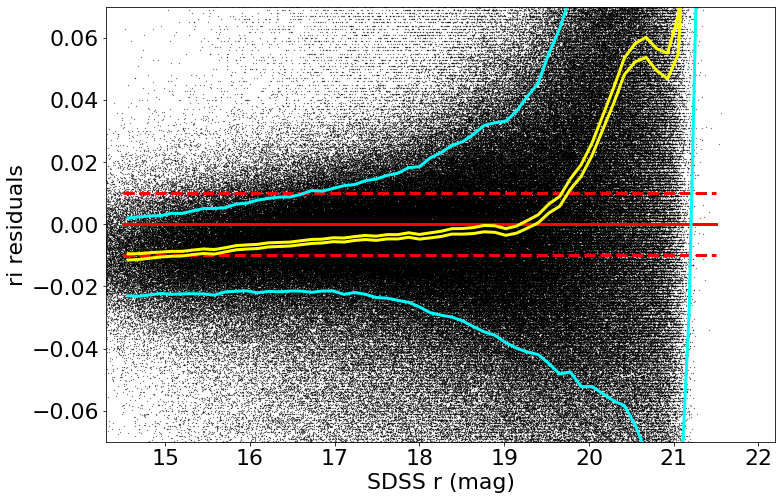

medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.003543065643311555 std.dev: 0.04899524435793558
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


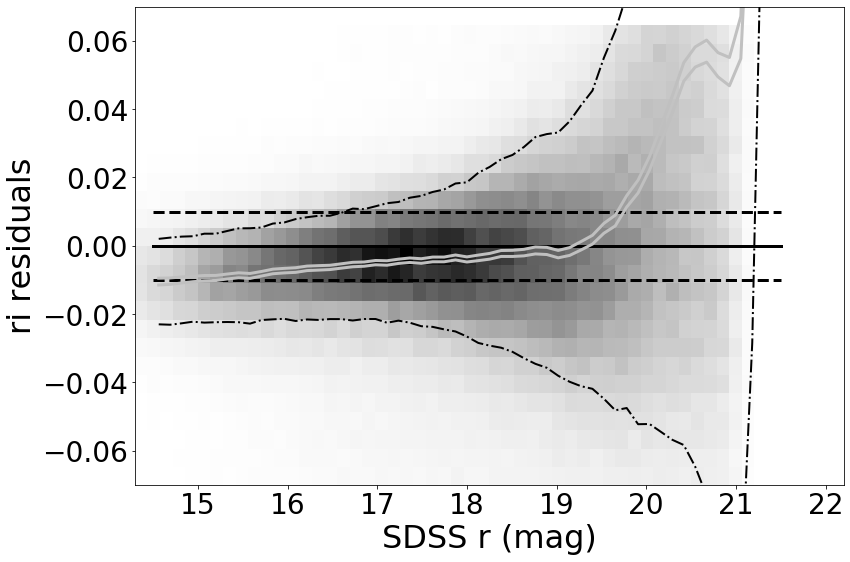

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.0035256607055678957 std.dev: 0.021145880023136034
saved plot as: colorResidGaiaColors_ri_Gmag.png


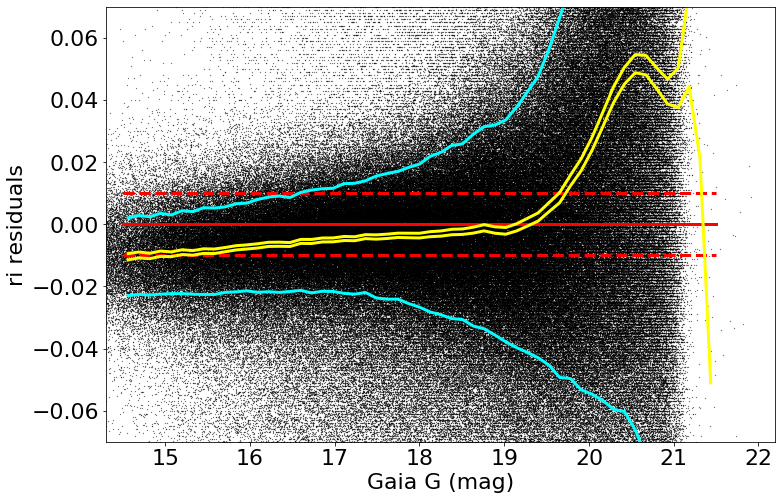

medianAll: 9.458312987986606e-05 std.dev.All: 0.043928830902100154
N= 640435 min= -0.29999999999999716 max= 0.29999999999999716
median: -0.0035256607055678957 std.dev: 0.021145880023136034
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


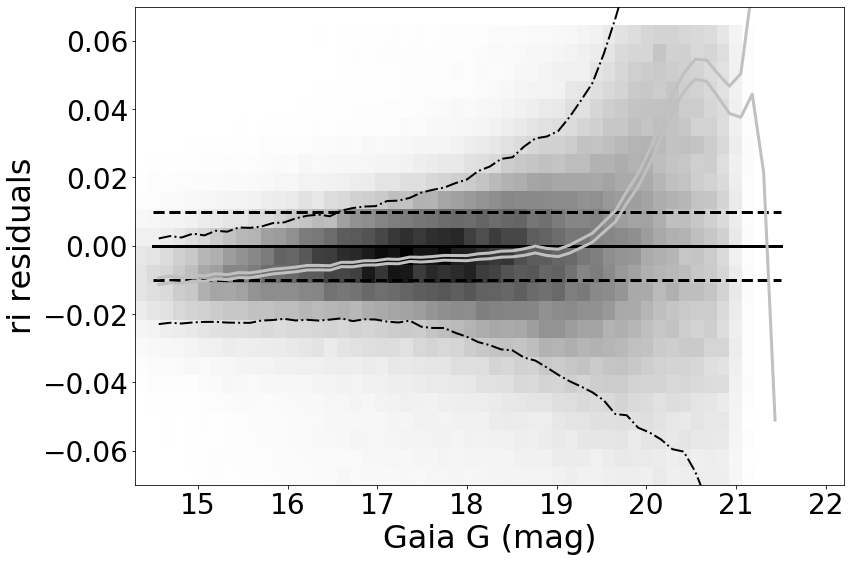

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.004591859626771291 std.dev: 0.0010867663846308598
saved plot as: colorResidGaiaColors_rz_RA.png


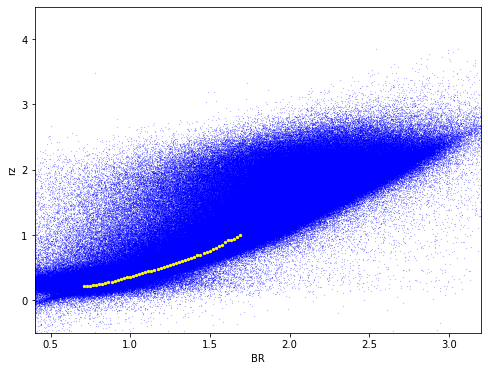

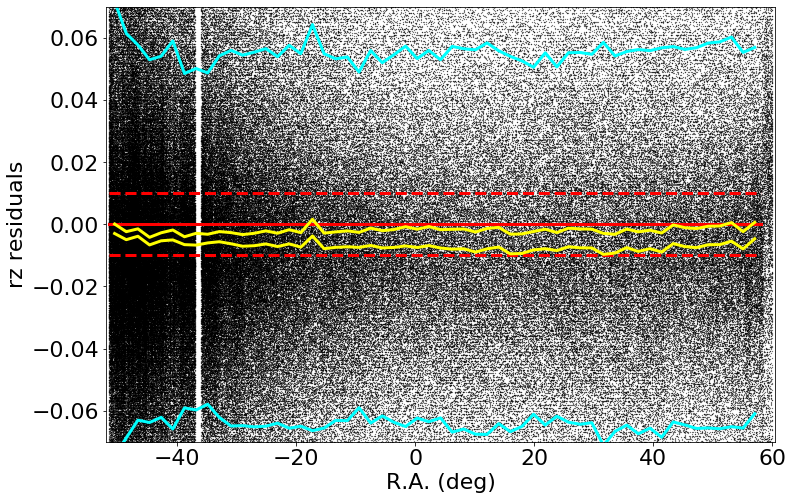

medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.004408857727050797 std.dev: 0.0012028074923107687
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


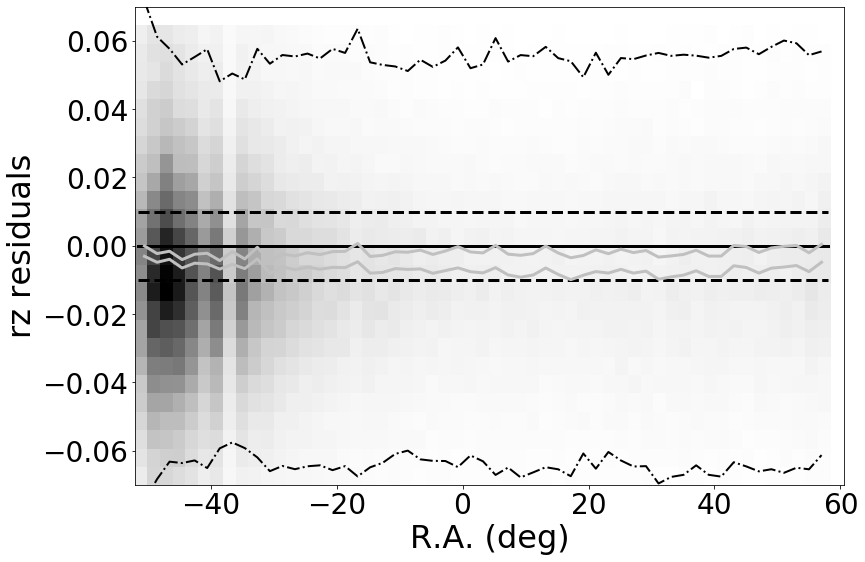

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.004000000000003112 std.dev: 0.0007303594926757793
saved plot as: colorResidGaiaColors_rz_Dec.png


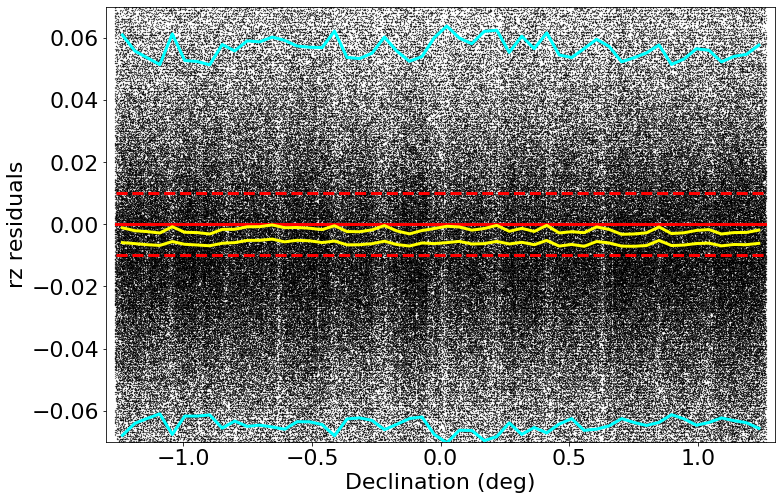

medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.004231696319579675 std.dev: 0.0008457610303379218
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


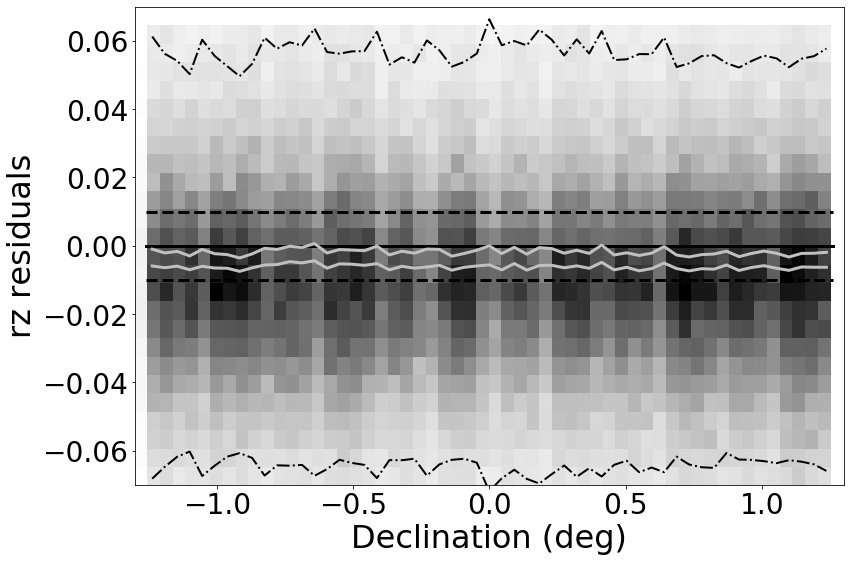

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007618406677246087 std.dev: 0.05010900528433567
saved plot as: colorResidGaiaColors_rz_rmag.png


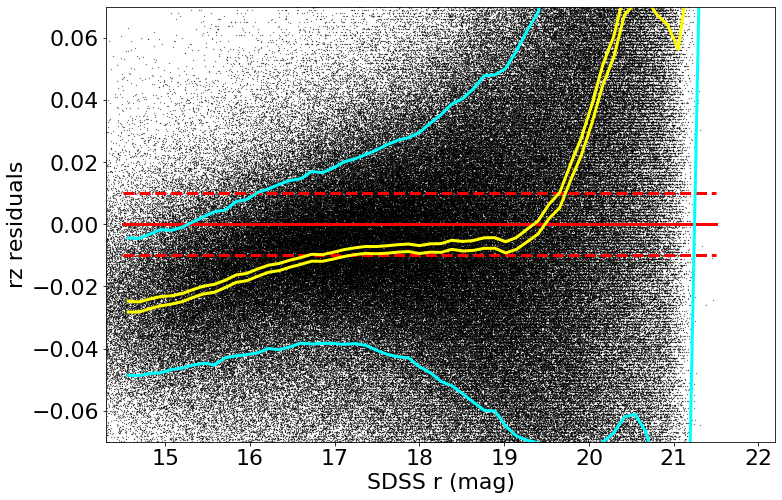

medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007618406677246087 std.dev: 0.05010900528433567
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


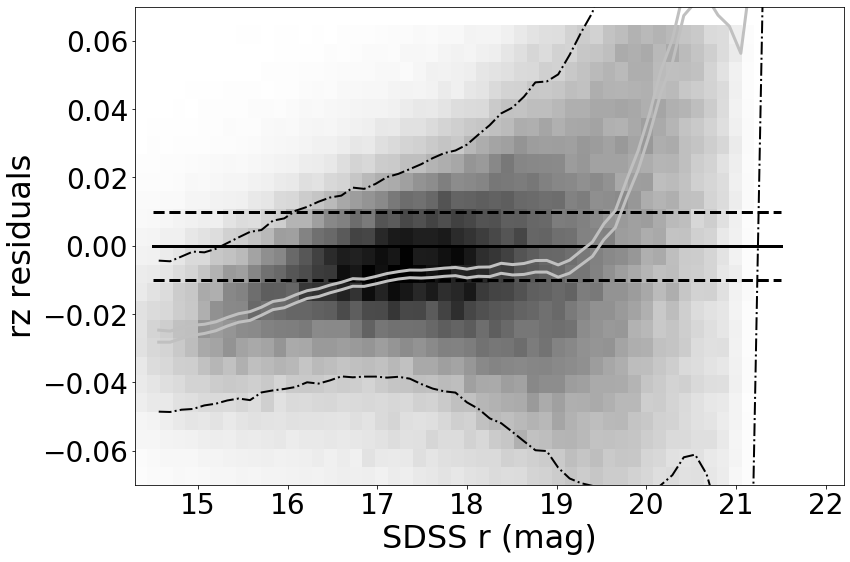

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007456567382813306 std.dev: 0.0305073710420288
saved plot as: colorResidGaiaColors_rz_Gmag.png


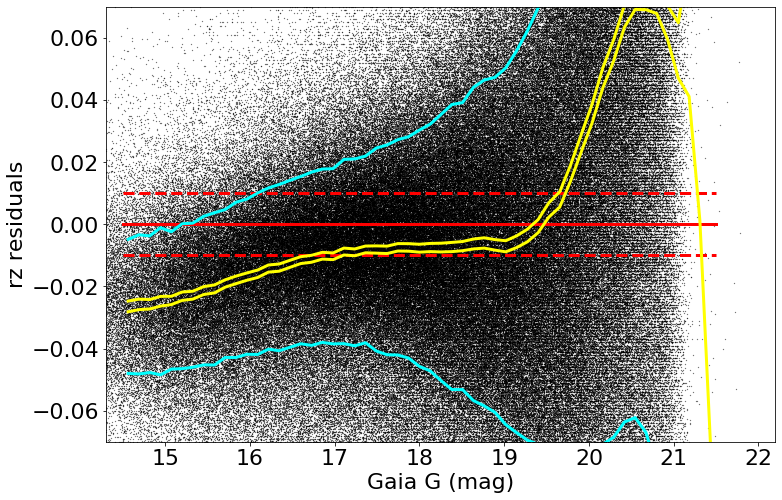

medianAll: -0.0040000000000048885 std.dev.All: 0.06047337679138075
N= 585611 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007456567382813306 std.dev: 0.0305073710420288
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


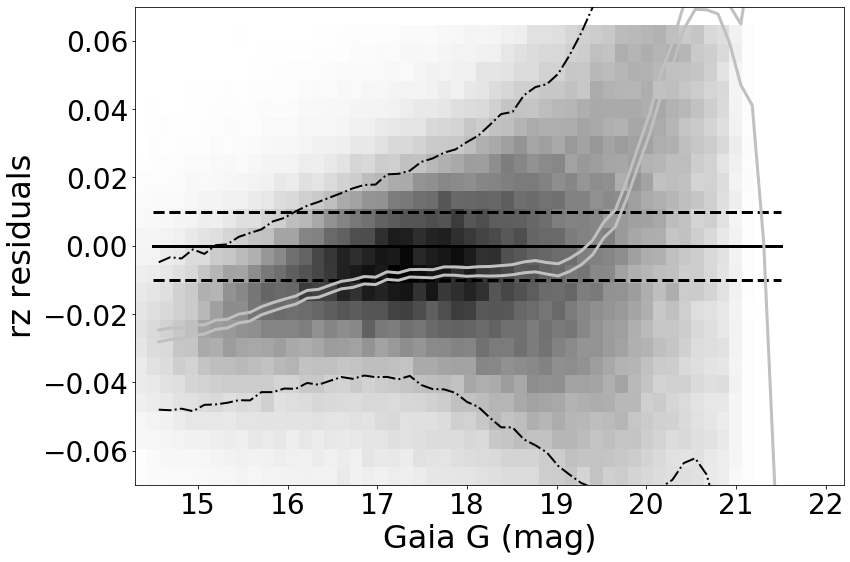

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [70]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [71]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesRecalib = matchesB[(matchesB['BR']>0.7)&(matchesB['BR']<1.7)]
matchesRecalibUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matches), np.size(matches), np.size(matchesRecalib), np.size(matchesRecalibUR))

905428 905428 217883 110233


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: 0.011482818603515188 std.dev: 0.03394609620533003
saved plot as: colorResidGaiaColors_ur_RA.png


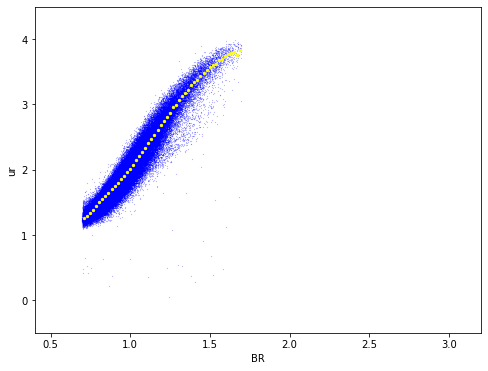

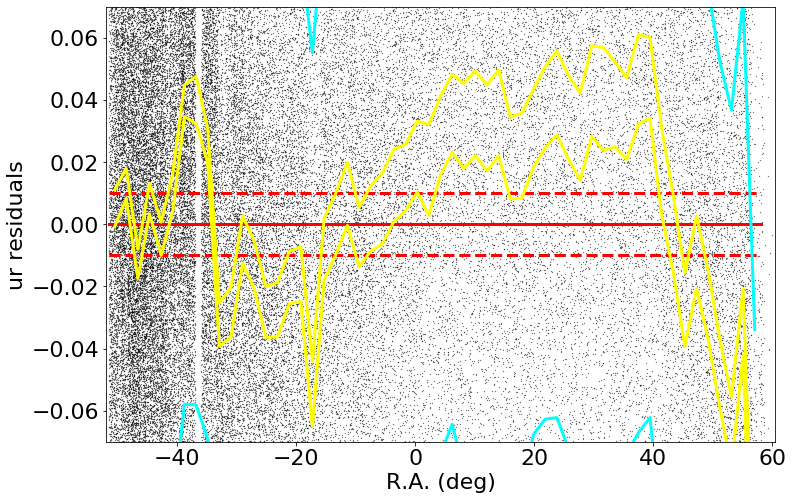

medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: 0.011773005676267045 std.dev: 0.03415638032414078
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


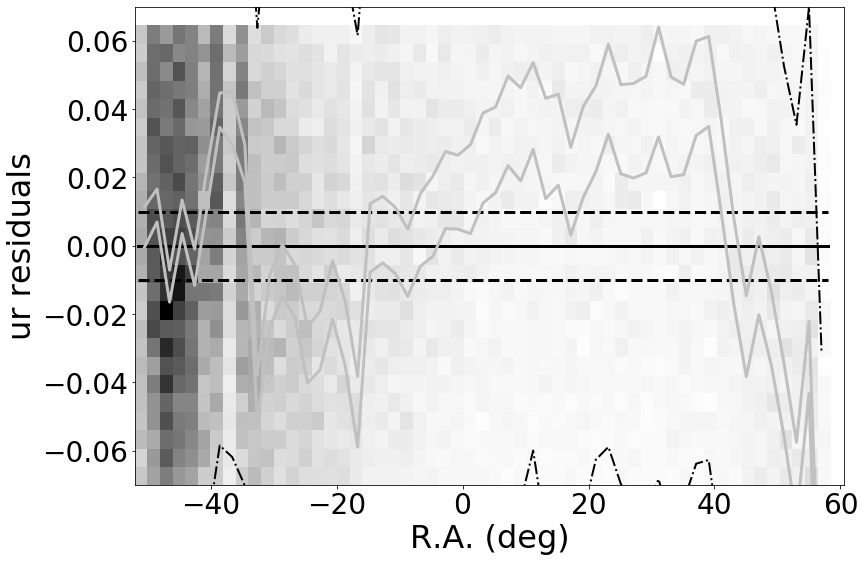

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: 0.0010180885314925447 std.dev: 0.005460936131279691
saved plot as: colorResidGaiaColors_ur_Dec.png


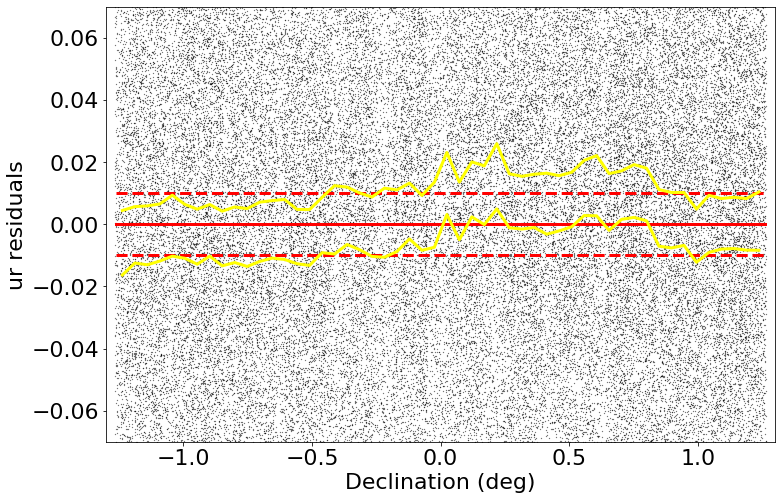

medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: 0.0010563354492162391 std.dev: 0.005919065651704353
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


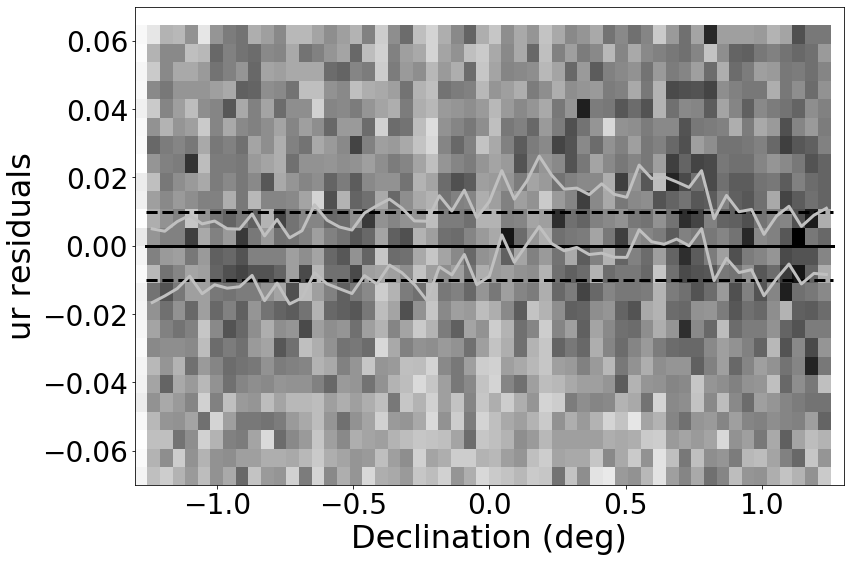

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: -0.004831060028076095 std.dev: 0.0630519890529165
saved plot as: colorResidGaiaColors_ur_rmag.png


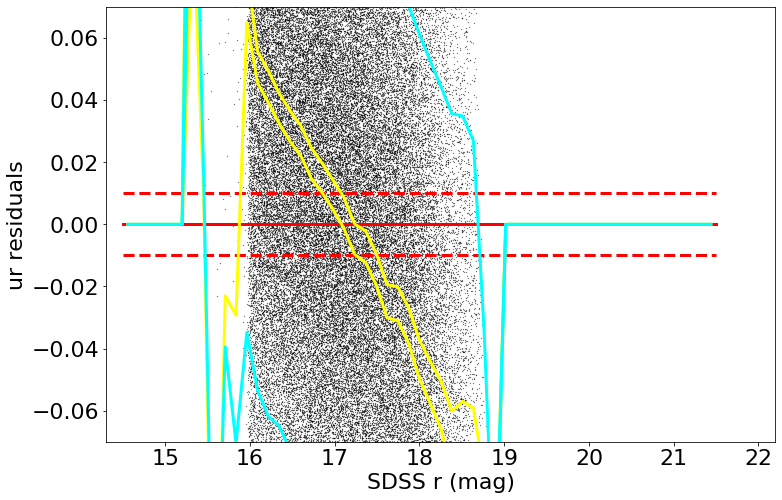

medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: -0.004831060028076095 std.dev: 0.0630519890529165
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


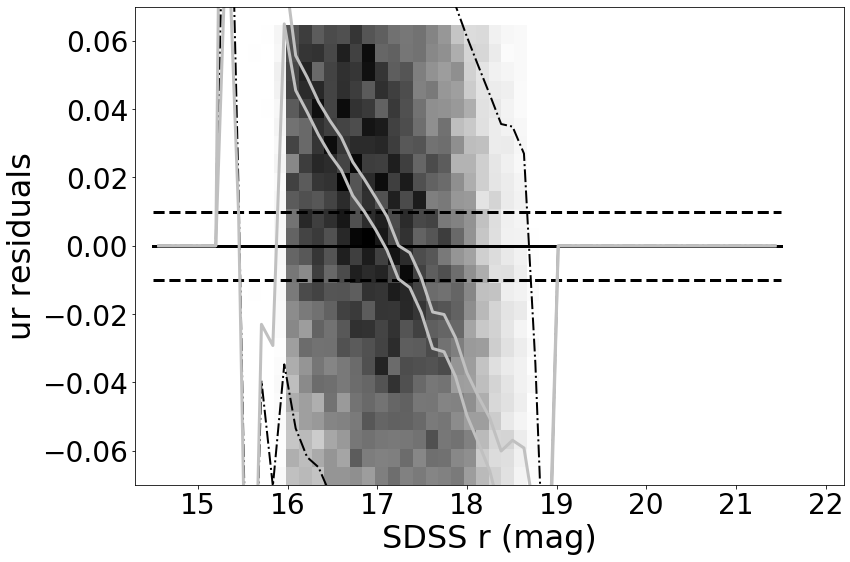

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: -0.007461249542237258 std.dev: 0.05141020031504029
saved plot as: colorResidGaiaColors_ur_Gmag.png


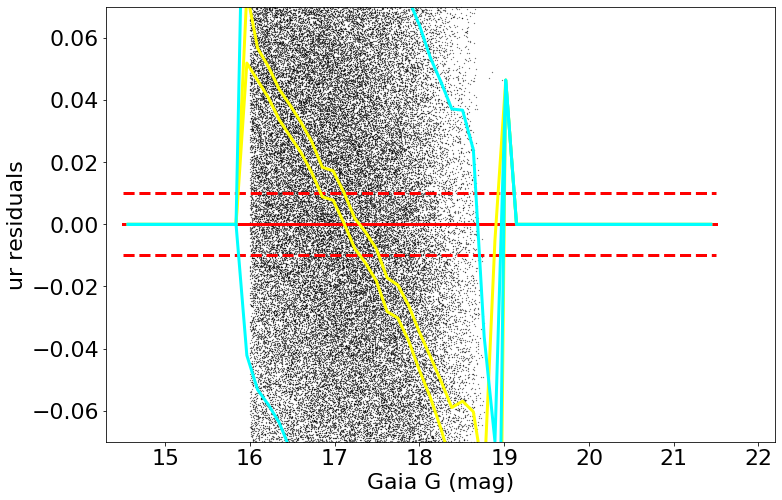

medianAll: 0.0024018386840825023 std.dev.All: 0.10911751555938745
N= 105901 min= -0.29997908172607457 max= 0.29996981811523415
median: -0.007461249542237258 std.dev: 0.05141020031504029
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


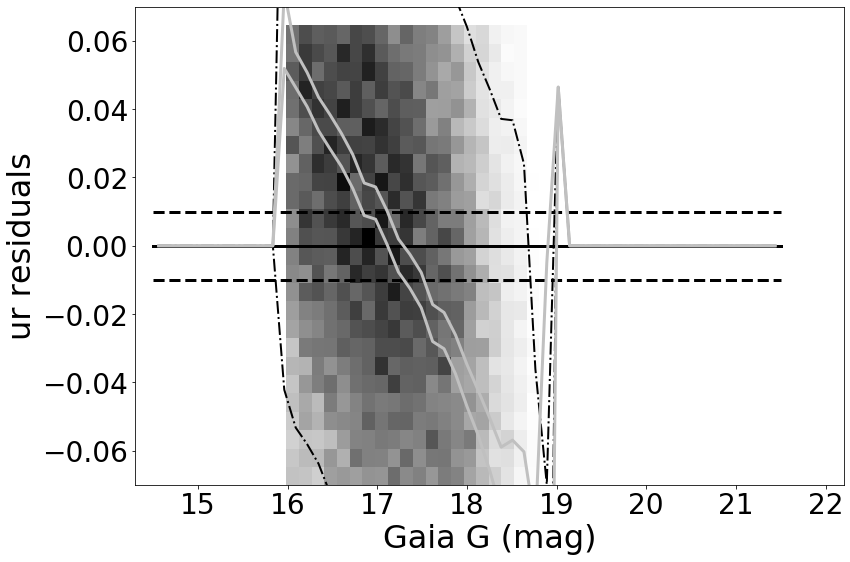

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------


In [72]:
keywords["Ystr"] = 'ur'
doOneColorGaiaBR(matchesRecalibUR, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: 0.0004804962158194426 std.dev: 0.001131308921458173
saved plot as: colorResidGaiaColors_gr_RA.png


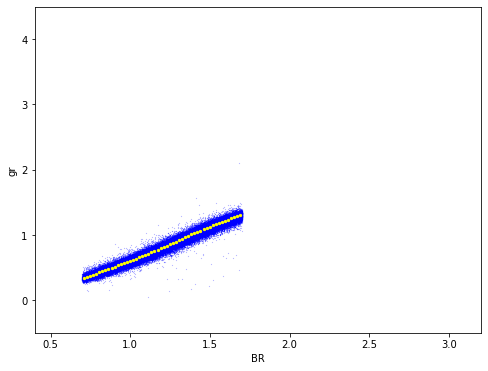

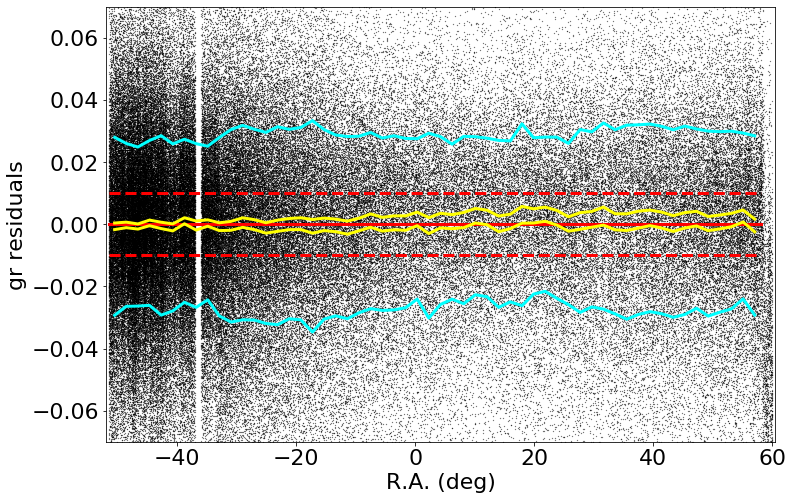

medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: 0.00046020507812638556 std.dev: 0.001241637533914263
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


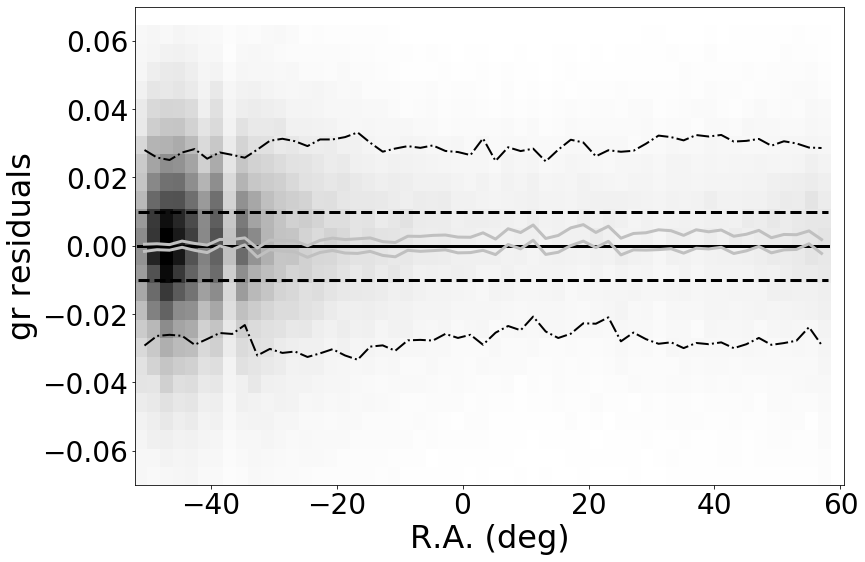

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: 2.263355254994437e-05 std.dev: 0.0009230481500044912
saved plot as: colorResidGaiaColors_gr_Dec.png


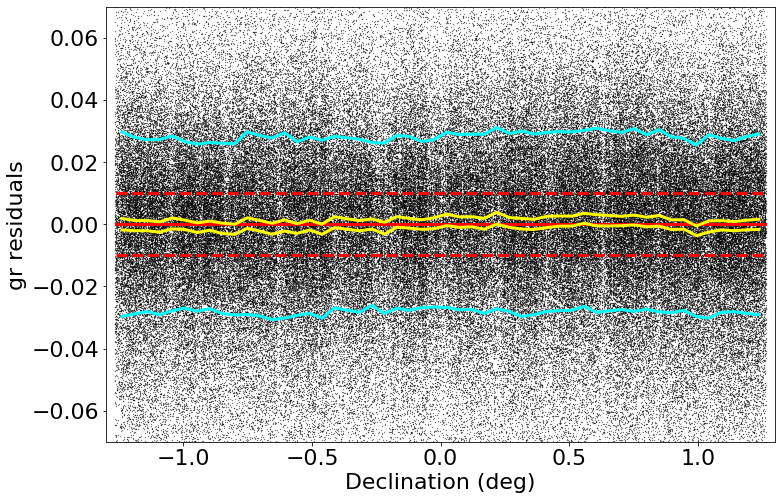

medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: 0.00011476593017645254 std.dev: 0.0009351052960777775
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


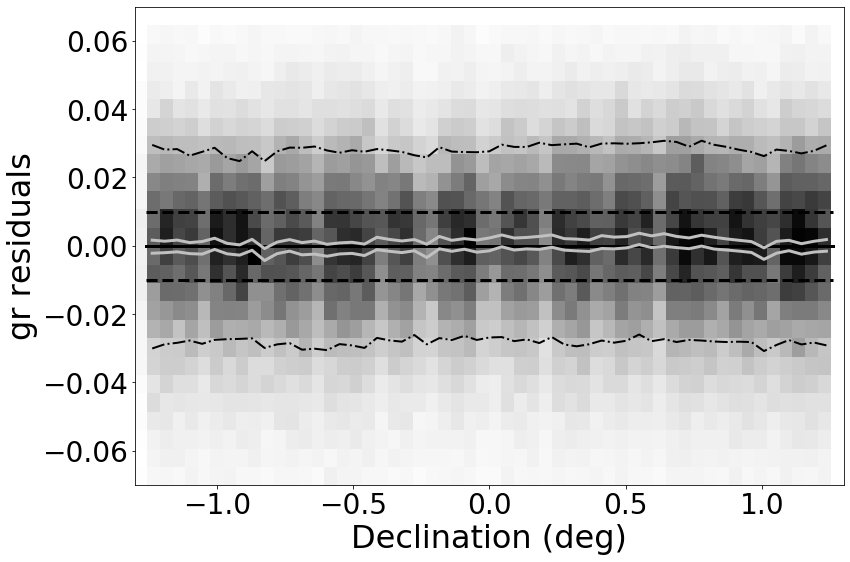

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: -0.0005222518920869335 std.dev: 0.04590262835327171
saved plot as: colorResidGaiaColors_gr_rmag.png


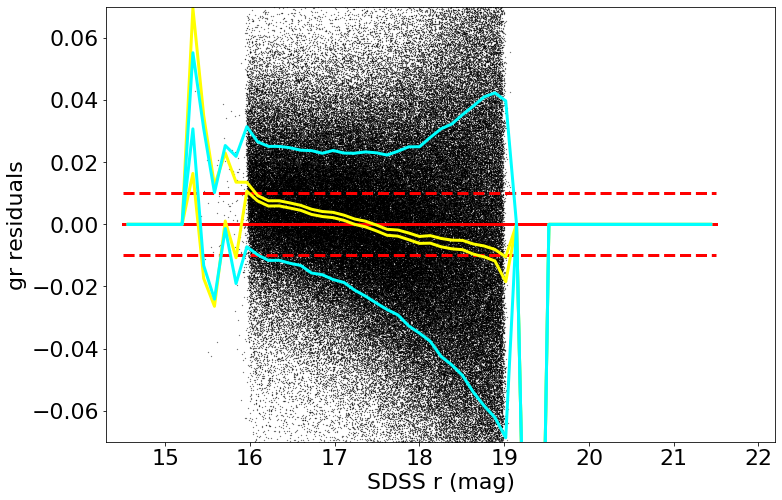

medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: -0.0005222518920869335 std.dev: 0.04590262835327171
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


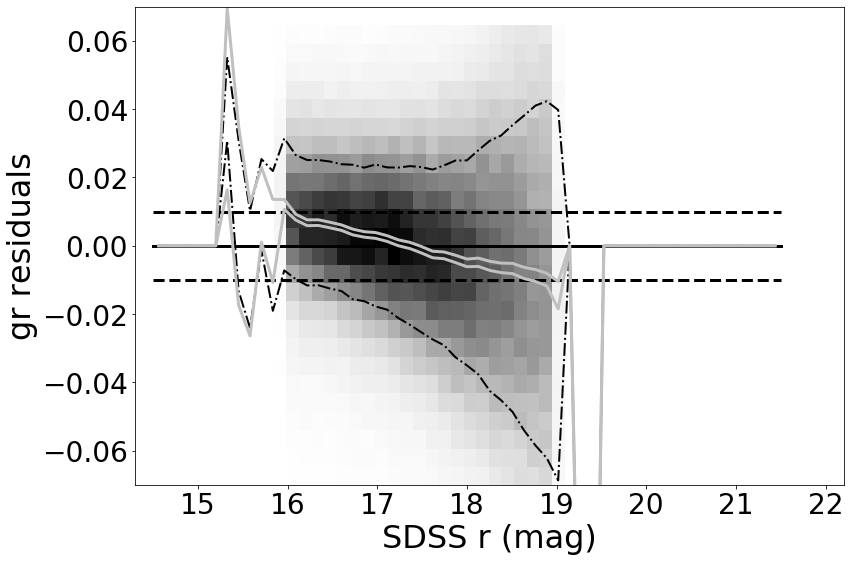

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: -0.0006945144653311974 std.dev: 0.006011109449916602
saved plot as: colorResidGaiaColors_gr_Gmag.png


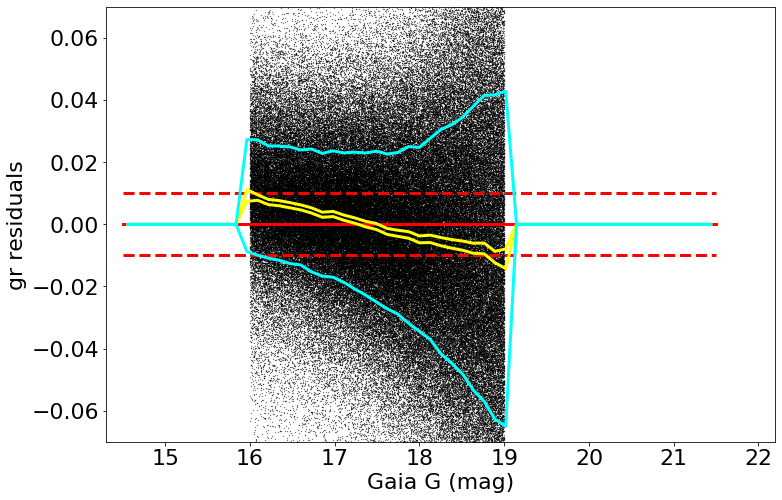

medianAll: 3.878326415884814e-05 std.dev.All: 0.028326129017257305
N= 217828 min= -0.29771077423095793 max= 0.2769942382812508
median: -0.0006945144653311974 std.dev: 0.006011109449916602
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


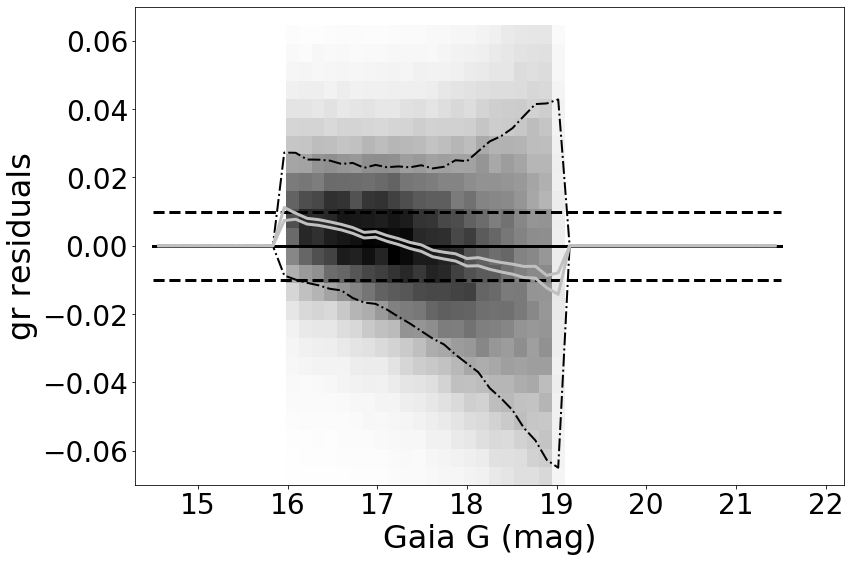

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: 0.0013926193237305332 std.dev: 0.0021261145609915866
saved plot as: colorResidGaiaColors_ri_RA.png


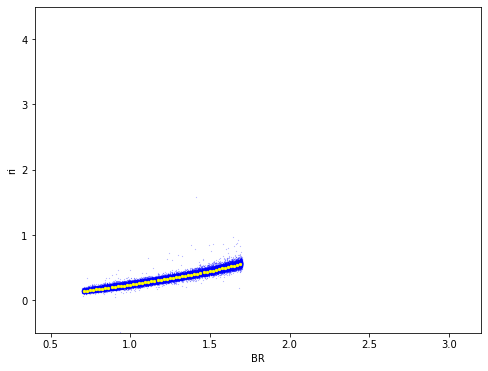

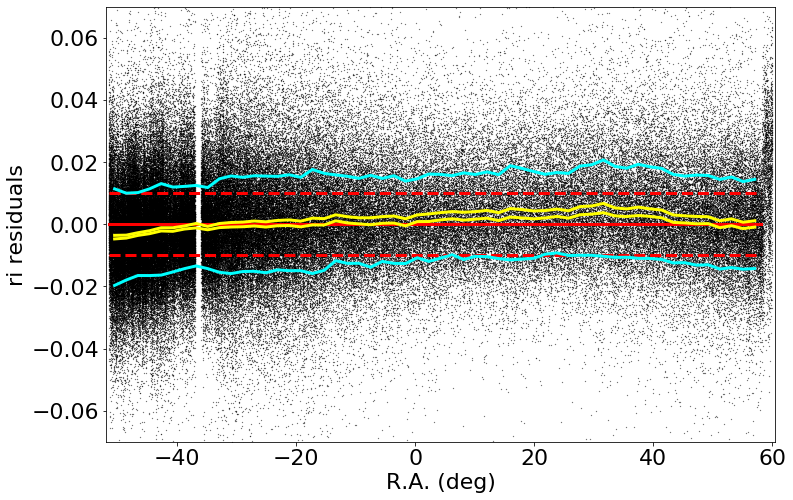

medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: 0.0014694503784172669 std.dev: 0.00214527597437545
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


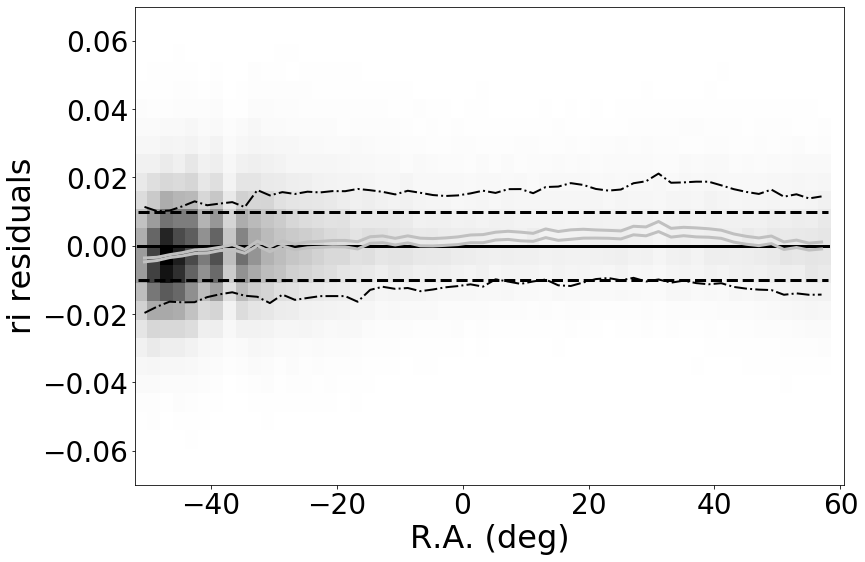

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: -5.860137939427135e-05 std.dev: 0.0005590457816019421
saved plot as: colorResidGaiaColors_ri_Dec.png


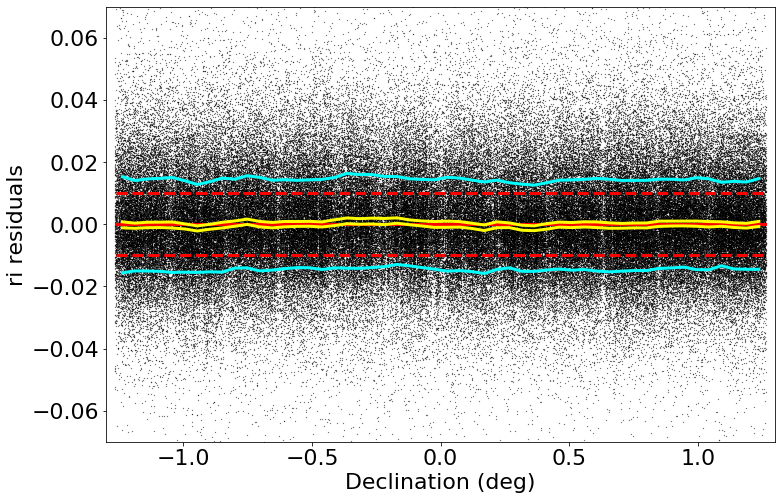

medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: -8.746185302632714e-05 std.dev: 0.0006561271959739887
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


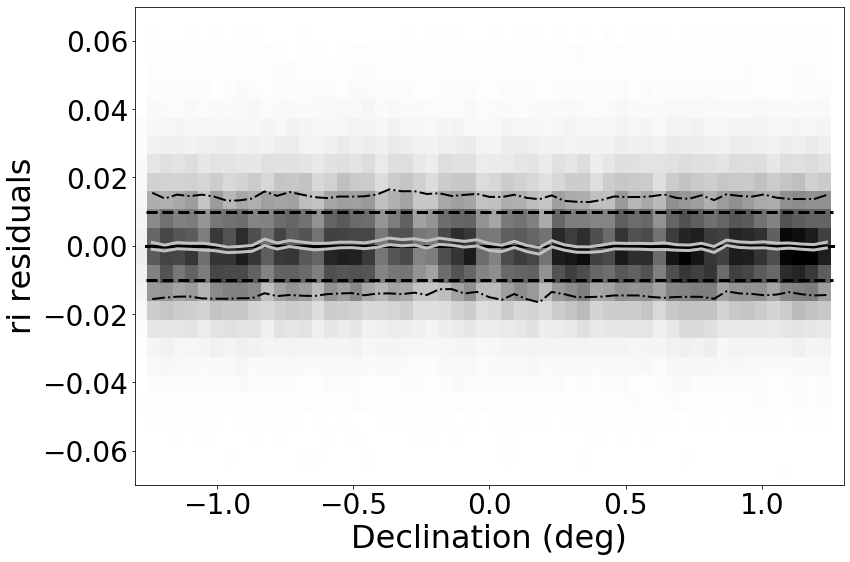

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: 0.0002524238586447264 std.dev: 0.054750489887019686
saved plot as: colorResidGaiaColors_ri_rmag.png


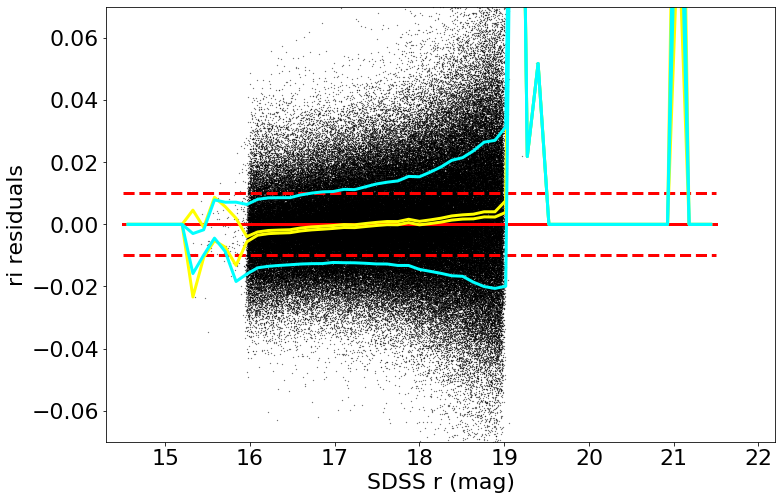

medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: 0.0002524238586447264 std.dev: 0.054750489887019686
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


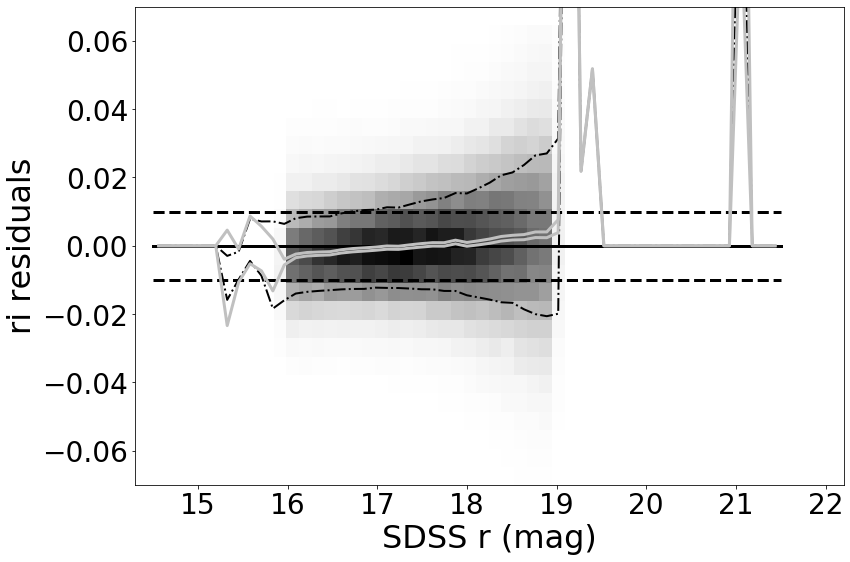

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: -1.5808105468945177e-06 std.dev: 0.0019278773497438107
saved plot as: colorResidGaiaColors_ri_Gmag.png


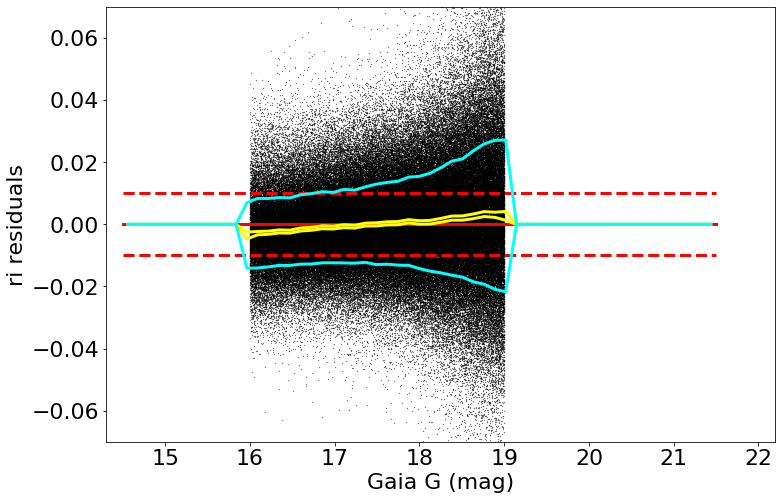

medianAll: -7.122611999485495e-05 std.dev.All: 0.014500596108625797
N= 217826 min= -0.19747155914306996 max= 0.2977743835449219
median: -1.5808105468945177e-06 std.dev: 0.0019278773497438107
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


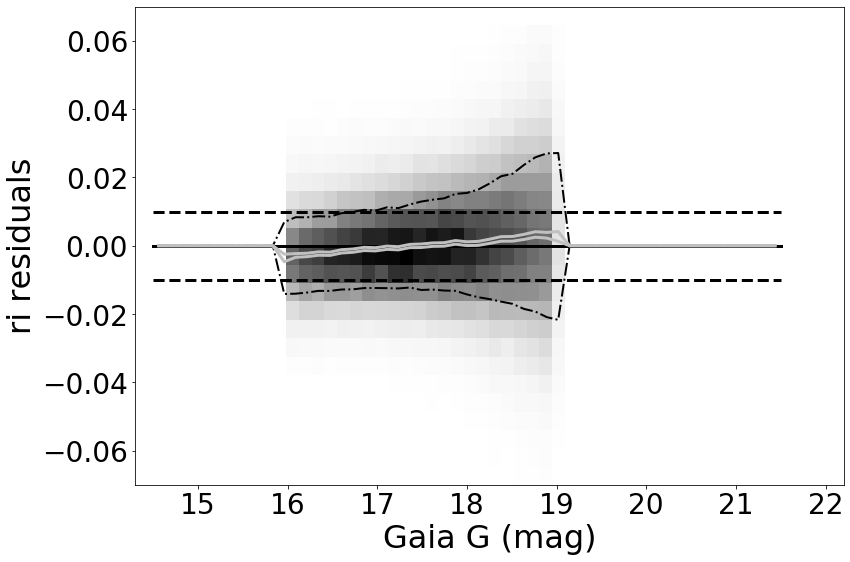

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 0.002719137573241645 std.dev: 0.003143659170498765
saved plot as: colorResidGaiaColors_rz_RA.png


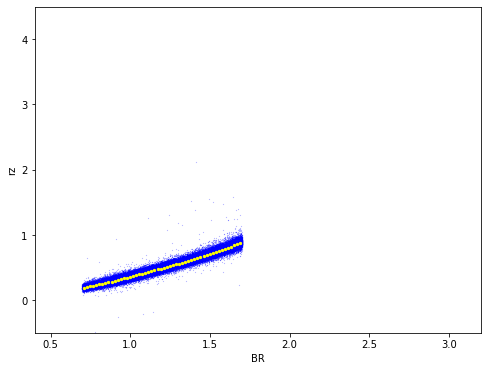

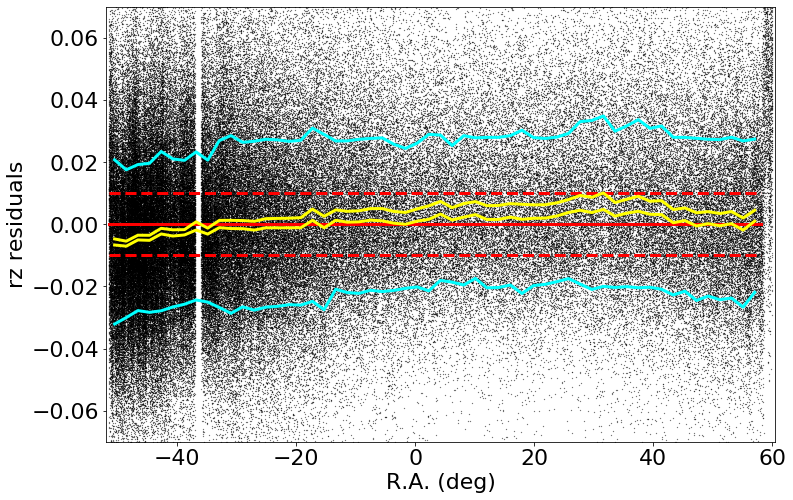

medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 0.002450498962402625 std.dev: 0.003140947374085978
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


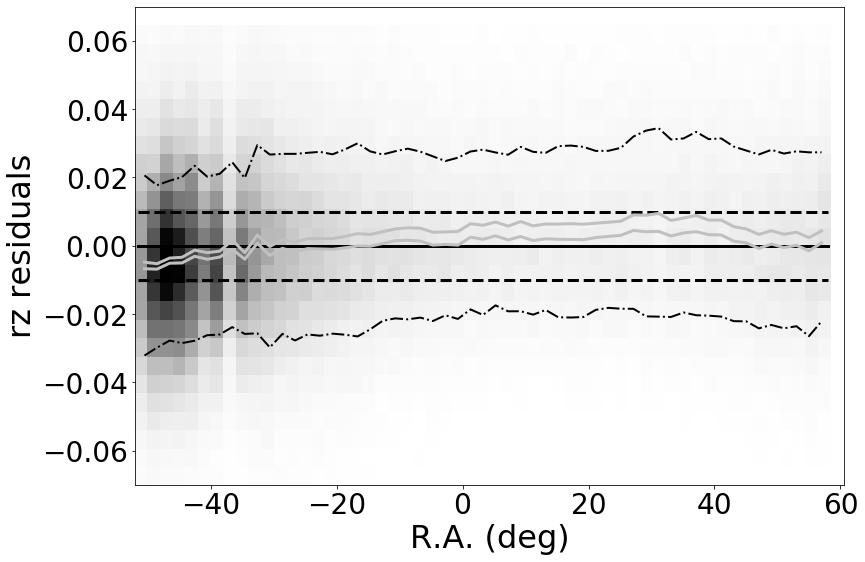

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 3.9087677000337884e-05 std.dev: 0.0014125545206950315
saved plot as: colorResidGaiaColors_rz_Dec.png


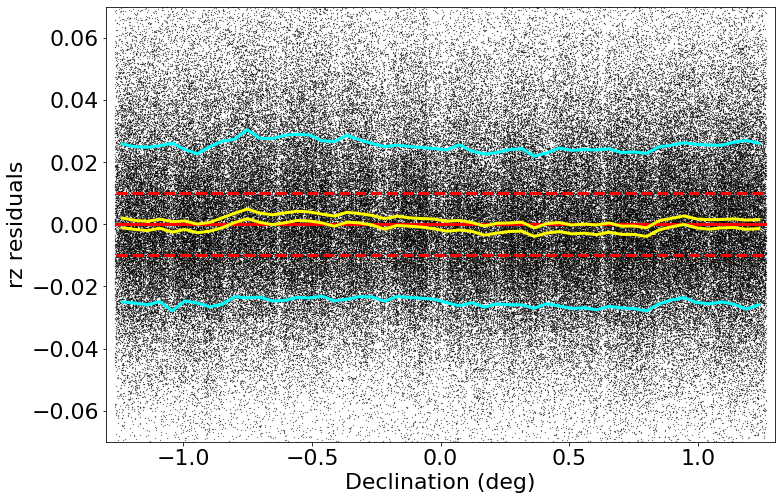

medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 3.552713678800501e-15 std.dev: 0.001498851633992419
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


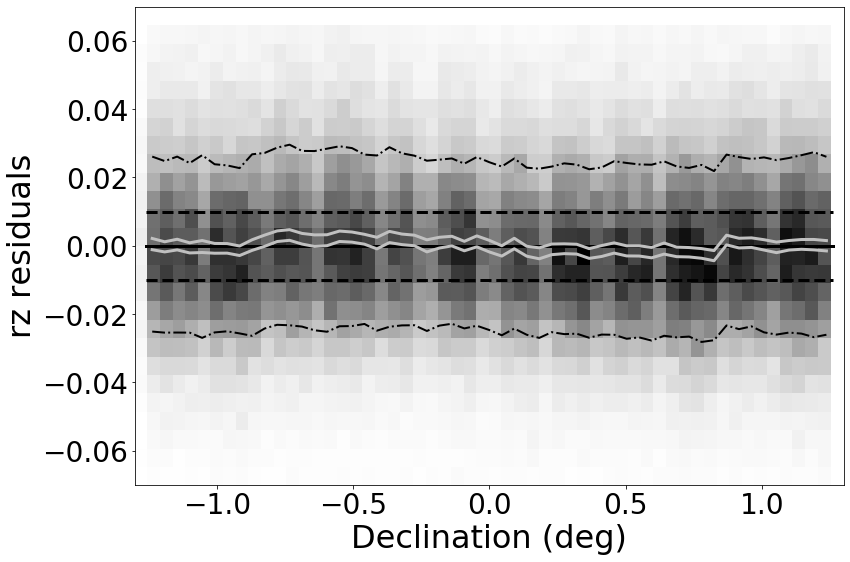

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: -0.00044938354492232713 std.dev: 0.01395401840894461
saved plot as: colorResidGaiaColors_rz_rmag.png


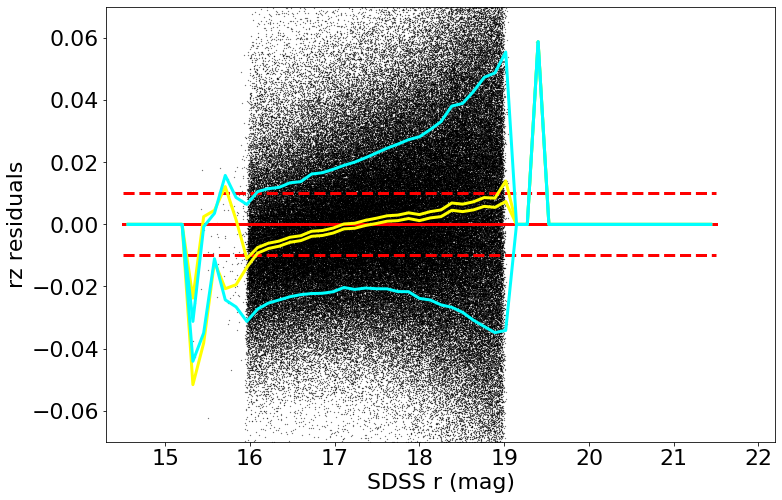

medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: -0.00044938354492232713 std.dev: 0.01395401840894461
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


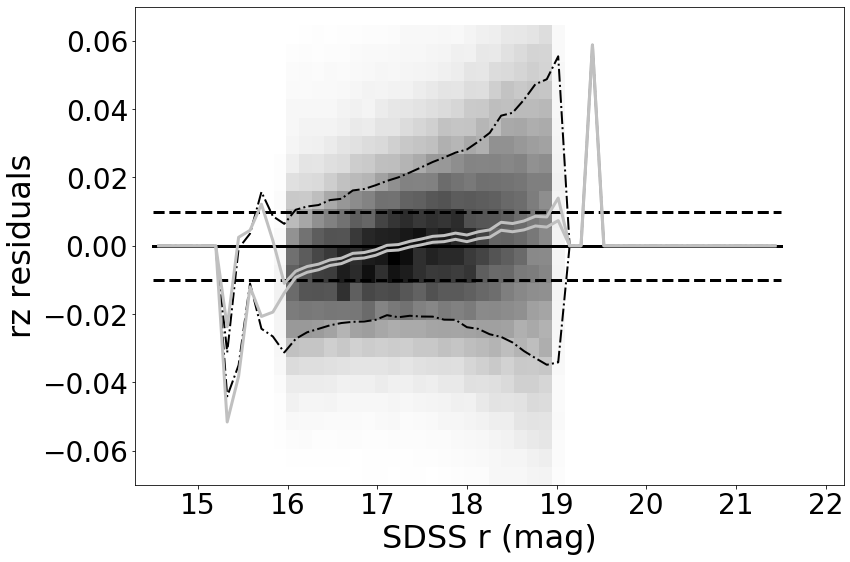

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 0.0010813476562509527 std.dev: 0.0050165167118067025
saved plot as: colorResidGaiaColors_rz_Gmag.png


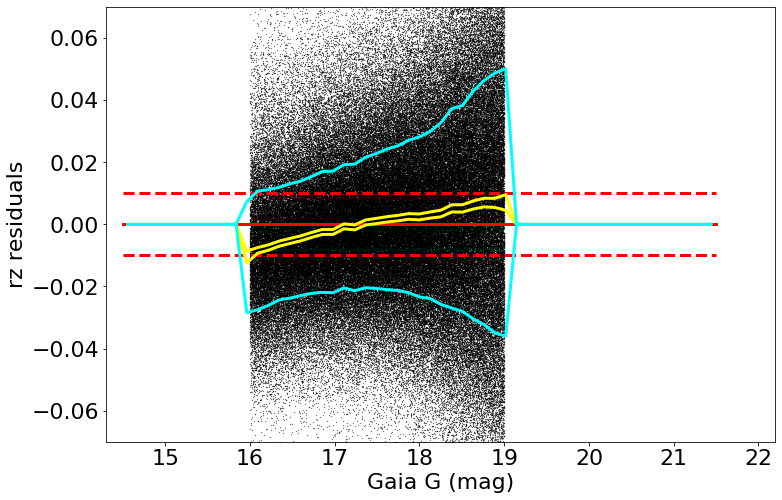

medianAll: 5.3820800779591504e-05 std.dev.All: 0.025318413963317417
N= 217811 min= -0.2511349121093718 max= 0.29930627746582117
median: 0.0010813476562509527 std.dev: 0.0050165167118067025
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


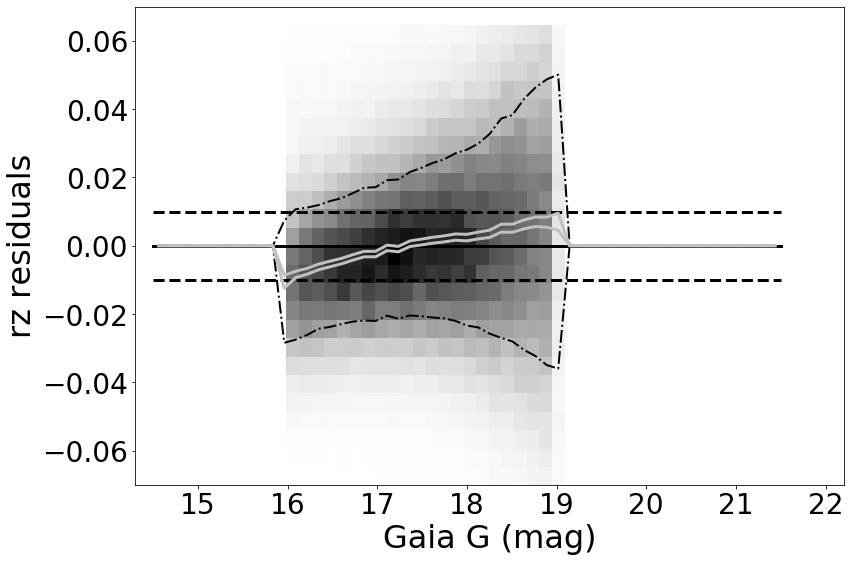

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [73]:
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesRecalib, keywords)

<a id='dataReading'></a>

### Correct v4.3 for offsets in the ugriz bands relative to v2.6

In [74]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [75]:
sdssOut = sdssNew[sdssNew['ra']<1000] 
print(np.size(sdssOut))

991472


In [76]:
## apply offset corrections 
offset = {}
offset['u'] =  0.003 
offset['g'] =  0.017 
offset['r'] =  0.000 
offset['i'] = -0.011 
offset['z'] = -0.018 
for mtype in ('_mMed', '_mMean'):
    for band in ('u', 'g', 'r', 'i', 'z'):
        mstr = band + mtype
        sdssOut[mstr] = sdssOut[mstr] - offset[band]

In [77]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v4.3_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i, aux='')
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v4.3_noheader_final.dat


In [78]:
# execute this in /Data dir
# instead of v4.4, call it v4.2 so that readers don't wonder about v4.2 and v4.3 
# cat header_v4.2.txt stripe82calibStars_v4.3_noheader_final.dat > stripe82calibStars_v4.2.dat
# also
# cat header_v4.1.txt stripe82calibStars_v4.1_noheader_final.dat > stripe82calibStars_v4.1.dat